In [ ]:
!pip3 install torch torchvision numpy matplotlib tqdm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import torch
import torchvision
from torch import nn
import numpy as np
import matplotlib.pyplot as plt
from tqdm import trange, tqdm
from torch.utils.data import Dataset, DataLoader, random_split
import os
import pickle
from PIL import Image
from torchvision import transforms
import torch.nn.functional as F

## io?

In [ ]:
# base_transform = torchvision.transforms.Compose([torchvision.transforms.CenterCrop(112), torchvision.transforms.Normalize(0.5, 0.5)])
base_transform = torchvision.transforms.Compose([torchvision.transforms.CenterCrop(112)]) # come interagisce normalize con la divisione per 255?

class LFWP(torchvision.datasets.LFWPeople):
    def __init__(self, root: str, split: str = "10fold", image_set: str = "deepfunneled", transform = torchvision.transforms.GaussianBlur(9, 4), target_transform = None, download: bool = False,
                 base_transform = base_transform, device = None): # default funneled
        super().__init__(root, split, image_set, transform, target_transform, download)
        self.base_transform = base_transform
        self.device = device


    def __getitem__(self, index: int):
        img       = self.base_transform(torchvision.io.read_image(path = self.data[index]) / 255)
        noisy_img = self.transform(img)

        if self.device is not None:
            img, noisy_img = img.to(self.device), noisy_img.to(self.device)

        return img, noisy_img

    def plot(self, index, figsize = (10, 5)):
        img, noisy_img = self[index]
        img = np.transpose(img.cpu().numpy(), (1, 2, 0))
        noisy_img = np.transpose(noisy_img.cpu().numpy(), (1, 2, 0))

        fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = figsize)

        ax[0].imshow(img)
        ax[1].imshow(noisy_img)

        ax[0].set_title('original')
        ax[1].set_title('transformed')

        return ax

In [ ]:
test_dataset  = LFWP('./lfw_torch/', split = 'test', download = True) # , device = 'cuda'
train_dataset = LFWP('./lfw_torch/', split = 'train', download = True) # , device = 'cuda'

  0%|          | 0/108761145 [00:00<?, ?it/s]

Extracting ./lfw_torch/lfw-py/lfw-deepfunneled.tgz to ./lfw_torch/lfw-py


  0%|          | 0/28334 [00:00<?, ?it/s]

  0%|          | 0/94727 [00:00<?, ?it/s]

Using downloaded and verified file: ./lfw_torch/lfw-py/lfw-deepfunneled.tgz
Extracting ./lfw_torch/lfw-py/lfw-deepfunneled.tgz to ./lfw_torch/lfw-py


  0%|          | 0/66403 [00:00<?, ?it/s]

Using downloaded and verified file: ./lfw_torch/lfw-py/lfw-names.txt


In [ ]:
def create_train_val_dataloaders(tr_dataset, batch_size: int, training_frac = 0.8, num_workers: int = 0, seed: int = 1234):
    n_train = int(len(tr_dataset) * training_frac)
    n_val   = len(tr_dataset) - n_train
    train, val = random_split(tr_dataset, [n_train, n_val], torch.Generator().manual_seed(seed))

    torch.random.manual_seed(seed)
    torch.cuda.random.manual_seed(seed)

    return DataLoader(train, batch_size, shuffle = True, num_workers = num_workers), DataLoader(val, batch_size, shuffle = False, num_workers = num_workers)

### modelli vecchi

In [ ]:
class VAE1(nn.Module): # semplificata, solo relu e adam
    def __init__(self, latent_space_dim: int, initial_lr: float, batch_size: int, dropout: float = None, l1_reg_strength: float = None, l2_reg_strength: float = None,
                loss_fn = nn.MSELoss(reduction = 'sum'), device = 'cuda', alpha = 0.1):
        super().__init__()
        self.latent_space_dim = latent_space_dim
        self.device = device
        self.dropout = dropout
        self.alpha = alpha

        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride = 2, padding = 1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride = 2, padding = 1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride = 2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(), # N, 256, 12, 12 -> 36864
            
            # LIN TUTTI
            nn.Flatten(start_dim = 1)
        )
        
        self.decoder = nn.Sequential(
            # CONV
            # nn.Unflatten(dim = 1, unflattened_size = (64, 1, 1)),
            # nn.ConvTranspose2d(64, 128, kernel_size = 3, stride = 1, padding = 0, output_padding = 0),
            # nn.ReLU(), # N 128 3 3 
            # nn.ConvTranspose2d(128, 256, kernel_size = 8, stride = 2, padding = 0, output_padding = 0),
            # nn.ReLU(), # N 256 12 12
           
            # LIN CORTO
            nn.Linear(self.latent_space_dim, 36864),
            nn.ReLU(),
            # LIN LUNGO
            # nn.Linear(self.latent_space_dim, 100),
            # nn.ReLU(),
            # nn.Linear(100, 36864),
            # nn.ReLU(),

            # LIN TUTTI
            nn.Unflatten(dim = 1, unflattened_size = (256, 12, 12)),

            nn.ConvTranspose2d(256, 256, 4, stride = 2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride = 2, padding = 1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride = 2, padding = 1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )

        self.avg = nn.Sequential( # Predicts the means of a MVN dist.                
            # LIN LUNGO
            # nn.Linear(36864, 100),
            # nn.ReLU(),
            # nn.Dropout(self.dropout) if dropout is not None else nn.Identity(),
            # nn.Linear(100, self.latent_space_dim),
            # LIN CORTO
            nn.Linear(36864, self.latent_space_dim),
            nn.ReLU()

            # CONV (fino alla fine)
            # N 256 12 12
            # nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            # nn.ReLU(), # N 128 3 3
            # nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            # nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            # nn.Flatten(start_dim = 1)
        )

        self.log_var = nn.Sequential( # Predicts the (log) variances of an uncorrelated MVN (i.e. log of cov. matrix diagonal)
            # LIN LUNGO
            # nn.Linear(36864, 100), # 288
            # nn.ReLU(),
            # nn.Dropout(self.dropout) if dropout is not None else nn.Identity(),
            # nn.Linear(100, self.latent_space_dim),
            # LIN CORTO
            nn.Linear(36864, self.latent_space_dim),
            nn.ReLU()

            # CONV (fino alla fine)
            # nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            # nn.ReLU(),
            # nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            # nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            # nn.Flatten(start_dim = 1)
        )

        self.optimizer = torch.optim.Adam(params = self.parameters(), lr = initial_lr)
        
        self.batch_size = batch_size
        self.loss_fn = loss_fn
        self.l1_reg_strength = l1_reg_strength
        self.l2_reg_strength = l2_reg_strength

        if l1_reg_strength is None and l2_reg_strength is None:
            self.reg = lambda: torch.tensor([0], dtype = float, requires_grad = True).to(self.device)
        if l1_reg_strength is not None:
            self.reg = lambda: (sum(((w.abs()).sum() for w in self.parameters()))*self.l1_reg_strength).to(self.device)
        if l2_reg_strength is not None:
            self.reg = lambda: (sum(((w**2).sum() for w in self.parameters()))*self.l2_reg_strength).to(self.device)

    def sample_in_latent_space(self, mu, log_var): # sampling from MVN in latent space with provided mean and variances
        sigma = torch.exp(0.5 * log_var) #log_var is log(variance) = log(sigma**2) = 2 * log(sigma)
        return mu + torch.randn_like(mu) * sigma
        #Var(aX) = a**2 Var(X), so we need to multiply pred_sqrt_var = sigma (square root of the variance) by the standard normal distribution

    def forward(self, x):
        internal_repr  = self.encoder(x) # conv. part --> produces the internal representation
        pred_means     = self.avg(internal_repr) # linear part 1 --> predicts means
        pred_log_var   = self.log_var(internal_repr) # linear part 2 --> predicts variances
        sample         = self.sample_in_latent_space(mu = pred_means, log_var = pred_log_var) # sample in latent space
        decoded_sample = self.decoder(sample) # decoder --> produces final output
        
        return decoded_sample, pred_means, pred_log_var # we need to pass means and vars forward too, since they're needed to compute the KL div. term in the loss

    def train_single_epoch(self, train_dataloader, verbose_single_epoch: bool = True): # function to be iterated inside the fit loop (no cv)
        self.train() # enable dropout etc.
        tr_err_single_epoch = 0
        # SOLO BLURRED O PIXELATED
        loading = tqdm(train_dataloader) if verbose_single_epoch else train_dataloader
        for orig_batch, noisy_batch in loading: # ignore y_batch, we don't need the labels
            output, mu, log_var = self(noisy_batch)
            loss                = self.loss_fn(output, orig_batch) + self.reg() - self.alpha * 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var))
            loss /= len(orig_batch)
            self.optimizer.zero_grad() # reset gradients
            loss.backward() # backpropagation
            self.optimizer.step() # update weights
            tr_err_single_epoch += loss.detach().cpu().numpy() # save current training error
        
        tr_err_single_epoch /= len(train_dataloader) # len of a dataloader = n. of batches
        return tr_err_single_epoch

    @torch.no_grad()
    def val_single_epoch(self, val_dataloader):
        self.eval() # disable dropout etc.
        val_err_single_epoch = 0

        for orig_batch, noisy_batch in val_dataloader: # ignore y_batch, we don't need the labels
            output, mu, log_var   = self(noisy_batch)
            loss                  = nn.MSELoss()(output, orig_batch) # we compare the reconstructed output with the original input
            val_err_single_epoch += loss.detach().cpu().numpy()
        
        val_err_single_epoch /= len(val_dataloader)
        return val_err_single_epoch

    def fit(self, training_dataset, max_n_iter: int = 15, min_n_iter: int = 3, patience: int = 4, tol: float = 0.0001, seed: int = 1234, verbose: bool = True, num_workers: int = 0):
        if seed is not None: # default seed to ensure reproducibility
            torch.random.manual_seed(seed)

        training_dataloader, validation_dataloader = create_train_val_dataloaders(training_dataset, batch_size = self.batch_size, num_workers = num_workers) # dependent on self.batch_size

        self.training_error_history, self.val_error_history = np.zeros(max_n_iter), np.zeros(max_n_iter) # no CV --> no average over dataloaders --> we have a single value to use as an estimate of tr./val. errors
        self.best_val_error = np.Inf
        patience_counter = 0

        loading = range(max_n_iter) # trange(max_n_iter) # if verbose else range(max_n_iter) # useful toggle during training/debugging
        for epoch in loading:
            if verbose:
                print(f'Training epoch = {epoch}') # useful to track training
            tr_err  = self.training_error_history[epoch] = self.train_single_epoch(train_dataloader = training_dataloader)
            val_err = self.val_error_history[epoch] = self.val_single_epoch(val_dataloader = validation_dataloader)
            if verbose:
                print(f'epoch = {epoch}: tr_err = {tr_err}, val_err = {val_err}') # useful to track training
                self.plot_original_vs_reconstructed_sample(*(test_dataset[0])) # quel tipo con la faccia strana
                # così le fa vedere tutte alla fine

            if epoch > min_n_iter:
                if val_err > self.best_val_error + tol:
                    patience_counter += 1
                else:
                    self.best_val_error = val_err
                    patience_counter = 0
                if patience_counter > patience:
                    break
        n_executed_epochs = epoch + 1 # + 1 to go from 0, N-1 (python) to 1, N (human readable) counting scheme 
        if n_executed_epochs < max_n_iter:
            self.best_val_error_epoch = n_executed_epochs - patience_counter
        else:
            self.best_val_error_epoch = max_n_iter - patience_counter

    def save(self, root_path, model_name):
        path = f'{root_path}/{model_name}'
        torch.save(self.state_dict(), path + '.pt')
        np.savetxt(path + '_th.csv', self.training_error_history)
        np.savetxt(path + '_vh.csv', self.val_error_history)

    @torch.no_grad()
    def predict(self, sample):
        self.eval()
        if sample.shape == torch.Size([3, 112, 112]): # a single sample # torch.Size([1, 28, 28]) in origine (-> serve la dim. 0 = N)
            output = self(sample.unsqueeze(0))[0] # the forward pass computes means and variances too, but here we only want the reconstructed samples
        else:
            output = self(sample)[0]
        return output

    def test_accuracy(self, test_dataset):
        v = np.zeros(len(test_dataset))
        for i in range(len(test_dataset)):
            img, noisy_img = test_dataset[i]
            v[i] = float(nn.MSELoss()(self.predict(noisy_img), img))
        return v.mean()

    def plot_original_vs_reconstructed_sample(self, orig_sample, noisy_sample, figsize = (7, 7), return_array: bool = False):
        fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = figsize)
        img_orig = orig_sample.cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_rec = self.predict(noisy_sample).cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_noisy = noisy_sample.cpu().detach().numpy().transpose((1, 2, 0))

        ax[0].imshow(img_orig, cmap = 'gray')
        ax[0].set_title('Orig.')
        ax[0].axis('off')
        ax[1].imshow(img_noisy, cmap = 'gray')
        ax[1].set_title('Noisy')
        ax[1].axis('off')
        ax[2].imshow(img_rec, cmap = 'gray')
        ax[2].set_title('Rec.')
        ax[2].axis('off')

        if return_array:
            return img_rec
        else:
            return fig, ax

    
    def plot_reconstructed_samples(self, dataset, nrows: int = 3, ncols: int = 3, figsize = (42, 21)):
        indices = np.arange(nrows * ncols)
        idx = 0
        ncols = 2*ncols
        fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = figsize)
        
        for i in range(nrows):
            for j in range(0, ncols, 2):
                img = dataset.data[indices[idx]]
                img_rec = self.plot_original_vs_reconstructed_sample(img, return_array = True)
                # img = img.detach().cpu().squeeze(0).numpy()
                img = img.detach().cpu().numpy().transpose((1, 2, 0))
                ax[i,j].imshow(img, cmap = 'gray')
                ax[i,j].set_title('Orig.')
                ax[i,j].axis('off')
                ax[i,j+1].imshow(img_rec, cmap = 'gray')
                ax[i,j+1].set_title('Rec.')
                ax[i,j+1].axis('off')
                idx += 1

        return fig, ax

In [ ]:
test_dataset  = LFWP('./lfw_torch/', split = 'test', download = True, device = 'cuda') # , device = 'cuda'
train_dataset = LFWP('./lfw_torch/', split = 'train', download = True, device = 'cuda') # , device = 'cuda'

Files already downloaded and verified
Files already downloaded and verified


In [ ]:
model1 = VAE1(500, 1e-3, 8).cuda()

Training epoch = 0


100%|██████████| 953/953 [01:12<00:00, 13.12it/s]


epoch = 0: tr_err = [22549.67303606], val_err = 0.030786028615039263
Training epoch = 1


100%|██████████| 953/953 [01:12<00:00, 13.15it/s]


epoch = 1: tr_err = [5.50815131e+10], val_err = 0.027175878155119248
Training epoch = 2


100%|██████████| 953/953 [01:12<00:00, 13.11it/s]


epoch = 2: tr_err = [1120.60156331], val_err = 0.027435246434171827
Training epoch = 3


100%|██████████| 953/953 [01:12<00:00, 13.15it/s]


epoch = 3: tr_err = [1037.87219086], val_err = 0.024404044890441158
Training epoch = 4


100%|██████████| 953/953 [01:12<00:00, 13.13it/s]


epoch = 4: tr_err = [1118.68583738], val_err = 0.02567748357561343
Training epoch = 5


100%|██████████| 953/953 [01:12<00:00, 13.19it/s]


epoch = 5: tr_err = [1002.28362784], val_err = 0.02429463101792535
Training epoch = 6


100%|██████████| 953/953 [01:12<00:00, 13.16it/s]


epoch = 6: tr_err = [995.78065565], val_err = 0.023995953693861243
Training epoch = 7


100%|██████████| 953/953 [01:12<00:00, 13.20it/s]


epoch = 7: tr_err = [965.67821767], val_err = 0.02303701313407351
Training epoch = 8


100%|██████████| 953/953 [01:12<00:00, 13.16it/s]


epoch = 8: tr_err = [966.90406913], val_err = 0.02348075688243785
Training epoch = 9


100%|██████████| 953/953 [01:12<00:00, 13.19it/s]


epoch = 9: tr_err = [958.56861791], val_err = 0.022916677633931695
Training epoch = 10


100%|██████████| 953/953 [01:12<00:00, 13.17it/s]


epoch = 10: tr_err = [957.97256818], val_err = 0.02302471515196512
Training epoch = 11


100%|██████████| 953/953 [01:11<00:00, 13.24it/s]


epoch = 11: tr_err = [1.26205018e+08], val_err = 0.02375319445014748
Training epoch = 12


100%|██████████| 953/953 [01:12<00:00, 13.21it/s]


epoch = 12: tr_err = [950.70416989], val_err = 0.022878817025431777
Training epoch = 13


100%|██████████| 953/953 [01:11<00:00, 13.24it/s]


epoch = 13: tr_err = [939.64089555], val_err = 0.023470425534073778
Training epoch = 14


100%|██████████| 953/953 [01:12<00:00, 13.22it/s]


epoch = 14: tr_err = [939.51268566], val_err = 0.024571458633724116


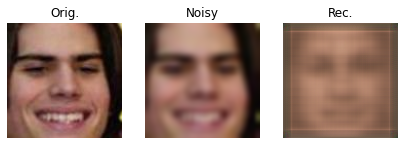

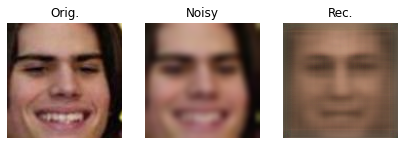

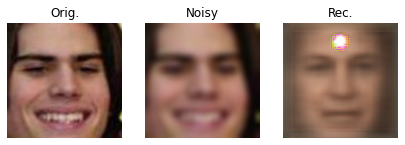

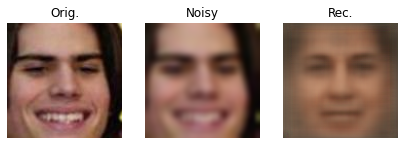

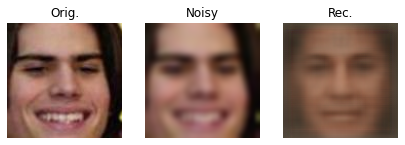

...

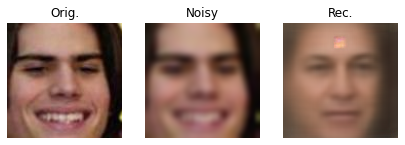

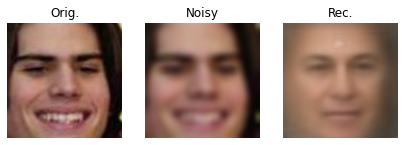

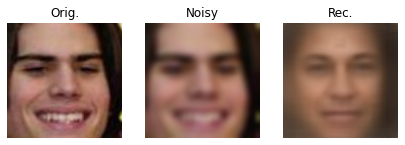

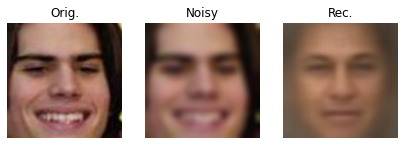

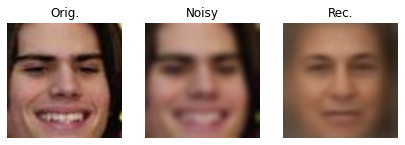

In [ ]:
model1.fit(train_dataset, max_n_iter = 15)

In [ ]:
class VAE2(nn.Module): # semplificata, solo relu e adam
    def __init__(self, latent_space_dim: int, initial_lr: float, batch_size: int, dropout: float = None, l1_reg_strength: float = None, l2_reg_strength: float = None,
                loss_fn = nn.MSELoss(reduction = 'sum'), device = 'cuda', alpha = 0.1):
        super().__init__()
        self.latent_space_dim = latent_space_dim
        self.device = device
        self.dropout = dropout
        self.alpha = alpha

        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride = 2, padding = 1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride = 2, padding = 1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride = 2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(), # N, 256, 12, 12 -> 36864
            
            # LIN TUTTI
            nn.Flatten(start_dim = 1)
        )
        
        self.decoder = nn.Sequential(
            # CONV
            # nn.Unflatten(dim = 1, unflattened_size = (64, 1, 1)),
            # nn.ConvTranspose2d(64, 128, kernel_size = 3, stride = 1, padding = 0, output_padding = 0),
            # nn.ReLU(), # N 128 3 3 
            # nn.ConvTranspose2d(128, 256, kernel_size = 8, stride = 2, padding = 0, output_padding = 0),
            # nn.ReLU(), # N 256 12 12
           
            # LIN CORTO
            # nn.Linear(self.latent_space_dim, 36864),
            # nn.ReLU(),
            # LIN LUNGO
            nn.Linear(self.latent_space_dim, 100),
            nn.ReLU(),
            nn.Linear(100, 36864),
            nn.ReLU(),

            # LIN TUTTI
            nn.Unflatten(dim = 1, unflattened_size = (256, 12, 12)),

            nn.ConvTranspose2d(256, 256, 4, stride = 2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride = 2, padding = 1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride = 2, padding = 1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )

        self.avg = nn.Sequential( # Predicts the means of a MVN dist.                
            # LIN LUNGO
            nn.Linear(36864, 100),
            nn.ReLU(),
            nn.Dropout(self.dropout) if dropout is not None else nn.Identity(),
            nn.Linear(100, self.latent_space_dim),
            # LIN CORTO
            # nn.Linear(36864, self.latent_space_dim),
            # nn.ReLU()

            # CONV (fino alla fine)
            # N 256 12 12
            # nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            # nn.ReLU(), # N 128 3 3
            # nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            # nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            # nn.Flatten(start_dim = 1)
        )

        self.log_var = nn.Sequential( # Predicts the (log) variances of an uncorrelated MVN (i.e. log of cov. matrix diagonal)
            # LIN LUNGO
            nn.Linear(36864, 100), # 288
            nn.ReLU(),
            nn.Dropout(self.dropout) if dropout is not None else nn.Identity(),
            nn.Linear(100, self.latent_space_dim),
            # LIN CORTO
            # nn.Linear(36864, self.latent_space_dim),
            # nn.ReLU()

            # CONV (fino alla fine)
            # nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            # nn.ReLU(),
            # nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            # nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            # nn.Flatten(start_dim = 1)
        )

        self.optimizer = torch.optim.Adam(params = self.parameters(), lr = initial_lr)
        
        self.batch_size = batch_size
        self.loss_fn = loss_fn
        self.l1_reg_strength = l1_reg_strength
        self.l2_reg_strength = l2_reg_strength

        if l1_reg_strength is None and l2_reg_strength is None:
            self.reg = lambda: torch.tensor([0], dtype = float, requires_grad = True).to(self.device)
        if l1_reg_strength is not None:
            self.reg = lambda: (sum(((w.abs()).sum() for w in self.parameters()))*self.l1_reg_strength).to(self.device)
        if l2_reg_strength is not None:
            self.reg = lambda: (sum(((w**2).sum() for w in self.parameters()))*self.l2_reg_strength).to(self.device)

    def sample_in_latent_space(self, mu, log_var): # sampling from MVN in latent space with provided mean and variances
        sigma = torch.exp(0.5 * log_var) #log_var is log(variance) = log(sigma**2) = 2 * log(sigma)
        return mu + torch.randn_like(mu) * sigma
        #Var(aX) = a**2 Var(X), so we need to multiply pred_sqrt_var = sigma (square root of the variance) by the standard normal distribution

    def forward(self, x):
        internal_repr  = self.encoder(x) # conv. part --> produces the internal representation
        pred_means     = self.avg(internal_repr) # linear part 1 --> predicts means
        pred_log_var   = self.log_var(internal_repr) # linear part 2 --> predicts variances
        sample         = self.sample_in_latent_space(mu = pred_means, log_var = pred_log_var) # sample in latent space
        decoded_sample = self.decoder(sample) # decoder --> produces final output
        
        return decoded_sample, pred_means, pred_log_var # we need to pass means and vars forward too, since they're needed to compute the KL div. term in the loss

    def train_single_epoch(self, train_dataloader, verbose_single_epoch: bool = True): # function to be iterated inside the fit loop (no cv)
        self.train() # enable dropout etc.
        tr_err_single_epoch = 0
        # SOLO BLURRED O PIXELATED
        loading = tqdm(train_dataloader) if verbose_single_epoch else train_dataloader
        for orig_batch, noisy_batch in loading: # ignore y_batch, we don't need the labels
            output, mu, log_var = self(noisy_batch)
            loss_mse = self.loss_fn(output, orig_batch) + self.reg()
            loss_reg = - self.alpha * 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var))
            loss = loss_mse + loss_reg

            # print(f'training loss: mse = {loss_mse.float()}, reg_gauss = {loss_reg.float()} (alpha = {self.alpha.float()}), total = {loss.float()}')

            # loss                = self.loss_fn(output, orig_batch) + self.reg() - self.alpha * 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var))
            loss /= len(orig_batch)

            # print(f'scaled training loss: {loss.float()}')

            self.optimizer.zero_grad() # reset gradients
            loss.backward() # backpropagation
            self.optimizer.step() # update weights
            tr_err_single_epoch += loss.detach().cpu().numpy() # save current training error
        
        tr_err_single_epoch /= len(train_dataloader) # len of a dataloader = n. of batches
        return tr_err_single_epoch

    @torch.no_grad()
    def val_single_epoch(self, val_dataloader):
        self.eval() # disable dropout etc.
        val_err_single_epoch = 0

        for orig_batch, noisy_batch in val_dataloader: # ignore y_batch, we don't need the labels
            output, mu, log_var   = self(noisy_batch)
            loss                  = nn.MSELoss()(output, orig_batch) # we compare the reconstructed output with the original input
            val_err_single_epoch += loss.detach().cpu().numpy()
        
        val_err_single_epoch /= len(val_dataloader)
        return val_err_single_epoch

    def fit(self, training_dataset, max_n_iter: int = 15, min_n_iter: int = 3, patience: int = 4, tol: float = 0.0001, seed: int = 1234, verbose: bool = True, num_workers: int = 0):
        if seed is not None: # default seed to ensure reproducibility
            torch.random.manual_seed(seed)

        training_dataloader, validation_dataloader = create_train_val_dataloaders(training_dataset, batch_size = self.batch_size, num_workers = num_workers) # dependent on self.batch_size

        self.training_error_history, self.val_error_history = np.zeros(max_n_iter), np.zeros(max_n_iter) # no CV --> no average over dataloaders --> we have a single value to use as an estimate of tr./val. errors
        self.best_val_error = np.Inf
        patience_counter = 0

        loading = range(max_n_iter) # trange(max_n_iter) # if verbose else range(max_n_iter) # useful toggle during training/debugging
        for epoch in loading:
            if verbose:
                print(f'Training epoch = {epoch}') # useful to track training
            tr_err  = self.training_error_history[epoch] = self.train_single_epoch(train_dataloader = training_dataloader)
            val_err = self.val_error_history[epoch] = self.val_single_epoch(val_dataloader = validation_dataloader)
            if verbose:
                print(f'epoch = {epoch}: tr_err = {tr_err}, val_err = {val_err}') # useful to track training
                self.plot_original_vs_reconstructed_sample(*(test_dataset[0])) # quel tipo con la faccia strana
                # così le fa vedere tutte alla fine
                # plt.tight_layout()
                plt.pause(0.1)
                plt.show()
                plt.close()

            if epoch > min_n_iter:
                if val_err > self.best_val_error + tol:
                    patience_counter += 1
                else:
                    self.best_val_error = val_err
                    patience_counter = 0
                if patience_counter > patience:
                    break
        n_executed_epochs = epoch + 1 # + 1 to go from 0, N-1 (python) to 1, N (human readable) counting scheme 
        if n_executed_epochs < max_n_iter:
            self.best_val_error_epoch = n_executed_epochs - patience_counter
        else:
            self.best_val_error_epoch = max_n_iter - patience_counter

    def save(self, root_path, model_name):
        path = f'{root_path}/{model_name}'
        torch.save(self.state_dict(), path + '.pt')
        np.savetxt(path + '_th.csv', self.training_error_history)
        np.savetxt(path + '_vh.csv', self.val_error_history)

    @torch.no_grad()
    def predict(self, sample):
        self.eval()
        if sample.shape == torch.Size([3, 112, 112]): # a single sample # torch.Size([1, 28, 28]) in origine (-> serve la dim. 0 = N)
            output = self(sample.unsqueeze(0))[0] # the forward pass computes means and variances too, but here we only want the reconstructed samples
        else:
            output = self(sample)[0]
        return output

    def test_accuracy(self, test_dataset):
        v = np.zeros(len(test_dataset))
        for i in range(len(test_dataset)):
            img, noisy_img = test_dataset[i]
            v[i] = float(nn.MSELoss()(self.predict(noisy_img), img))
        return v.mean()

    def plot_original_vs_reconstructed_sample(self, orig_sample, noisy_sample, figsize = (7, 7), return_array: bool = False):
        fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = figsize)
        img_orig = orig_sample.cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_rec = self.predict(noisy_sample).cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_noisy = noisy_sample.cpu().detach().numpy().transpose((1, 2, 0))

        ax[0].imshow(img_orig, cmap = 'gray')
        ax[0].set_title('Orig.')
        ax[0].axis('off')
        ax[1].imshow(img_noisy, cmap = 'gray')
        ax[1].set_title('Noisy')
        ax[1].axis('off')
        ax[2].imshow(img_rec, cmap = 'gray')
        ax[2].set_title('Rec.')
        ax[2].axis('off')

        if return_array:
            return img_rec
        else:
            return fig, ax

    
    def plot_reconstructed_samples(self, dataset, nrows: int = 3, ncols: int = 3, figsize = (42, 21)):
        indices = np.arange(nrows * ncols)
        idx = 0
        ncols = 2*ncols
        fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = figsize)
        
        for i in range(nrows):
            for j in range(0, ncols, 2):
                img = dataset.data[indices[idx]]
                img_rec = self.plot_original_vs_reconstructed_sample(img, return_array = True)
                # img = img.detach().cpu().squeeze(0).numpy()
                img = img.detach().cpu().numpy().transpose((1, 2, 0))
                ax[i,j].imshow(img, cmap = 'gray')
                ax[i,j].set_title('Orig.')
                ax[i,j].axis('off')
                ax[i,j+1].imshow(img_rec, cmap = 'gray')
                ax[i,j+1].set_title('Rec.')
                ax[i,j+1].axis('off')
                idx += 1

        return fig, ax

In [ ]:
model2 = VAE2(latent_space_dim = 250, initial_lr = 1e-3, batch_size = 8, alpha = 0.1).cuda()
# con 100 anziché 1000 e poi dim = 500 parte con una loss di 0.03 e scende a 0.02 stabilmente
# con 1000 (e sempre dim = 500) va a salire! diventa un quadrato di colore e raggiunge 0.04, 0.06 ecc.

Training epoch = 0


100%|██████████| 953/953 [00:53<00:00, 17.91it/s]


epoch = 0: tr_err = [2138.11381918], val_err = 0.026464963627971367


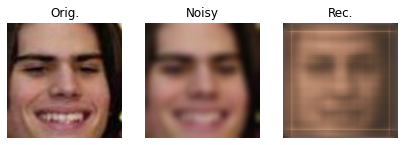

Training epoch = 1


100%|██████████| 953/953 [00:53<00:00, 17.84it/s]


epoch = 1: tr_err = [1067.55117082], val_err = 0.023423783177174785


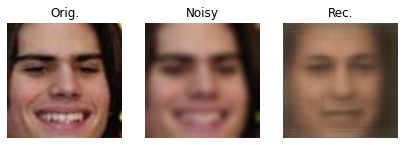

Training epoch = 2


100%|██████████| 953/953 [00:53<00:00, 17.88it/s]


epoch = 2: tr_err = [926.92934398], val_err = 0.022477667233185786


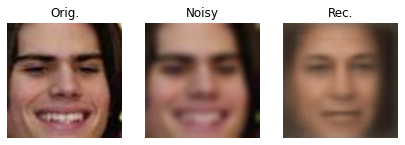

Training epoch = 3


100%|██████████| 953/953 [00:53<00:00, 17.69it/s]


epoch = 3: tr_err = [1206.02598344], val_err = 0.0270833540162282


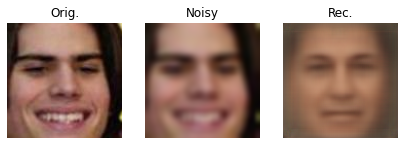

Training epoch = 4


100%|██████████| 953/953 [00:53<00:00, 17.79it/s]


epoch = 4: tr_err = [1026.05855338], val_err = 0.02811140373006276


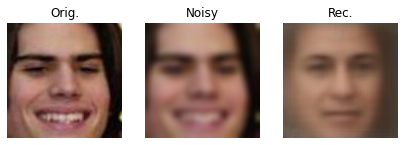

Training epoch = 5


100%|██████████| 953/953 [00:53<00:00, 17.76it/s]


epoch = 5: tr_err = [1020.17657565], val_err = 0.022753471329371798


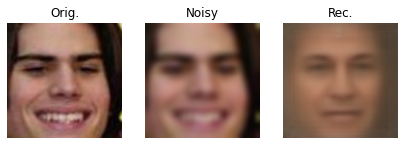

Training epoch = 6


100%|██████████| 953/953 [00:54<00:00, 17.61it/s]


epoch = 6: tr_err = [890.58582293], val_err = 0.022364916322776214


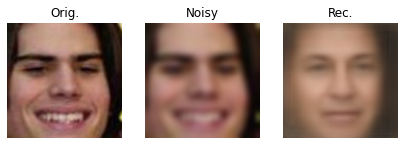

Training epoch = 7


100%|██████████| 953/953 [00:53<00:00, 17.65it/s]


epoch = 7: tr_err = [889.357257], val_err = 0.021762120568633827


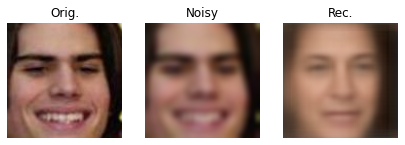

Training epoch = 8


100%|██████████| 953/953 [00:54<00:00, 17.45it/s]


epoch = 8: tr_err = [863.53041587], val_err = 0.021380833498198366


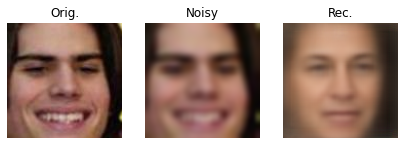

Training epoch = 9


100%|██████████| 953/953 [00:54<00:00, 17.60it/s]


epoch = 9: tr_err = [851.89239814], val_err = 0.021270609788097847


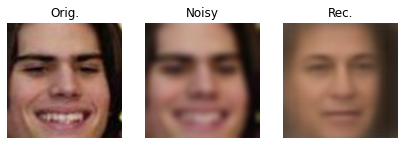

Training epoch = 10


100%|██████████| 953/953 [00:54<00:00, 17.45it/s]


epoch = 10: tr_err = [846.54327672], val_err = 0.02120011698096118


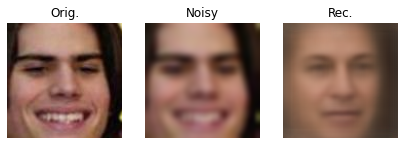

Training epoch = 11


100%|██████████| 953/953 [00:54<00:00, 17.46it/s]


epoch = 11: tr_err = [841.96763212], val_err = 0.021260867639596743


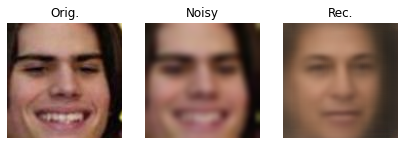

Training epoch = 12


100%|██████████| 953/953 [00:54<00:00, 17.39it/s]


epoch = 12: tr_err = [839.91276281], val_err = 0.022218320736949914


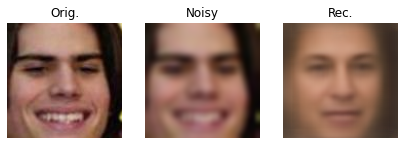

Training epoch = 13


100%|██████████| 953/953 [00:54<00:00, 17.39it/s]


epoch = 13: tr_err = [836.36115708], val_err = 0.02083629190095673


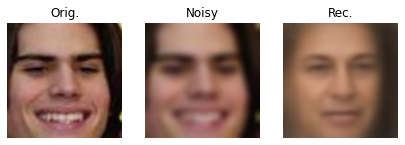

Training epoch = 14


100%|██████████| 953/953 [00:54<00:00, 17.42it/s]


epoch = 14: tr_err = [833.67170672], val_err = 0.021340793450694204


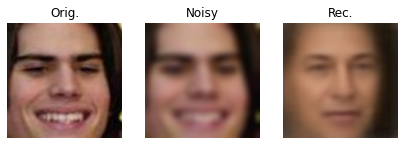

In [ ]:
model2.fit(train_dataset, max_n_iter = 15) # lungo reg 0.1 con 100, non 1000, e dim 250

In [ ]:
model_b = VAE2(latent_space_dim = 250, initial_lr = 1e-3, batch_size = 8, alpha = 1).cuda() # lungo reg 1

Training epoch = 0


100%|██████████| 953/953 [00:55<00:00, 17.26it/s]


epoch = 0: tr_err = [2059.32675576], val_err = 0.03359458263511438


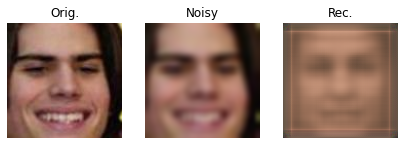

Training epoch = 1


100%|██████████| 953/953 [00:58<00:00, 16.42it/s]


epoch = 1: tr_err = [1262.38282822], val_err = 0.031333016644711276


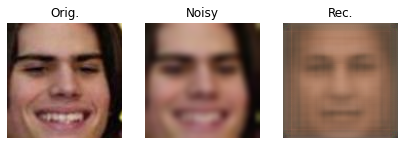

Training epoch = 2


100%|██████████| 953/953 [01:00<00:00, 15.77it/s]


epoch = 2: tr_err = [1253.47215232], val_err = 0.032785190019959186


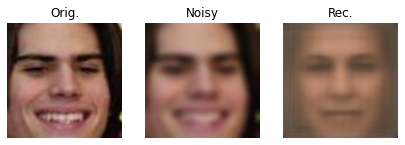

Training epoch = 3


100%|██████████| 953/953 [00:54<00:00, 17.48it/s]


epoch = 3: tr_err = [1216.64668603], val_err = 0.030238847922393466


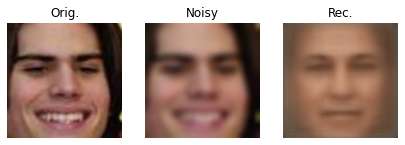

Training epoch = 4


100%|██████████| 953/953 [01:04<00:00, 14.75it/s]


epoch = 4: tr_err = [1267.39927625], val_err = 0.031016742631356585


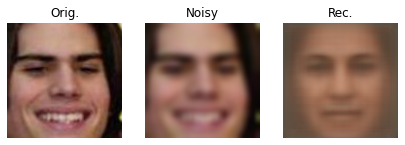

Training epoch = 5


100%|██████████| 953/953 [00:53<00:00, 17.79it/s]


epoch = 5: tr_err = [1186.00651178], val_err = 0.030291924486910947


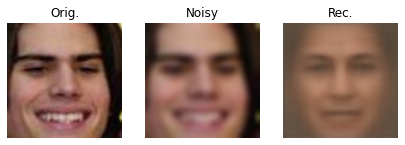

Training epoch = 6


100%|██████████| 953/953 [00:54<00:00, 17.43it/s]


epoch = 6: tr_err = [1178.29024834], val_err = 0.030163535513139668


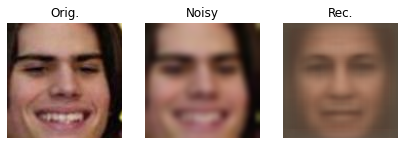

Training epoch = 7


100%|██████████| 953/953 [00:54<00:00, 17.48it/s]


epoch = 7: tr_err = [1164.11729234], val_err = 0.030797570187863447


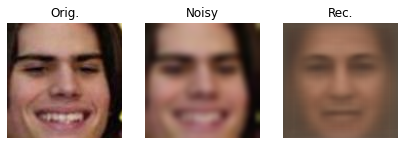

Training epoch = 8


100%|██████████| 953/953 [00:55<00:00, 17.13it/s]


epoch = 8: tr_err = [1163.24078022], val_err = 0.030056295635872306


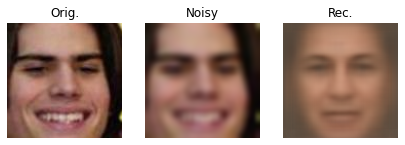

Training epoch = 9


100%|██████████| 953/953 [00:55<00:00, 17.31it/s]


epoch = 9: tr_err = [1154.68862744], val_err = 0.030020838556616376


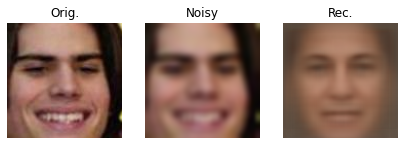

Training epoch = 10


100%|██████████| 953/953 [00:55<00:00, 17.15it/s]


epoch = 10: tr_err = [1366.65935381], val_err = 0.030040649089292003


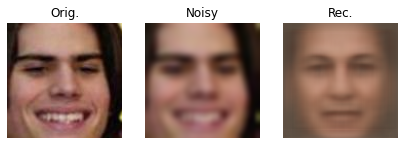

Training epoch = 11


100%|██████████| 953/953 [00:54<00:00, 17.38it/s]


epoch = 11: tr_err = [1156.11177346], val_err = 0.029607944603557368


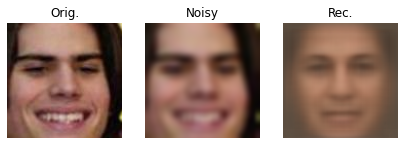

Training epoch = 12


100%|██████████| 953/953 [00:54<00:00, 17.39it/s]


epoch = 12: tr_err = [1279.50285584], val_err = 0.030788409870476402


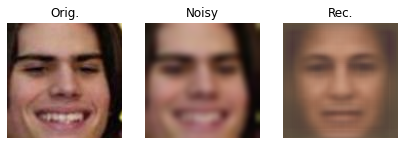

Training epoch = 13


100%|██████████| 953/953 [00:54<00:00, 17.35it/s]


epoch = 13: tr_err = [1168.12420167], val_err = 0.02965676573311684


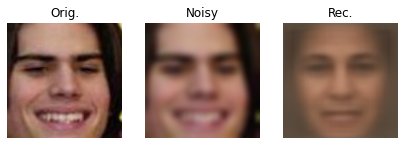

Training epoch = 14


100%|██████████| 953/953 [00:54<00:00, 17.41it/s]


epoch = 14: tr_err = [1154.77484661], val_err = 0.030068147530054448


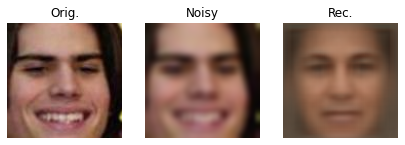

In [ ]:
model_b.fit(train_dataset, max_n_iter = 15)

In [ ]:
class VAE_C(nn.Module): # semplificata, solo relu e adam
    def __init__(self, latent_space_dim: int, initial_lr: float, batch_size: int, dropout: float = None, l1_reg_strength: float = None, l2_reg_strength: float = None,
                loss_fn = nn.MSELoss(reduction = 'sum'), device = 'cuda', alpha = 0.1):
        super().__init__()
        self.latent_space_dim = latent_space_dim
        self.device = device
        self.dropout = dropout
        self.alpha = alpha

        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride = 2, padding = 1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride = 2, padding = 1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride = 2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(), # N, 256, 12, 12 -> 36864
            
            # LIN TUTTI
            # nn.Flatten(start_dim = 1)
        )
        
        self.decoder = nn.Sequential(
            # CONV
            nn.Unflatten(dim = 1, unflattened_size = (64, 1, 1)),
            nn.ConvTranspose2d(64, 128, kernel_size = 3, stride = 1, padding = 0, output_padding = 0),
            nn.ReLU(), # N 128 3 3 
            nn.ConvTranspose2d(128, 256, kernel_size = 8, stride = 2, padding = 0, output_padding = 0),
            nn.ReLU(), # N 256 12 12
           
            # LIN CORTO
            # nn.Linear(self.latent_space_dim, 36864),
            # nn.ReLU(),
            # LIN LUNGO
            # nn.Linear(self.latent_space_dim, 100),
            # nn.ReLU(),
            # nn.Linear(100, 36864),
            # nn.ReLU(),

            # LIN TUTTI
            # nn.Unflatten(dim = 1, unflattened_size = (256, 12, 12)),

            nn.ConvTranspose2d(256, 256, 4, stride = 2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride = 2, padding = 1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride = 2, padding = 1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )

        self.avg = nn.Sequential( # Predicts the means of a MVN dist.                
            # LIN LUNGO
            # nn.Linear(36864, 100),
            # nn.ReLU(),
            # nn.Dropout(self.dropout) if dropout is not None else nn.Identity(),
            # nn.Linear(100, self.latent_space_dim),
            # LIN CORTO
            # nn.Linear(36864, self.latent_space_dim),
            # nn.ReLU()

            # CONV (fino alla fine)
            # N 256 12 12
            nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            nn.ReLU(), # N 128 3 3
            nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            nn.Flatten(start_dim = 1)
        )

        self.log_var = nn.Sequential( # Predicts the (log) variances of an uncorrelated MVN (i.e. log of cov. matrix diagonal)
            # LIN LUNGO
            # nn.Linear(36864, 100), # 288
            # nn.ReLU(),
            # nn.Dropout(self.dropout) if dropout is not None else nn.Identity(),
            # nn.Linear(100, self.latent_space_dim),
            # LIN CORTO
            # nn.Linear(36864, self.latent_space_dim),
            # nn.ReLU()

            # CONV (fino alla fine)
            nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            nn.ReLU(),
            nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            nn.Flatten(start_dim = 1)
        )

        self.optimizer = torch.optim.Adam(params = self.parameters(), lr = initial_lr)
        
        self.batch_size = batch_size
        self.loss_fn = loss_fn
        self.l1_reg_strength = l1_reg_strength
        self.l2_reg_strength = l2_reg_strength

        if l1_reg_strength is None and l2_reg_strength is None:
            self.reg = lambda: torch.tensor([0], dtype = float, requires_grad = True).to(self.device)
        if l1_reg_strength is not None:
            self.reg = lambda: (sum(((w.abs()).sum() for w in self.parameters()))*self.l1_reg_strength).to(self.device)
        if l2_reg_strength is not None:
            self.reg = lambda: (sum(((w**2).sum() for w in self.parameters()))*self.l2_reg_strength).to(self.device)

    def sample_in_latent_space(self, mu, log_var): # sampling from MVN in latent space with provided mean and variances
        sigma = torch.exp(0.5 * log_var) #log_var is log(variance) = log(sigma**2) = 2 * log(sigma)
        return mu + torch.randn_like(mu) * sigma
        #Var(aX) = a**2 Var(X), so we need to multiply pred_sqrt_var = sigma (square root of the variance) by the standard normal distribution

    def forward(self, x):
        internal_repr  = self.encoder(x) # conv. part --> produces the internal representation
        pred_means     = self.avg(internal_repr) # linear part 1 --> predicts means
        pred_log_var   = self.log_var(internal_repr) # linear part 2 --> predicts variances
        sample         = self.sample_in_latent_space(mu = pred_means, log_var = pred_log_var) # sample in latent space
        decoded_sample = self.decoder(sample) # decoder --> produces final output
        
        return decoded_sample, pred_means, pred_log_var # we need to pass means and vars forward too, since they're needed to compute the KL div. term in the loss

    def train_single_epoch(self, train_dataloader, verbose_single_epoch: bool = True): # function to be iterated inside the fit loop (no cv)
        self.train() # enable dropout etc.
        tr_err_single_epoch = 0
        # SOLO BLURRED O PIXELATED
        loading = tqdm(train_dataloader) if verbose_single_epoch else train_dataloader
        for orig_batch, noisy_batch in loading: # ignore y_batch, we don't need the labels
            output, mu, log_var = self(noisy_batch)
            loss_mse = self.loss_fn(output, orig_batch) + self.reg()
            loss_reg = - self.alpha * 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var))
            loss = loss_mse + loss_reg

            # print(f'training loss: mse = {loss_mse.float()}, reg_gauss = {loss_reg.float()} (alpha = {self.alpha.float()}), total = {loss.float()}')

            # loss                = self.loss_fn(output, orig_batch) + self.reg() - self.alpha * 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var))
            loss /= len(orig_batch)

            # print(f'scaled training loss: {loss.float()}')

            self.optimizer.zero_grad() # reset gradients
            loss.backward() # backpropagation
            self.optimizer.step() # update weights
            tr_err_single_epoch += loss.detach().cpu().numpy() # save current training error
        
        tr_err_single_epoch /= len(train_dataloader) # len of a dataloader = n. of batches
        return tr_err_single_epoch

    @torch.no_grad()
    def val_single_epoch(self, val_dataloader):
        self.eval() # disable dropout etc.
        val_err_single_epoch = 0

        for orig_batch, noisy_batch in val_dataloader: # ignore y_batch, we don't need the labels
            output, mu, log_var   = self(noisy_batch)
            loss                  = nn.MSELoss()(output, orig_batch) # we compare the reconstructed output with the original input
            val_err_single_epoch += loss.detach().cpu().numpy()
        
        val_err_single_epoch /= len(val_dataloader)
        return val_err_single_epoch

    def fit(self, training_dataset, max_n_iter: int = 15, min_n_iter: int = 3, patience: int = 4, tol: float = 0.0001, seed: int = 1234, verbose: bool = True, num_workers: int = 0):
        if seed is not None: # default seed to ensure reproducibility
            torch.random.manual_seed(seed)

        training_dataloader, validation_dataloader = create_train_val_dataloaders(training_dataset, batch_size = self.batch_size, num_workers = num_workers) # dependent on self.batch_size

        self.training_error_history, self.val_error_history = np.zeros(max_n_iter), np.zeros(max_n_iter) # no CV --> no average over dataloaders --> we have a single value to use as an estimate of tr./val. errors
        self.best_val_error = np.Inf
        patience_counter = 0

        loading = range(max_n_iter) # trange(max_n_iter) # if verbose else range(max_n_iter) # useful toggle during training/debugging
        for epoch in loading:
            if verbose:
                print(f'Training epoch = {epoch}') # useful to track training
            tr_err  = self.training_error_history[epoch] = self.train_single_epoch(train_dataloader = training_dataloader)
            val_err = self.val_error_history[epoch] = self.val_single_epoch(val_dataloader = validation_dataloader)
            if verbose:
                print(f'epoch = {epoch}: tr_err = {tr_err}, val_err = {val_err}') # useful to track training
                self.plot_original_vs_reconstructed_sample(*(test_dataset[0])) # quel tipo con la faccia strana
                # così le fa vedere tutte alla fine
                # plt.tight_layout()
                plt.pause(0.1)
                plt.show()
                plt.close()

            if epoch > min_n_iter:
                if val_err > self.best_val_error + tol:
                    patience_counter += 1
                else:
                    self.best_val_error = val_err
                    patience_counter = 0
                if patience_counter > patience:
                    break
        n_executed_epochs = epoch + 1 # + 1 to go from 0, N-1 (python) to 1, N (human readable) counting scheme 
        if n_executed_epochs < max_n_iter:
            self.best_val_error_epoch = n_executed_epochs - patience_counter
        else:
            self.best_val_error_epoch = max_n_iter - patience_counter

    def save(self, root_path, model_name):
        path = f'{root_path}/{model_name}'
        torch.save(self.state_dict(), path + '.pt')
        np.savetxt(path + '_th.csv', self.training_error_history)
        np.savetxt(path + '_vh.csv', self.val_error_history)

    @torch.no_grad()
    def predict(self, sample):
        self.eval()
        if sample.shape == torch.Size([3, 112, 112]): # a single sample # torch.Size([1, 28, 28]) in origine (-> serve la dim. 0 = N)
            output = self(sample.unsqueeze(0))[0] # the forward pass computes means and variances too, but here we only want the reconstructed samples
        else:
            output = self(sample)[0]
        return output

    def test_accuracy(self, test_dataset):
        v = np.zeros(len(test_dataset))
        for i in range(len(test_dataset)):
            img, noisy_img = test_dataset[i]
            v[i] = float(nn.MSELoss()(self.predict(noisy_img), img))
        return v.mean()

    def plot_original_vs_reconstructed_sample(self, orig_sample, noisy_sample, figsize = (7, 7), return_array: bool = False):
        fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = figsize)
        img_orig = orig_sample.cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_rec = self.predict(noisy_sample).cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_noisy = noisy_sample.cpu().detach().numpy().transpose((1, 2, 0))

        ax[0].imshow(img_orig, cmap = 'gray')
        ax[0].set_title('Orig.')
        ax[0].axis('off')
        ax[1].imshow(img_noisy, cmap = 'gray')
        ax[1].set_title('Noisy')
        ax[1].axis('off')
        ax[2].imshow(img_rec, cmap = 'gray')
        ax[2].set_title('Rec.')
        ax[2].axis('off')

        if return_array:
            return img_rec
        else:
            return fig, ax

    
    def plot_reconstructed_samples(self, dataset, nrows: int = 3, ncols: int = 3, figsize = (42, 21)):
        indices = np.arange(nrows * ncols)
        idx = 0
        ncols = 2*ncols
        fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = figsize)
        
        for i in range(nrows):
            for j in range(0, ncols, 2):
                img = dataset.data[indices[idx]]
                img_rec = self.plot_original_vs_reconstructed_sample(img, return_array = True)
                # img = img.detach().cpu().squeeze(0).numpy()
                img = img.detach().cpu().numpy().transpose((1, 2, 0))
                ax[i,j].imshow(img, cmap = 'gray')
                ax[i,j].set_title('Orig.')
                ax[i,j].axis('off')
                ax[i,j+1].imshow(img_rec, cmap = 'gray')
                ax[i,j+1].set_title('Rec.')
                ax[i,j+1].axis('off')
                idx += 1

        return fig, ax

In [ ]:
model_c = VAE_C(250, 1e-3, 8, alpha = 0.1).cuda() # qua dim = 250 è fake, in realtà siamo col 64

Training epoch = 0


100%|██████████| 953/953 [00:58<00:00, 16.38it/s]


epoch = 0: tr_err = [41515.830933], val_err = 0.026093884414085285


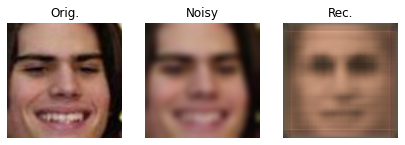

Training epoch = 1


100%|██████████| 953/953 [00:58<00:00, 16.39it/s]


epoch = 1: tr_err = [941.43840776], val_err = 0.021461792056405894


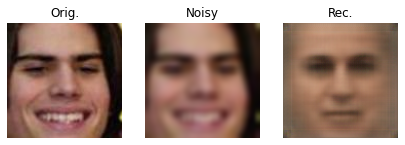

Training epoch = 2


100%|██████████| 953/953 [00:58<00:00, 16.29it/s]


epoch = 2: tr_err = [872.19850818], val_err = 0.020237961912597822


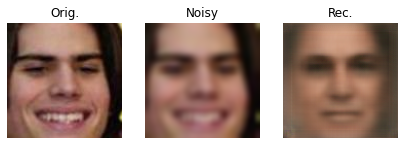

Training epoch = 3


100%|██████████| 953/953 [00:58<00:00, 16.35it/s]


epoch = 3: tr_err = [779.66102111], val_err = 0.017974496830769165


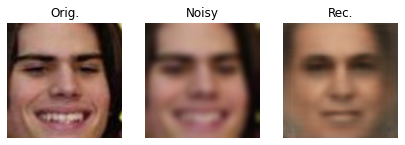

Training epoch = 4


100%|██████████| 953/953 [01:04<00:00, 14.74it/s]


epoch = 4: tr_err = [724.53804575], val_err = 0.016746640708063688


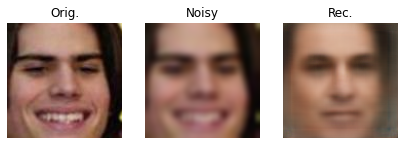

Training epoch = 5


100%|██████████| 953/953 [00:58<00:00, 16.24it/s]


epoch = 5: tr_err = [693.58974573], val_err = 0.01639454835581605


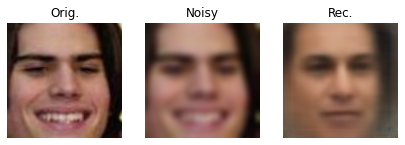

Training epoch = 6


100%|██████████| 953/953 [00:59<00:00, 16.01it/s]


epoch = 6: tr_err = [673.16034814], val_err = 0.016127999618680656


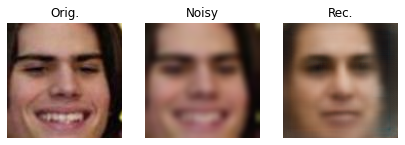

Training epoch = 7


100%|██████████| 953/953 [00:58<00:00, 16.19it/s]


epoch = 7: tr_err = [649.20678198], val_err = 0.015119711428132517


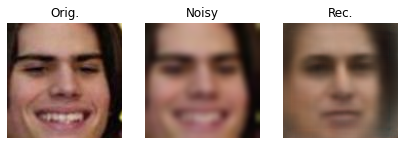

Training epoch = 8


100%|██████████| 953/953 [00:59<00:00, 16.02it/s]


epoch = 8: tr_err = [701.67351096], val_err = 0.015989706941167182


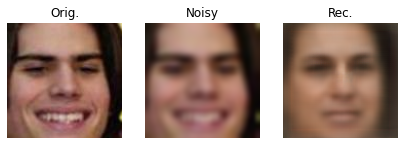

Training epoch = 9


100%|██████████| 953/953 [00:59<00:00, 16.15it/s]


epoch = 9: tr_err = [623.77803464], val_err = 0.014795459810815845


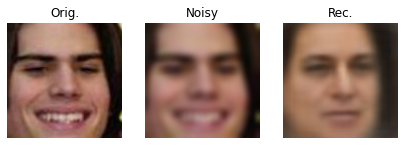

Training epoch = 10


100%|██████████| 953/953 [00:59<00:00, 15.99it/s]


epoch = 10: tr_err = [606.26730612], val_err = 0.014467068920574427


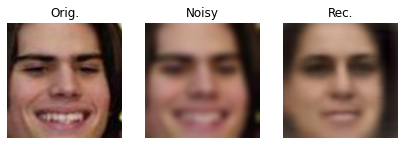

Training epoch = 11


100%|██████████| 953/953 [00:59<00:00, 16.09it/s]


epoch = 11: tr_err = [618.22245152], val_err = 0.014180126841565804


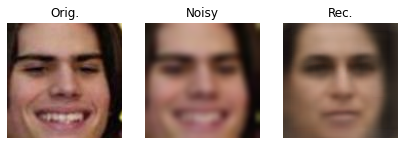

Training epoch = 12


100%|██████████| 953/953 [00:59<00:00, 15.97it/s]


epoch = 12: tr_err = [587.30970855], val_err = 0.013775689691055769


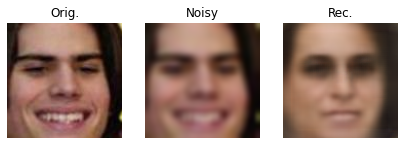

Training epoch = 13


100%|██████████| 953/953 [00:59<00:00, 16.03it/s]


epoch = 13: tr_err = [573.16854782], val_err = 0.014305117056864824


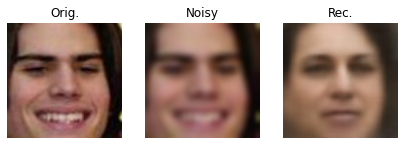

Training epoch = 14


100%|██████████| 953/953 [01:00<00:00, 15.81it/s]


epoch = 14: tr_err = [564.86285265], val_err = 0.014266785830415194


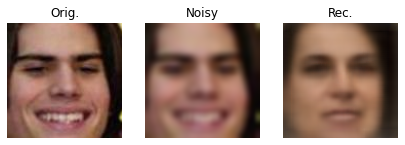

In [ ]:
model_c.fit(train_dataset, max_n_iter = 15)

In [ ]:
!mkdir model_c

In [ ]:
model_c.save('./model_c/', 'model_c')

In [ ]:
!zip -r model_c.zip model_c

  adding: model_c/ (stored 0%)
  adding: model_c/model_c_vh.csv (deflated 53%)
  adding: model_c/model_c.pt (deflated 7%)
  adding: model_c/model_c_th.csv (deflated 52%)


Training epoch = 0


100%|██████████| 953/953 [00:59<00:00, 16.00it/s]


epoch = 0: tr_err = [560.0185324], val_err = 0.013678625549450828


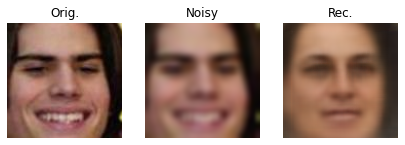

Training epoch = 1


100%|██████████| 953/953 [00:59<00:00, 16.06it/s]


epoch = 1: tr_err = [548.69343834], val_err = 0.013041079539228933


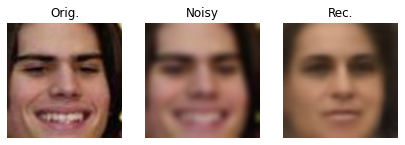

Training epoch = 2


100%|██████████| 953/953 [00:58<00:00, 16.43it/s]


epoch = 2: tr_err = [539.22850468], val_err = 0.012740367489660384


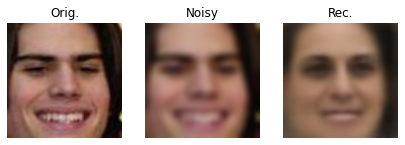

Training epoch = 3


100%|██████████| 953/953 [00:58<00:00, 16.23it/s]


epoch = 3: tr_err = [531.42966501], val_err = 0.01268498922569607


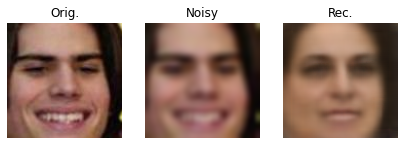

Training epoch = 4


100%|██████████| 953/953 [00:58<00:00, 16.38it/s]


epoch = 4: tr_err = [526.12385211], val_err = 0.012303186810446834


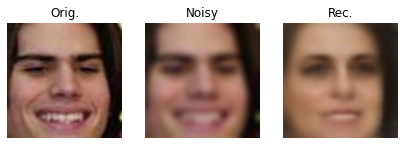

Training epoch = 5


100%|██████████| 953/953 [00:58<00:00, 16.20it/s]


epoch = 5: tr_err = [519.85091996], val_err = 0.012627793398050584


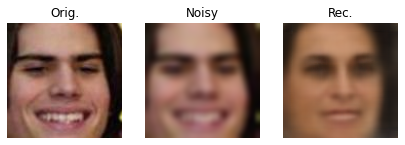

Training epoch = 6


100%|██████████| 953/953 [00:58<00:00, 16.31it/s]


epoch = 6: tr_err = [520.37178375], val_err = 0.013020688457469062


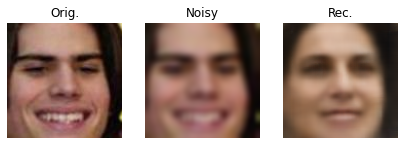

Training epoch = 7


100%|██████████| 953/953 [00:58<00:00, 16.16it/s]


epoch = 7: tr_err = [508.44263563], val_err = 0.012352467876972015


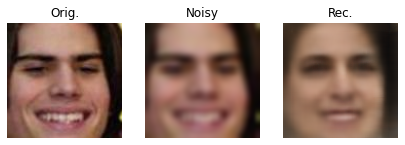

Training epoch = 8


100%|██████████| 953/953 [00:58<00:00, 16.27it/s]


epoch = 8: tr_err = [508.42007177], val_err = 0.012010296007859906


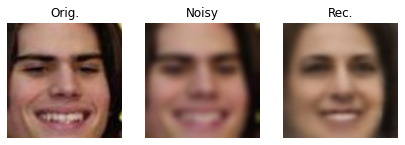

Training epoch = 9


100%|██████████| 953/953 [00:59<00:00, 16.12it/s]


epoch = 9: tr_err = [497.98900161], val_err = 0.012437018900953825


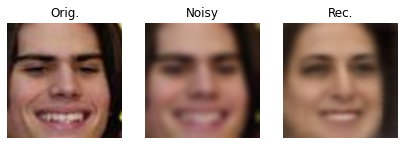

Training epoch = 10


100%|██████████| 953/953 [00:58<00:00, 16.20it/s]


epoch = 10: tr_err = [494.64909587], val_err = 0.013151321712117563


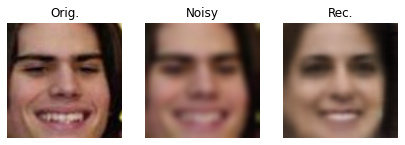

Training epoch = 11


100%|██████████| 953/953 [00:59<00:00, 16.06it/s]


epoch = 11: tr_err = [490.32570528], val_err = 0.012252680513088175


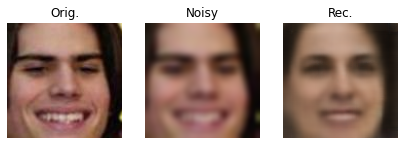

Training epoch = 12


100%|██████████| 953/953 [00:58<00:00, 16.18it/s]


epoch = 12: tr_err = [489.3923891], val_err = 0.012597473977312881


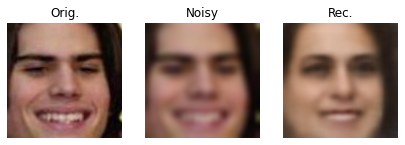

Training epoch = 13


100%|██████████| 953/953 [00:59<00:00, 16.03it/s]


epoch = 13: tr_err = [483.44656622], val_err = 0.012332448529305567


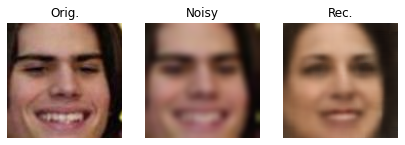

In [ ]:
model_c.fit(train_dataset, 15) # bis per arrivare a 30? vediamo come va

In [ ]:
!mkdir model_c2

In [ ]:
model_c.save('./model_c2/', 'model_c2')

In [ ]:
!zip -r model_c2.zip model_c2

  adding: model_c2/ (stored 0%)
  adding: model_c2/model_c2_th.csv (deflated 53%)
  adding: model_c2/model_c2.pt (deflated 7%)
  adding: model_c2/model_c2_vh.csv (deflated 54%)


In [ ]:
model_nc = VAE_C(250, 1e-3, 8, alpha = 0).cuda() # no reg!

In [ ]:
# model_nc.fit(train_dataset, 15) # errore nan sia train che val con alpha = 0, foto tutta nera

In [ ]:
model_c_l2 = VAE_C(250, 1e-3, 8, alpha = 0.1, l2_reg_strength = 1e-5).cuda()

Training epoch = 0


100%|██████████| 953/953 [01:00<00:00, 15.84it/s]


epoch = 0: tr_err = 1640.5401417270912, val_err = 0.02695787641137963


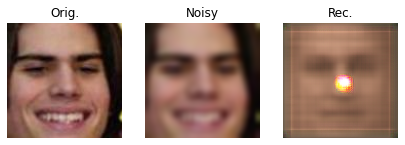

Training epoch = 1


100%|██████████| 953/953 [00:59<00:00, 15.99it/s]


epoch = 1: tr_err = 980.9250961575904, val_err = 0.0233038084339896


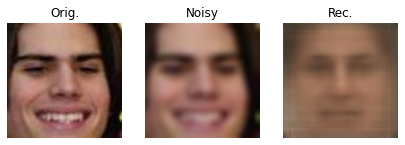

Training epoch = 2


100%|██████████| 953/953 [01:00<00:00, 15.85it/s]


epoch = 2: tr_err = 845.1353597731055, val_err = 0.020971775210801527


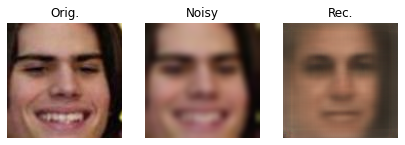

Training epoch = 3


100%|██████████| 953/953 [00:59<00:00, 15.91it/s]


epoch = 3: tr_err = 742.1163340645597, val_err = 0.018798747127213238


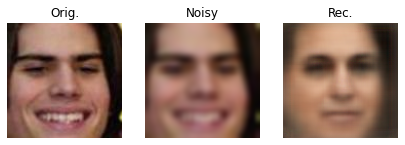

Training epoch = 4


100%|██████████| 953/953 [01:00<00:00, 15.76it/s]


epoch = 4: tr_err = 691.8455572618643, val_err = 0.016944934590622223


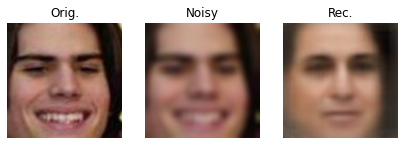

Training epoch = 5


100%|██████████| 953/953 [01:00<00:00, 15.85it/s]


epoch = 5: tr_err = 667.123869184432, val_err = 0.015815300329210368


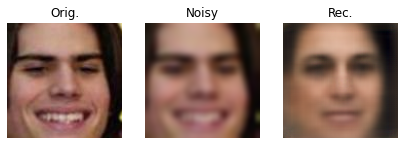

Training epoch = 6


100%|██████████| 953/953 [01:00<00:00, 15.73it/s]


epoch = 6: tr_err = 642.1050407994081, val_err = 0.0156957831031109


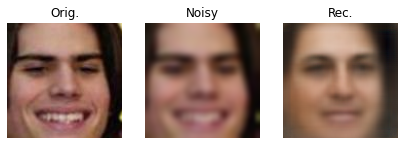

Training epoch = 7


100%|██████████| 953/953 [01:00<00:00, 15.82it/s]


epoch = 7: tr_err = 642.473402281498, val_err = 0.016211320427889354


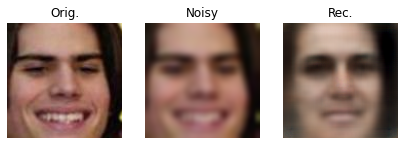

Training epoch = 8


100%|██████████| 953/953 [01:01<00:00, 15.60it/s]


epoch = 8: tr_err = 603.5195902036845, val_err = 0.013608009273879947


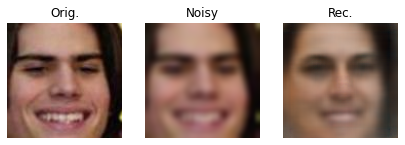

Training epoch = 9


100%|██████████| 953/953 [01:00<00:00, 15.73it/s]


epoch = 9: tr_err = 574.5912439720578, val_err = 0.013997085080735354


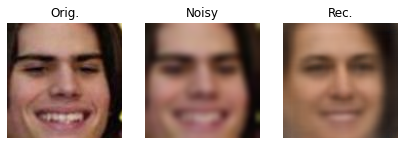

Training epoch = 10


100%|██████████| 953/953 [01:00<00:00, 15.63it/s]


epoch = 10: tr_err = 596.3859833500193, val_err = 0.014142086939831659


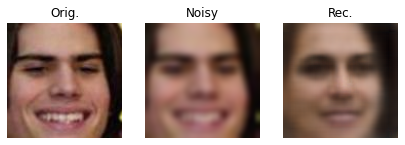

Training epoch = 11


100%|██████████| 953/953 [01:00<00:00, 15.68it/s]


epoch = 11: tr_err = 556.803234024288, val_err = 0.01318927094823521


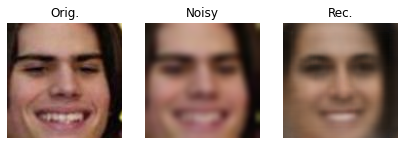

Training epoch = 12


100%|██████████| 953/953 [01:01<00:00, 15.59it/s]


epoch = 12: tr_err = 548.4116627552077, val_err = 0.01360280256889854


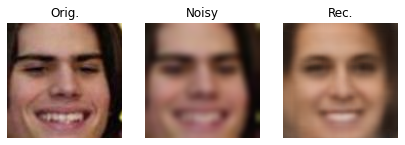

Training epoch = 13


100%|██████████| 953/953 [01:00<00:00, 15.68it/s]


epoch = 13: tr_err = 540.7237316663968, val_err = 0.01305933024297823


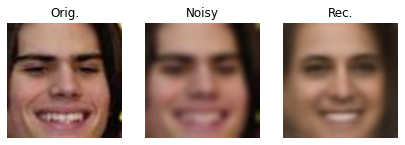

Training epoch = 14


100%|██████████| 953/953 [01:01<00:00, 15.50it/s]


epoch = 14: tr_err = 538.362201734705, val_err = 0.012765025875870153


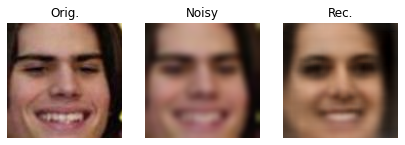

Training epoch = 15


100%|██████████| 953/953 [01:00<00:00, 15.62it/s]


epoch = 15: tr_err = 533.8594576504398, val_err = 0.012745974655555383


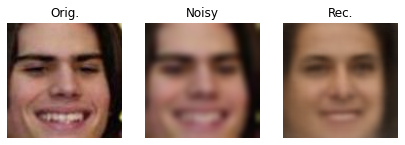

Training epoch = 16


100%|██████████| 953/953 [01:00<00:00, 15.63it/s]


epoch = 16: tr_err = 524.8019464578858, val_err = 0.01258080183415358


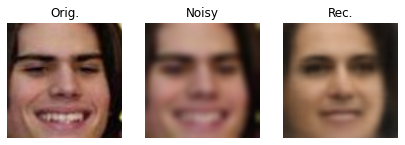

Training epoch = 17


100%|██████████| 953/953 [01:01<00:00, 15.42it/s]


epoch = 17: tr_err = 522.3073650091918, val_err = 0.012146963184566926


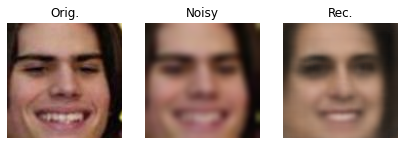

Training epoch = 18


100%|██████████| 953/953 [01:01<00:00, 15.57it/s]


epoch = 18: tr_err = 516.7682654589946, val_err = 0.013493531317329307


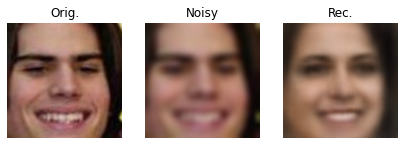

Training epoch = 19


100%|██████████| 953/953 [01:01<00:00, 15.55it/s]


epoch = 19: tr_err = 514.6753489763514, val_err = 0.012235357293617527


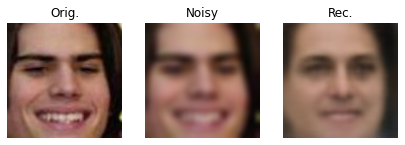

Training epoch = 20


100%|██████████| 953/953 [01:01<00:00, 15.53it/s]


epoch = 20: tr_err = 505.9939345913194, val_err = 0.013461178121893475


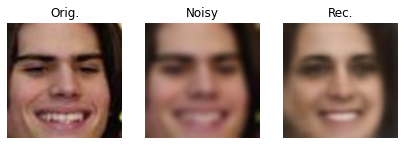

Training epoch = 21


100%|██████████| 953/953 [01:01<00:00, 15.53it/s]


epoch = 21: tr_err = 509.4225183028614, val_err = 0.012039471388439877


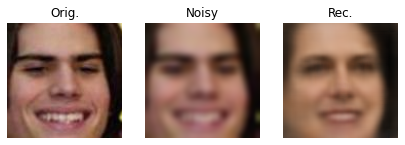

Training epoch = 22


100%|██████████| 953/953 [01:01<00:00, 15.38it/s]


epoch = 22: tr_err = 503.0175551327428, val_err = 0.012408211955870795


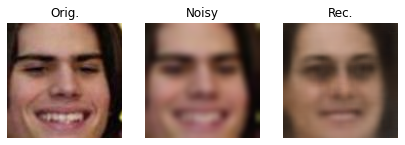

Training epoch = 23


100%|██████████| 953/953 [01:01<00:00, 15.51it/s]


epoch = 23: tr_err = 500.6253343484084, val_err = 0.012334727043106716


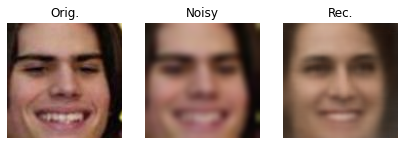

Training epoch = 24


100%|██████████| 953/953 [01:01<00:00, 15.49it/s]


epoch = 24: tr_err = 497.33569544084673, val_err = 0.012416411463997355


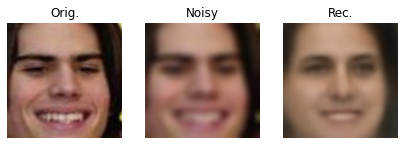

Training epoch = 25


100%|██████████| 953/953 [01:02<00:00, 15.35it/s]


epoch = 25: tr_err = 496.5999800370848, val_err = 0.011866516357669646


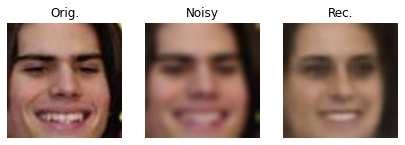

Training epoch = 26


100%|██████████| 953/953 [01:01<00:00, 15.47it/s]


epoch = 26: tr_err = 494.5042658962958, val_err = 0.011945668124753561


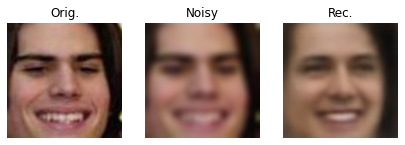

Training epoch = 27


100%|██████████| 953/953 [01:01<00:00, 15.38it/s]


epoch = 27: tr_err = 487.13601015297087, val_err = 0.011968960416616256


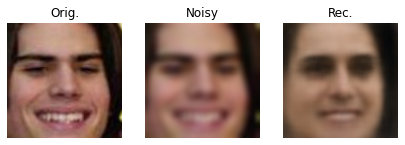

Training epoch = 28


100%|██████████| 953/953 [01:01<00:00, 15.56it/s]


epoch = 28: tr_err = 483.1109532999717, val_err = 0.011909185222907296


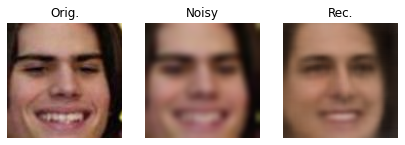

Training epoch = 29


100%|██████████| 953/953 [01:01<00:00, 15.53it/s]


epoch = 29: tr_err = 481.98295604469644, val_err = 0.011902766325608457


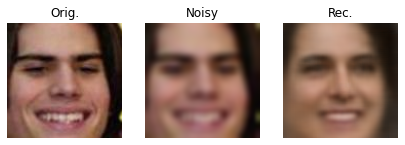

In [ ]:
model_c_l2.fit(train_dataset, 30)

### modelli nuovi

In [ ]:
class VAE3(nn.Module): # semplificata, solo relu e adam
    def __init__(self, latent_space_dim: int, initial_lr: float, batch_size: int, dropout: float = None, l1_reg_strength: float = None, l2_reg_strength: float = None,
                loss_fn = nn.MSELoss(), device = 'cuda', alpha = 0.1): # reduction = 'sum'
        super().__init__()
        self.latent_space_dim = latent_space_dim
        self.device = device
        self.dropout = dropout
        self.alpha = alpha

        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride = 2, padding = 1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride = 2, padding = 1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride = 2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(), # N, 256, 12, 12 -> 36864
        )
        
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, 4, stride = 2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride = 2, padding = 1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride = 2, padding = 1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )

        self.avg = nn.Sequential( # Predicts the means of a MVN dist.                
            # N 256 12 12
            nn.Conv2d(256, 256, kernel_size = 1),
            nn.BatchNorm2d(256)
            # nn.ReLU()
        )

        self.log_var = nn.Sequential( # Predicts the (log) variances of an uncorrelated MVN (i.e. log of cov. matrix diagonal)
            nn.Conv2d(256, 256, kernel_size = 1),
            nn.BatchNorm2d(256)
            # nn.ReLU()
        )

        self.optimizer = torch.optim.Adam(params = self.parameters(), lr = initial_lr)
        
        self.batch_size = batch_size
        self.loss_fn = loss_fn
        self.l1_reg_strength = l1_reg_strength
        self.l2_reg_strength = l2_reg_strength

        if l1_reg_strength is None and l2_reg_strength is None:
            self.reg = lambda: torch.tensor([0], dtype = float, requires_grad = True).to(self.device)
        if l1_reg_strength is not None:
            self.reg = lambda: (sum(((w.abs()).sum() for w in self.parameters()))*self.l1_reg_strength).to(self.device)
        if l2_reg_strength is not None:
            self.reg = lambda: (sum(((w**2).sum() for w in self.parameters()))*self.l2_reg_strength).to(self.device)

    def sample_in_latent_space(self, mu, log_var): # sampling from MVN in latent space with provided mean and variances
        sigma = torch.exp(0.5 * log_var) #log_var is log(variance) = log(sigma**2) = 2 * log(sigma)
        return mu + torch.randn_like(mu) * sigma
        #Var(aX) = a**2 Var(X), so we need to multiply pred_sqrt_var = sigma (square root of the variance) by the standard normal distribution

    def forward(self, x):
        internal_repr  = self.encoder(x) # conv. part --> produces the internal representation
        pred_means     = self.avg(internal_repr) # linear part 1 --> predicts means
        pred_log_var   = self.log_var(internal_repr) # linear part 2 --> predicts variances
        sample         = self.sample_in_latent_space(mu = pred_means, log_var = pred_log_var) # sample in latent space
        decoded_sample = self.decoder(sample) # decoder --> produces final output
        
        return decoded_sample #, pred_means, pred_log_var # we need to pass means and vars forward too, since they're needed to compute the KL div. term in the loss

    def train_single_epoch(self, train_dataloader, verbose_single_epoch: bool = True): # function to be iterated inside the fit loop (no cv)
        self.train() # enable dropout etc.
        tr_err_single_epoch = 0
        # SOLO BLURRED O PIXELATED
        loading = tqdm(train_dataloader) if verbose_single_epoch else train_dataloader
        for orig_batch, noisy_batch in loading: # ignore y_batch, we don't need the labels
            output = self(noisy_batch) # , mu, log_var
            loss_mse = self.loss_fn(output, orig_batch) + self.reg()
            # loss_reg = - self.alpha * 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var))
            loss = loss_mse # + loss_reg

            # print(f'training loss: mse = {loss_mse.float()}, reg_gauss = {loss_reg.float()} (alpha = {self.alpha.float()}), total = {loss.float()}')

            # loss                = self.loss_fn(output, orig_batch) + self.reg() - self.alpha * 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var))
            
            # loss /= len(orig_batch)

            # print(f'scaled training loss: {loss.float()}')

            self.optimizer.zero_grad() # reset gradients
            loss.backward() # backpropagation
            self.optimizer.step() # update weights
            tr_err_single_epoch += loss.detach().cpu().numpy() # save current training error
        
        tr_err_single_epoch /= len(train_dataloader) # len of a dataloader = n. of batches
        return tr_err_single_epoch

    @torch.no_grad()
    def val_single_epoch(self, val_dataloader):
        self.eval() # disable dropout etc.
        val_err_single_epoch = 0

        for orig_batch, noisy_batch in val_dataloader: # ignore y_batch, we don't need the labels
            output   = self(noisy_batch) # , mu, log_var
            loss                  = nn.MSELoss()(output, orig_batch) # we compare the reconstructed output with the original input
            val_err_single_epoch += loss.detach().cpu().numpy()
        
        val_err_single_epoch /= len(val_dataloader)
        return val_err_single_epoch

    def fit(self, training_dataset, max_n_iter: int = 15, min_n_iter: int = 3, patience: int = 4, tol: float = 0.0001, seed: int = 1234, verbose: bool = True, num_workers: int = 0):
        if seed is not None: # default seed to ensure reproducibility
            torch.random.manual_seed(seed)

        training_dataloader, validation_dataloader = create_train_val_dataloaders(training_dataset, batch_size = self.batch_size, num_workers = num_workers) # dependent on self.batch_size

        self.training_error_history, self.val_error_history = np.zeros(max_n_iter), np.zeros(max_n_iter) # no CV --> no average over dataloaders --> we have a single value to use as an estimate of tr./val. errors
        self.best_val_error = np.Inf
        patience_counter = 0

        loading = range(max_n_iter) # trange(max_n_iter) # if verbose else range(max_n_iter) # useful toggle during training/debugging
        for epoch in loading:
            if verbose:
                print(f'Training epoch = {epoch}') # useful to track training
            tr_err  = self.training_error_history[epoch] = self.train_single_epoch(train_dataloader = training_dataloader)
            val_err = self.val_error_history[epoch] = self.val_single_epoch(val_dataloader = validation_dataloader)
            if verbose:
                print(f'epoch = {epoch}: tr_err = {tr_err}, val_err = {val_err}') # useful to track training
                self.plot_original_vs_reconstructed_sample(*(test_dataset[0])) # quel tipo con la faccia strana
                # così le fa vedere tutte alla fine
                # plt.tight_layout()
                plt.pause(0.1)
                plt.show()
                plt.close()

            if epoch > min_n_iter:
                if val_err > self.best_val_error + tol:
                    patience_counter += 1
                else:
                    self.best_val_error = val_err
                    patience_counter = 0
                if patience_counter > patience:
                    break
        n_executed_epochs = epoch + 1 # + 1 to go from 0, N-1 (python) to 1, N (human readable) counting scheme 
        if n_executed_epochs < max_n_iter:
            self.best_val_error_epoch = n_executed_epochs - patience_counter
        else:
            self.best_val_error_epoch = max_n_iter - patience_counter

    def save(self, root_path, model_name):
        path = f'{root_path}/{model_name}'
        torch.save(self.state_dict(), path + '.pt')
        np.savetxt(path + '_th.csv', self.training_error_history)
        np.savetxt(path + '_vh.csv', self.val_error_history)

    @torch.no_grad()
    def predict(self, sample):
        self.eval()
        if sample.shape == torch.Size([3, 112, 112]): # a single sample # torch.Size([1, 28, 28]) in origine (-> serve la dim. 0 = N)
            output = self(sample.unsqueeze(0))[0] # the forward pass computes means and variances too, but here we only want the reconstructed samples
        else:
            output = self(sample)[0]
        return output

    def test_accuracy(self, test_dataset):
        v = np.zeros(len(test_dataset))
        for i in range(len(test_dataset)):
            img, noisy_img = test_dataset[i]
            v[i] = float(nn.MSELoss()(self.predict(noisy_img), img))
        return v.mean()

    def plot_original_vs_reconstructed_sample(self, orig_sample, noisy_sample, figsize = (7, 7), return_array: bool = False):
        fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = figsize)
        img_orig = orig_sample.cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_rec = self.predict(noisy_sample).cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_noisy = noisy_sample.cpu().detach().numpy().transpose((1, 2, 0))

        ax[0].imshow(img_orig * 0.5 + 0.5, cmap = 'gray')
        ax[0].set_title('Orig.')
        ax[0].axis('off')
        ax[1].imshow(img_noisy * 0.5 + 0.5, cmap = 'gray')
        ax[1].set_title('Noisy')
        ax[1].axis('off')
        ax[2].imshow(img_rec * 0.5 + 0.5, cmap = 'gray')
        ax[2].set_title('Rec.')
        ax[2].axis('off')

        if return_array:
            return img_rec
        else:
            return fig, ax

    
    def plot_reconstructed_samples(self, dataset, nrows: int = 3, ncols: int = 3, figsize = (42, 21)):
        indices = np.arange(nrows * ncols)
        idx = 0
        ncols = 2*ncols
        fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = figsize)
        
        for i in range(nrows):
            for j in range(0, ncols, 2):
                img = dataset.data[indices[idx]]
                img_rec = self.plot_original_vs_reconstructed_sample(img, return_array = True)
                # img = img.detach().cpu().squeeze(0).numpy()
                img = img.detach().cpu().numpy().transpose((1, 2, 0))
                ax[i,j].imshow(img, cmap = 'gray')
                ax[i,j].set_title('Orig.')
                ax[i,j].axis('off')
                ax[i,j+1].imshow(img_rec, cmap = 'gray')
                ax[i,j+1].set_title('Rec.')
                ax[i,j+1].axis('off')
                idx += 1

        return fig, ax

In [ ]:
m3 = VAE3(420, initial_lr = 1e-3, batch_size = 8, l2_reg_strength = 5e-4, alpha = 0.01).cuda()

In [ ]:
# ADD NORMALIZ


# base_transform = torchvision.transforms.Compose([torchvision.transforms.CenterCrop(112), torchvision.transforms.Normalize(0.5, 0.5)])
base_transform = torchvision.transforms.Compose([torchvision.transforms.CenterCrop(112)]) # come interagisce normalize con la divisione per 255?

class LFWP(torchvision.datasets.LFWPeople):
    def __init__(self, root: str, split: str = "10fold", image_set: str = "deepfunneled", transform = torchvision.transforms.GaussianBlur(9, 4), target_transform = None, download: bool = False,
                 base_transform = base_transform, device = None): # default funneled
        super().__init__(root, split, image_set, transform, target_transform, download)
        self.base_transform = base_transform
        self.device = device


    def __getitem__(self, index: int):
        img       = self.base_transform(torchvision.io.read_image(path = self.data[index]) / 255)
        noisy_img = self.transform(img)

        img, noisy_img = torchvision.transforms.Normalize(0.5, 0.5)(img), torchvision.transforms.Normalize(0.5, 0.5)(noisy_img)

        if self.device is not None:
            img, noisy_img = img.to(self.device), noisy_img.to(self.device)

        return img, noisy_img

    def plot(self, index, figsize = (10, 5)):
        img, noisy_img = self[index]
        img = np.transpose(img.cpu().numpy(), (1, 2, 0))
        noisy_img = np.transpose(noisy_img.cpu().numpy(), (1, 2, 0))

        fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = figsize)

        ax[0].imshow(img * 0.5 + 0.5)
        ax[1].imshow(noisy_img * 0.5 + 0.5)

        ax[0].set_title('original')
        ax[1].set_title('transformed')

        return ax


test_dataset  = LFWP('./lfw_torch/', split = 'test', download = True , device = 'cuda')
train_dataset = LFWP('./lfw_torch/', split = 'train', download = True , device = 'cuda')

Files already downloaded and verified
Files already downloaded and verified


Training epoch = 0


100%|██████████| 953/953 [00:53<00:00, 17.84it/s]


epoch = 0: tr_err = 0.45750893674329596, val_err = 0.030879577504915174


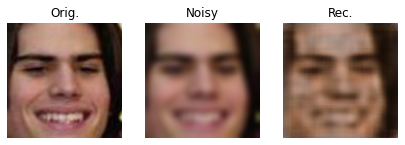

Training epoch = 1


100%|██████████| 953/953 [00:51<00:00, 18.48it/s]


epoch = 1: tr_err = 0.09409480964508912, val_err = 0.04762194487246759


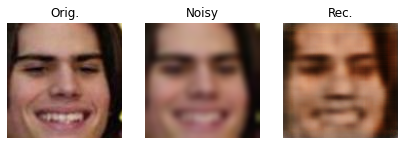

Training epoch = 2


100%|██████████| 953/953 [00:51<00:00, 18.42it/s]


epoch = 2: tr_err = 0.05342325626443466, val_err = 0.024594338088604197


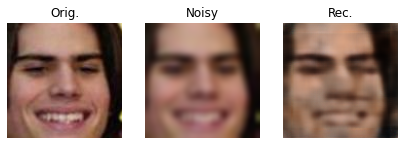

Training epoch = 3


100%|██████████| 953/953 [00:52<00:00, 18.29it/s]


epoch = 3: tr_err = 0.045777678063602535, val_err = 0.029686846119589386


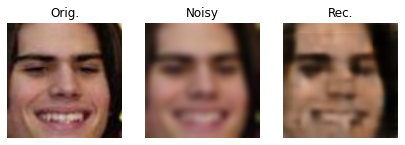

Training epoch = 4


100%|██████████| 953/953 [00:54<00:00, 17.59it/s]


epoch = 4: tr_err = 0.042554591464783686, val_err = 0.024179706552599763


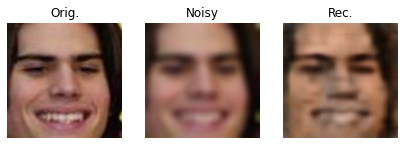

Training epoch = 5


100%|██████████| 953/953 [00:51<00:00, 18.46it/s]


epoch = 5: tr_err = 0.03938491518363935, val_err = 0.020712975739933956


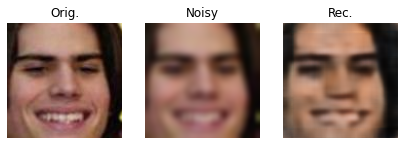

Training epoch = 6


100%|██████████| 953/953 [00:51<00:00, 18.36it/s]


epoch = 6: tr_err = 0.03790107098723696, val_err = 0.025431012664629327


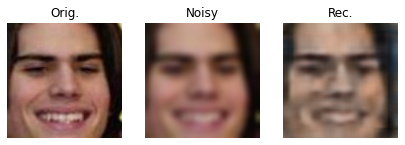

Training epoch = 7


100%|██████████| 953/953 [00:52<00:00, 18.23it/s]


epoch = 7: tr_err = 0.03634255504526847, val_err = 0.025426261290658468


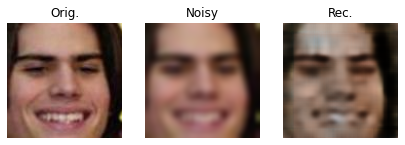

Training epoch = 8


100%|██████████| 953/953 [00:52<00:00, 18.23it/s]


epoch = 8: tr_err = 0.03610330502085333, val_err = 0.018035551046009592


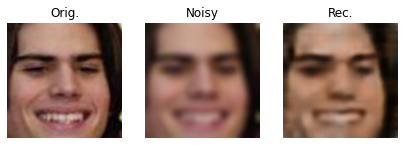

Training epoch = 9


100%|██████████| 953/953 [00:52<00:00, 18.20it/s]


epoch = 9: tr_err = 0.03509121372951791, val_err = 0.02027387437741876


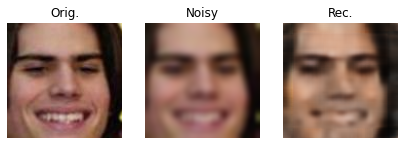

Training epoch = 10


100%|██████████| 953/953 [00:54<00:00, 17.46it/s]


epoch = 10: tr_err = 0.03493524072076128, val_err = 0.023034445746610854


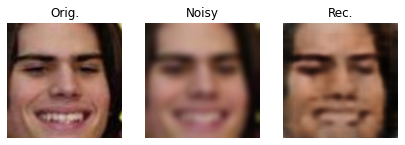

Training epoch = 11


100%|██████████| 953/953 [00:52<00:00, 18.07it/s]


epoch = 11: tr_err = 0.03448844314059331, val_err = 0.02147084457417911


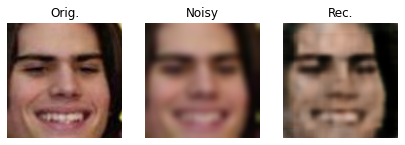

Training epoch = 12


100%|██████████| 953/953 [00:53<00:00, 17.88it/s]


epoch = 12: tr_err = 0.03468478405173841, val_err = 0.020992535162545647


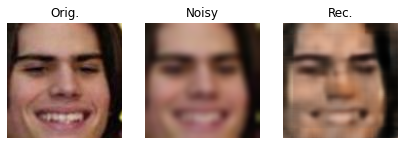

Training epoch = 13


100%|██████████| 953/953 [00:52<00:00, 18.03it/s]


epoch = 13: tr_err = 0.03423416681181159, val_err = 0.033892254707516487


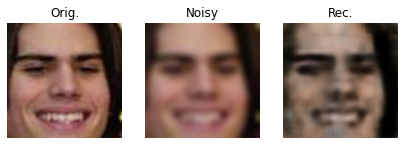

In [ ]:
m3.fit(train_dataset, 15) # normalizzazione utile per accelerare la convergenza, pare
# comunque l'altro fa meglio. Probabilmente perché usa funneled

In [ ]:
test_dataset  = LFWP('./lfw_torch/', split = 'test', download = True , device = 'cuda', image_set = 'funneled')
train_dataset = LFWP('./lfw_torch/', split = 'train', download = True , device = 'cuda', image_set = 'funneled')

  0%|          | 0/243346528 [00:00<?, ?it/s]

Extracting ./lfw_torch/lfw-py/lfw-funneled.tgz to ./lfw_torch/lfw-py
Using downloaded and verified file: ./lfw_torch/lfw-py/peopleDevTest.txt
Using downloaded and verified file: ./lfw_torch/lfw-py/lfw-names.txt
Files already downloaded and verified


In [ ]:
m4 = VAE3(420, initial_lr = 1e-3, batch_size = 8, l2_reg_strength = 5e-4, alpha = 0.01).cuda()

Training epoch = 0


100%|██████████| 953/953 [00:52<00:00, 18.19it/s]


epoch = 0: tr_err = 0.4617482905060147, val_err = 0.037518345746971576


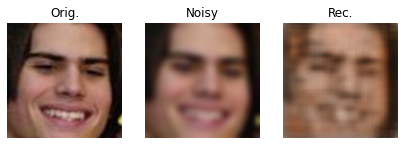

Training epoch = 1


100%|██████████| 953/953 [00:52<00:00, 18.25it/s]


epoch = 1: tr_err = 0.09367524547519988, val_err = 0.025352718012415214


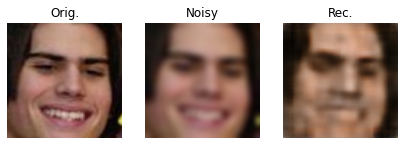

Training epoch = 2


100%|██████████| 953/953 [00:52<00:00, 18.20it/s]


epoch = 2: tr_err = 0.05343072470531634, val_err = 0.023947323941348984


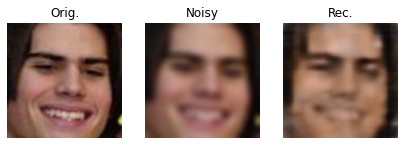

Training epoch = 3


100%|██████████| 953/953 [00:52<00:00, 18.12it/s]


epoch = 3: tr_err = 0.045170979373008485, val_err = 0.02777787674389873


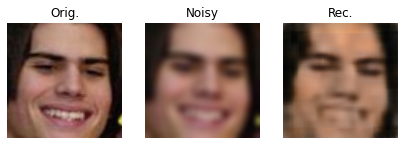

Training epoch = 4


100%|██████████| 953/953 [00:52<00:00, 18.06it/s]


epoch = 4: tr_err = 0.04075859307437541, val_err = 0.020076967066613702


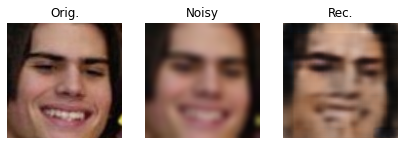

Training epoch = 5


100%|██████████| 953/953 [00:52<00:00, 18.07it/s]


epoch = 5: tr_err = 0.037667870920264836, val_err = 0.018475261193439053


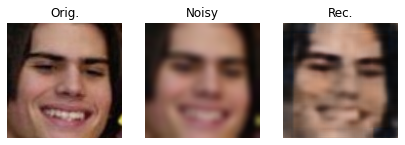

Training epoch = 6


100%|██████████| 953/953 [00:52<00:00, 18.06it/s]


epoch = 6: tr_err = 0.036079558843877736, val_err = 0.03496017187802612


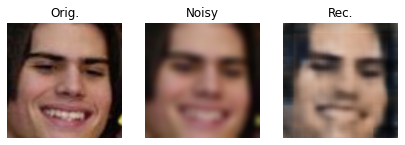

Training epoch = 7


100%|██████████| 953/953 [00:52<00:00, 18.03it/s]


epoch = 7: tr_err = 0.03468538687446185, val_err = 0.023739077181995662


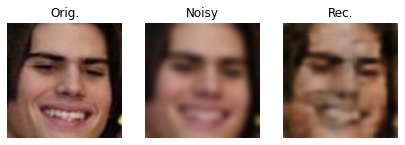

Training epoch = 8


100%|██████████| 953/953 [00:52<00:00, 18.03it/s]


epoch = 8: tr_err = 0.03467592522150134, val_err = 0.020163514172058226


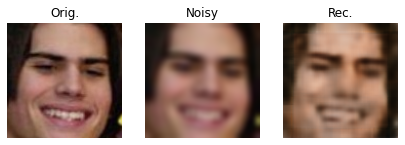

Training epoch = 9


100%|██████████| 953/953 [00:53<00:00, 17.96it/s]


epoch = 9: tr_err = 0.033489854361349866, val_err = 0.016350344976870088


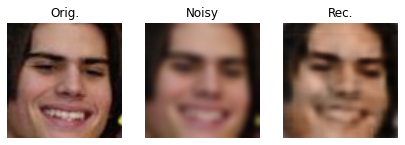

Training epoch = 10


100%|██████████| 953/953 [00:53<00:00, 17.92it/s]


epoch = 10: tr_err = 0.03361317362335334, val_err = 0.018196188392717718


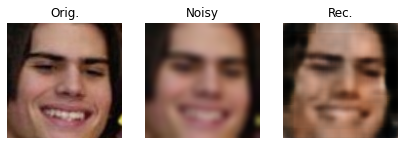

Training epoch = 11


100%|██████████| 953/953 [00:53<00:00, 17.92it/s]


epoch = 11: tr_err = 0.0335024913747532, val_err = 0.01940604936035358


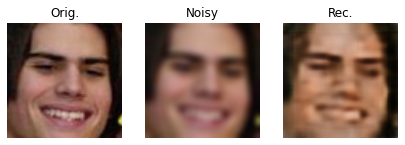

Training epoch = 12


100%|██████████| 953/953 [00:53<00:00, 17.77it/s]


epoch = 12: tr_err = 0.0336756436769916, val_err = 0.027577337656933893


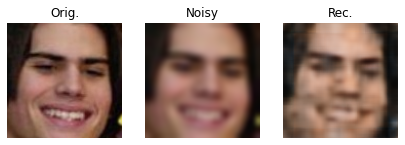

Training epoch = 13


100%|██████████| 953/953 [00:53<00:00, 17.81it/s]


epoch = 13: tr_err = 0.033209898627332854, val_err = 0.029916945135680703


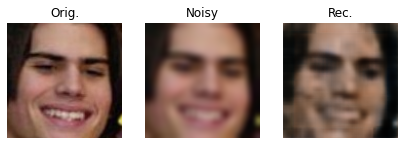

Training epoch = 14


100%|██████████| 953/953 [00:53<00:00, 17.78it/s]


epoch = 14: tr_err = 0.033593673411471396, val_err = 0.02164470519730237


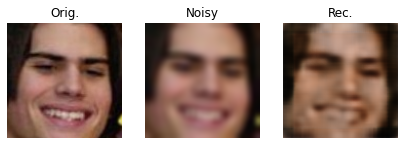

In [ ]:
m4.fit(train_dataset, 15)

## dataset funnel + normaliz

In [ ]:
class LFWP_Luca(LFWP):
    def __getitem__(self, index):
        img       = self.base_transform(torchvision.io.read_image(path = self.data[index]) / 255)
        noisy_img = self.transform(img)

        img = torchvision.transforms.Normalize(0.5, 0.5)(img)
        noisy_img = torchvision.transforms.Normalize(0.5, 0.5)(noisy_img)

        if self.device is not None:
            img, noisy_img = img.to(self.device), noisy_img.to(self.device)

        return img, noisy_img

    def plot(self, index, figsize = (10, 5)):
        img, noisy_img = self[index]
        img = np.transpose(img.cpu().numpy(), (1, 2, 0)) * 0.5 + 0.5
        noisy_img = np.transpose(noisy_img.cpu().numpy(), (1, 2, 0)) * 0.5 + 0.5

        fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = figsize)

        ax[0].imshow(img)
        ax[1].imshow(noisy_img)

        ax[0].set_title('original')
        ax[1].set_title('transformed')

        return ax

In [ ]:
test_dataset_luca  = LFWP_Luca('./lfw_torch/', split = 'test', download = True, image_set = 'funneled') # , device = 'cuda'
train_dataset_luca = LFWP_Luca('./lfw_torch/', split = 'train', download = True, image_set = 'funneled') # , device = 'cuda'

  0%|          | 0/243346528 [00:00<?, ?it/s]

Extracting ./lfw_torch/lfw-py/lfw-funneled.tgz to ./lfw_torch/lfw-py
Using downloaded and verified file: ./lfw_torch/lfw-py/peopleDevTest.txt
Using downloaded and verified file: ./lfw_torch/lfw-py/lfw-names.txt
Files already downloaded and verified


In [ ]:
class VAE_C_Luca(VAE_C):
    def plot_original_vs_reconstructed_sample(self, orig_sample, noisy_sample, figsize = (7, 7), return_array: bool = False):
        fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = figsize)
        img_orig = (orig_sample.cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))) * 0.5 + 0.5
        img_rec = (self.predict(noisy_sample).cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))) * 0.5 + 0.5
        img_noisy = (noisy_sample.cpu().detach().numpy().transpose((1, 2, 0))) * 0.5 + 0.5

        ax[0].imshow(img_orig, cmap = 'gray')
        ax[0].set_title('Orig.')
        ax[0].axis('off')
        ax[1].imshow(img_noisy, cmap = 'gray')
        ax[1].set_title('Noisy')
        ax[1].axis('off')
        ax[2].imshow(img_rec, cmap = 'gray')
        ax[2].set_title('Rec.')
        ax[2].axis('off')

        if return_array:
            return img_rec
        else:
            return fig, ax

In [ ]:
model_c_luca = VAE_C_Luca(250, 1e-3, 8)

In [ ]:
model_c_luca.fit(train_dataset_luca, 20)

Training epoch = 0


  7%|▋         | 62/953 [02:00<28:56,  1.95s/it]


KeyboardInterrupt: ignored

## Cose (?)

In [ ]:
class CAE1(nn.Module): # semplificata, solo relu e adam
    def __init__(self, latent_space_dim: int, initial_lr: float, batch_size: int, dropout: float = None, l1_reg_strength: float = None, l2_reg_strength: float = None,
                loss_fn = nn.MSELoss(reduction = 'sum'), device = 'cuda'):
        super().__init__()
        self.latent_space_dim = latent_space_dim
        self.device = device
        self.dropout = dropout

        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride = 2, padding = 1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride = 2, padding = 1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride = 2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(), # N, 256, 12, 12 -> 36864
            # nn.Flatten(start_dim = 1)
        )
        
        self.decoder = nn.Sequential(
            # nn.Unflatten(dim = 1, unflattened_size = (64, 1, 1)),
            # nn.ConvTranspose2d(64, 128, kernel_size = 3, stride = 1, padding = 0, output_padding = 0),
            # nn.ReLU(), # N 128 3 3 
            # nn.ConvTranspose2d(128, 256, kernel_size = 8, stride = 2, padding = 0, output_padding = 0),
            # nn.ReLU(), # N 256 12 12
           
           
            # nn.Linear(self.latent_space_dim, 36864),
            # nn.ReLU(),

            # nn.Linear(self.latent_space_dim, 100),
            # nn.ReLU(),
            # nn.Linear(100, 36864),
            # nn.ReLU(),
            # nn.Unflatten(dim = 1, unflattened_size = (256, 12, 12)),
            nn.ConvTranspose2d(256, 256, 4, stride = 2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride = 2, padding = 1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride = 2, padding = 1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )

        self.avg = nn.Sequential( # Predicts the means of a MVN dist.
            # nn.Linear(36864, 100),
            # nn.ReLU(),
            # # nn.Dropout(self.dropout) if dropout is not None else nn.Identity(),
            # nn.Linear(100, self.latent_space_dim)

            # nn.Linear(36864, self.latent_space_dim),
            # nn.ReLU()

            # N 256 12 12
            nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            nn.ReLU(), # N 128 3 3
            nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            nn.Flatten(start_dim = 1)
        )

        self.log_var = nn.Sequential( # Predicts the (log) variances of an uncorrelated MVN (i.e. log of cov. matrix diagonal)
            # nn.Linear(36864, 100), # 288
            # nn.ReLU(),
            # # nn.Dropout(self.dropout) if dropout is not None else nn.Identity(),
            # nn.Linear(100, self.latent_space_dim)

            # nn.Linear(36864, self.latent_space_dim),
            # nn.ReLU()

            nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            nn.ReLU(),
            nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            nn.Flatten(start_dim = 1)
        )

        self.optimizer = torch.optim.Adam(params = self.parameters(), lr = initial_lr)
        
        self.batch_size = batch_size
        self.loss_fn = loss_fn
        self.l1_reg_strength = l1_reg_strength
        self.l2_reg_strength = l2_reg_strength

        if l1_reg_strength is None and l2_reg_strength is None:
            self.reg = lambda: torch.tensor([0], dtype = float, requires_grad = True).to(self.device)
        if l1_reg_strength is not None:
            self.reg = lambda: (sum(((w.abs()).sum() for w in self.parameters()))*self.l1_reg_strength).to(self.device)
        if l2_reg_strength is not None:
            self.reg = lambda: (sum(((w**2).sum() for w in self.parameters()))*self.l2_reg_strength).to(self.device)

    def sample_in_latent_space(self, mu, log_var): # sampling from MVN in latent space with provided mean and variances
        sigma = torch.exp(0.5 * log_var) #log_var is log(variance) = log(sigma**2) = 2 * log(sigma)
        return mu + torch.randn_like(mu) * sigma
        #Var(aX) = a**2 Var(X), so we need to multiply pred_sqrt_var = sigma (square root of the variance) by the standard normal distribution

    def forward(self, x):
        internal_repr  = self.encoder(x) # conv. part --> produces the internal representation
        # pred_means     = self.avg(internal_repr) # linear part 1 --> predicts means
        # pred_log_var   = self.log_var(internal_repr) # linear part 2 --> predicts variances
        # sample         = self.sample_in_latent_space(mu = pred_means, log_var = pred_log_var) # sample in latent space
        # decoded_sample = self.decoder(sample) # decoder --> produces final output
        decoded_sample = self.decoder(internal_repr)

        return decoded_sample#, pred_means, pred_log_var # we need to pass means and vars forward too, since they're needed to compute the KL div. term in the loss

    def train_single_epoch(self, train_dataloader, verbose_single_epoch: bool = True): # function to be iterated inside the fit loop (no cv)
        self.train() # enable dropout etc.
        tr_err_single_epoch = 0
        # SOLO BLURRED O PIXELATED
        loading = tqdm(train_dataloader) if verbose_single_epoch else train_dataloader
        for orig_batch, noisy_batch in loading: # ignore y_batch, we don't need the labels
            # output, mu, log_var = self(noisy_batch)
            # loss                = self.loss_fn(output, orig_batch) + self.reg() - 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var))
            output = self(noisy_batch)
            loss = self.loss_fn(output, orig_batch) + self.reg()
            loss /= len(orig_batch)
            self.optimizer.zero_grad() # reset gradients
            loss.backward() # backpropagation
            self.optimizer.step() # update weights
            tr_err_single_epoch += loss.detach().cpu().numpy() # save current training error
        
        tr_err_single_epoch /= len(train_dataloader) # len of a dataloader = n. of batches
        return tr_err_single_epoch

    @torch.no_grad()
    def val_single_epoch(self, val_dataloader):
        self.eval() # disable dropout etc.
        val_err_single_epoch = 0

        for orig_batch, noisy_batch in val_dataloader: # ignore y_batch, we don't need the labels
            # output, mu, log_var   = self(noisy_batch)
            output = self(noisy_batch)
            loss                  = nn.MSELoss()(output, orig_batch) # we compare the reconstructed output with the original input
            val_err_single_epoch += loss.detach().cpu().numpy()
        
        val_err_single_epoch /= len(val_dataloader)
        return val_err_single_epoch

    def fit(self, training_dataset, max_n_iter: int = 15, min_n_iter: int = 3, patience: int = 4, tol: float = 0.0001, seed: int = 1234, verbose: bool = True, num_workers: int = 0):
        if seed is not None: # default seed to ensure reproducibility
            torch.random.manual_seed(seed)

        training_dataloader, validation_dataloader = create_train_val_dataloaders(training_dataset, batch_size = self.batch_size, num_workers = num_workers) # dependent on self.batch_size

        self.training_error_history, self.val_error_history = np.zeros(max_n_iter), np.zeros(max_n_iter) # no CV --> no average over dataloaders --> we have a single value to use as an estimate of tr./val. errors
        self.best_val_error = np.Inf
        patience_counter = 0

        loading = trange(max_n_iter) # if verbose else range(max_n_iter) # useful toggle during training/debugging
        for epoch in loading:
            if verbose:
                print(f'Training epoch = {epoch}') # useful to track training
            tr_err  = self.training_error_history[epoch] = self.train_single_epoch(train_dataloader = training_dataloader)
            val_err = self.val_error_history[epoch] = self.val_single_epoch(val_dataloader = validation_dataloader)
            if verbose:
                print(f'epoch = {epoch}: tr_err = {tr_err}, val_err = {val_err}') # useful to track training
                self.plot_original_vs_reconstructed_sample(*(test_dataset[0])) # quel tipo con la faccia strana
                # così le fa vedere tutte alla fine

            if epoch > min_n_iter:
                if val_err > self.best_val_error + tol:
                    patience_counter += 1
                else:
                    self.best_val_error = val_err
                    patience_counter = 0
                if patience_counter > patience:
                    break
        n_executed_epochs = epoch + 1 # + 1 to go from 0, N-1 (python) to 1, N (human readable) counting scheme 
        if n_executed_epochs < max_n_iter:
            self.best_val_error_epoch = n_executed_epochs - patience_counter
        else:
            self.best_val_error_epoch = max_n_iter - patience_counter

    def save(self, root_path, model_name):
        path = f'{root_path}/{model_name}'
        torch.save(self.state_dict(), path + '.pt')
        np.savetxt(path + '_th.csv', self.training_error_history)
        np.savetxt(path + '_vh.csv', self.val_error_history)

    @torch.no_grad()
    def predict(self, sample):
        self.eval()
        if sample.shape == torch.Size([3, 112, 112]): # a single sample # torch.Size([1, 28, 28]) in origine (-> serve la dim. 0 = N)
            output = self(sample.unsqueeze(0))[0] # the forward pass computes means and variances too, but here we only want the reconstructed samples
        else:
            output = self(sample)[0]
        return output

    def test_accuracy(self, test_dataset):
        v = np.zeros(len(test_dataset))
        for i in range(len(test_dataset)):
            img, noisy_img = test_dataset[i]
            v[i] = float(nn.MSELoss()(self.predict(noisy_img), img))
        return v.mean()

    def plot_original_vs_reconstructed_sample(self, orig_sample, noisy_sample, figsize = (7, 7), return_array: bool = False):
        fig, ax = plt.subplots(nrows = 1, ncols = 3, figsize = figsize)
        img_orig = orig_sample.cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_rec = self.predict(noisy_sample).cpu().detach().squeeze(0).numpy().transpose((1, 2, 0))
        img_noisy = noisy_sample.cpu().detach().numpy().transpose((1, 2, 0))

        ax[0].imshow(img_orig, cmap = 'gray')
        ax[0].set_title('Orig.')
        ax[0].axis('off')
        ax[1].imshow(img_noisy, cmap = 'gray')
        ax[1].set_title('Noisy')
        ax[1].axis('off')
        ax[2].imshow(img_rec, cmap = 'gray')
        ax[2].set_title('Rec.')
        ax[2].axis('off')

        if return_array:
            return img_rec
        else:
            return fig, ax

    
    def plot_reconstructed_samples(self, dataset, nrows: int = 3, ncols: int = 3, figsize = (42, 21)):
        indices = np.arange(nrows * ncols)
        idx = 0
        ncols = 2*ncols
        fig, ax = plt.subplots(nrows = nrows, ncols = ncols, figsize = figsize)
        
        for i in range(nrows):
            for j in range(0, ncols, 2):
                img = dataset.data[indices[idx]]
                img_rec = self.plot_original_vs_reconstructed_sample(img, return_array = True)
                # img = img.detach().cpu().squeeze(0).numpy()
                img = img.detach().cpu().numpy().transpose((1, 2, 0))
                ax[i,j].imshow(img, cmap = 'gray')
                ax[i,j].set_title('Orig.')
                ax[i,j].axis('off')
                ax[i,j+1].imshow(img_rec, cmap = 'gray')
                ax[i,j+1].set_title('Rec.')
                ax[i,j+1].axis('off')
                idx += 1

        return fig, ax

In [ ]:
model1 = CAE1(50, 1e-3, 8)


In [ ]:
model1.fit(train_dataset)

  0%|          | 0/15 [00:00<?, ?it/s]

Training epoch = 0



  0%|          | 0/15 [00:08<?, ?it/s]


KeyboardInterrupt: ignored

## Luca Gauss conv vae

In [ ]:
# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

Selected device: cuda


In [ ]:
class AutoEncodeDataset(Dataset):
    """"""

    def __init__(self, dataset_gt, dataset_blur):
        self.dataset_gt = dataset_gt
        self.dataset_blur = dataset_blur

    def __len__(self):
        return len(self.dataset_gt)

    def __getitem__(self, idx):
        x, _ = self.dataset_blur.__getitem__(idx)
        y, _ = self.dataset_gt.__getitem__(idx)
        return x, y

In [ ]:
initial_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.CenterCrop(112),
    transforms.Normalize(0.5,0.5)])

blur_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.CenterCrop(112),
    transforms.GaussianBlur(9,4),
    transforms.Normalize(0.5,0.5)])

In [ ]:
data_dir = './lfw_torch/'

train_dataset = AutoEncodeDataset(
    torchvision.datasets.LFWPeople(data_dir, split='train', download=True, transform=initial_transform),
    torchvision.datasets.LFWPeople(data_dir, split='train', download=True, transform=blur_transform)
)

test_dataset = AutoEncodeDataset(
    torchvision.datasets.LFWPeople(data_dir, split='test', download=True, transform=initial_transform),
    torchvision.datasets.LFWPeople(data_dir, split='test', download=True, transform=blur_transform)
)

  0%|          | 0/243346528 [00:00<?, ?it/s]

Extracting ./lfw_torch/lfw-py/lfw-funneled.tgz to ./lfw_torch/lfw-py


  0%|          | 0/66403 [00:00<?, ?it/s]

  0%|          | 0/94727 [00:00<?, ?it/s]

Files already downloaded and verified
Using downloaded and verified file: ./lfw_torch/lfw-py/lfw-funneled.tgz
Extracting ./lfw_torch/lfw-py/lfw-funneled.tgz to ./lfw_torch/lfw-py


  0%|          | 0/28334 [00:00<?, ?it/s]

Using downloaded and verified file: ./lfw_torch/lfw-py/lfw-names.txt
Files already downloaded and verified


In [ ]:
batch_size = 8

N_val = int(len(train_dataset)*0.2)
train_dataset_red, val_dataset = random_split(train_dataset, 
                                 lengths=[len(train_dataset)-N_val, N_val], 
                                 generator=torch.Generator().manual_seed(42))
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0,)
train_dataloader_red = DataLoader(train_dataset_red, batch_size=batch_size, shuffle=True, num_workers=0)
val_dataloader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
test_dataloader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=0)

In [ ]:
def plotrescale(data):
    return np.dstack(data)*0.5 + 0.5

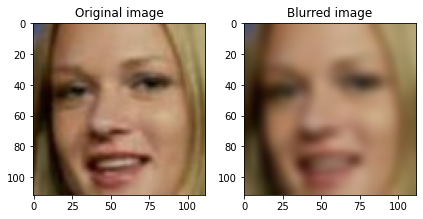

In [ ]:
img = train_dataset[0][0].unsqueeze(0).to(device)
img2 = train_dataset[0][1].unsqueeze(0).to(device)
# Plot the reconstructed image
fig, axs = plt.subplots(1, 2, figsize=(6,3))
axs[0].imshow(plotrescale(img2.cpu().squeeze().numpy()))
axs[0].set_title('Original image')
axs[1].imshow(plotrescale(img.cpu().squeeze().numpy()))
axs[1].set_title('Blurred image')
plt.tight_layout()
plt.show()

In [ ]:
class ConvAutoencoder(nn.Module):
    
    def __init__(self):
        super().__init__()
        
        ## Encoder
        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride=2, padding=1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride=2, padding=1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride=2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )
        
        ## Decoder
        # N, 64, 1, 1
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, 4, stride=2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )
        
    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x
    
### Training cycle function
def train_epoch(model, device, dataloader, loss_fn, optimizer):
    model.train()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    foo = tqdm(dataloader)
    for image_batch, label_batch in foo: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        label_batch = label_batch.to(device)
        # Encode-Decode data
        decoded_data = model(image_batch)
        ##
        #latent_img = model.encoder(image_batch)
        #latent_lab = model.encoder(label_batch)
        # Evaluate loss
        loss = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        foo.set_description('Train batch loss: %f' % (loss.data))

### Testing cycle function
def test_epoch(model, device, dataloader, loss_fn):
    model.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        val_loss = []
        for image_batch, label_batch in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            label_batch = label_batch.to(device)
            # Encode-Decode data
            decoded_data = model(image_batch)
            ##
            #latent_img = model.encoder(image_batch)
            #latent_lab = model.encoder(label_batch)
            # Batch loss
            loss_batch = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
            # Append the loss
            val_loss.append(loss_batch.detach().cpu().numpy())
    return np.mean(val_loss)

### Trainer
def run_training(model, num_epochs, train_dataloader, val_dataloader, optim, loss_fn, device):
    model.to(device)
    val_loss_log = []
    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))
        ### Training
        train_epoch(
            model=model,
            device=device, 
            dataloader=train_dataloader, 
            loss_fn=loss_fn, 
            optimizer=optim)
        ### Validation  (use the testing function)
        val_loss = test_epoch(
            model=model,
            device=device, 
            dataloader=val_dataloader, 
            loss_fn=loss_fn)
        # Print Validationloss
        print('\n\n\t VALIDATION - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs, val_loss))
        val_loss_log.append(val_loss)
        ### Plot progress
        # Get the output of a specific image (the test image at index 0 in this case)
        img = test_dataset[0][0].unsqueeze(0).to(device)
        lab = test_dataset[0][1].unsqueeze(0).to(device)
        model.eval()
        with torch.no_grad():
            rec_img  = model(img)
        # Plot the reconstructed image
        fig, axs = plt.subplots(1, 3, figsize=(9,3))
        axs[0].imshow(plotrescale(lab.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[0].set_title('Original image')
        axs[1].imshow(plotrescale(img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[1].set_title('Blurred image')
        axs[2].imshow(plotrescale(rec_img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[2].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
        plt.tight_layout()
        plt.pause(0.1)
        plt.show()
        plt.close()

        # Save network parameters
        torch.save(model.state_dict(), 'CAE/state_dict'+str(epoch)+'.pth')

    with open('CAE_validation_loss', 'wb') as fp:
        pickle.dump(val_loss_log, fp)

    return  val_loss_log

In [ ]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
ConvAut = ConvAutoencoder()

### Define the loss function
loss_fn = torch.nn.MSELoss()

### Define an optimizer 
params_to_optimize = [
    {'params': ConvAut.encoder.parameters()},
    {'params': ConvAut.decoder.parameters()}
]
optim = torch.optim.Adam(params_to_optimize, lr=5e-4, weight_decay=1e-5)

In [ ]:
# CAE_loss = run_training(ConvAut, 30, train_dataloader, test_dataloader, optim, loss_fn, device) # 8 iter

In [ ]:
class VAE(nn.Module):
    
    def __init__(self):
        super().__init__()
        
        ## Encoder
        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride=2, padding=1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride=2, padding=1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride=2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )
        
        ## Decoder
        # N, 64, 1, 1
        self.decoder = nn.Sequential(
            nn.Unflatten(dim = 1, unflattened_size = (64, 1, 1)),
            nn.ConvTranspose2d(64, 128, kernel_size = 3, stride = 1, padding = 0, output_padding = 0),
            nn.ReLU(), # N 128 3 3 
            nn.ConvTranspose2d(128, 256, kernel_size = 8, stride = 2, padding = 0, output_padding = 0),
            nn.ReLU(), # N 256 12 12

            nn.ConvTranspose2d(256, 256, 4, stride=2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )

        self.avg = nn.Sequential(
            # N 256 12 12
            nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            nn.ReLU(), # N 128 3 3
            nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            nn.Flatten(start_dim = 1)
        )

        self.log_var = nn.Sequential(
            nn.Conv2d(256, 128, kernel_size = 8, stride = 2, padding = 0),
            nn.ReLU(),
            nn.Conv2d(128, 64, kernel_size = 2, stride = 2, padding = 0),
            nn.ReLU(), # a questo punto è N * 64 * 1 * 1, cioè un flatten "naturale"
            nn.Flatten(start_dim = 1)
        )

    def sample_in_latent_space(self, mu, log_var): # sampling from MVN in latent space with provided mean and variances
        sigma = torch.exp(0.5 * log_var) #log_var is log(variance) = log(sigma**2) = 2 * log(sigma)
        return mu + torch.randn_like(mu) * sigma
        #Var(aX) = a**2 Var(X), so we need to multiply pred_sqrt_var = sigma (square root of the variance) by the standard normal distribution
        
    def forward(self, x):
        internal_repr  = self.encoder(x) # conv. part --> produces the internal representation
        pred_means     = self.avg(internal_repr) # linear part 1 --> predicts means
        pred_log_var   = self.log_var(internal_repr) # linear part 2 --> predicts variances
        sample         = self.sample_in_latent_space(mu = pred_means, log_var = pred_log_var) # sample in latent space
        decoded_sample = self.decoder(sample) # decoder --> produces final output
        
        return decoded_sample, pred_means, pred_log_var # we need to pass means and vars forward too, since they're needed to compute the KL div. term in the loss
    
### Training cycle function
def train_epoch(model, device, dataloader, loss_fn, optimizer):
    model.train()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    foo = tqdm(dataloader)
    for image_batch, label_batch in foo: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        label_batch = label_batch.to(device)
        # Encode-Decode data
        decoded_data, mu, log_var = model(image_batch)
        ##
        #latent_img = model.encoder(image_batch)
        #latent_lab = model.encoder(label_batch)
        # Evaluate loss
        loss = loss_fn(decoded_data, label_batch) - 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var)) #+ loss_fn(latent_img, latent_lab)
        loss /= len(image_batch)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        foo.set_description('Train batch loss: %f' % (loss.data))

### Testing cycle function
def test_epoch(model, device, dataloader, loss_fn):
    model.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        val_loss = []
        for image_batch, label_batch in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            label_batch = label_batch.to(device)
            # Encode-Decode data
            decoded_data, mu, log_var = model(image_batch)
            ##
            #latent_img = model.encoder(image_batch)
            #latent_lab = model.encoder(label_batch)
            # Batch loss
            loss_batch = nn.MSELoss()(decoded_data, label_batch)
            ## loss_batch = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
            # Append the loss
            val_loss.append(loss_batch.detach().cpu().numpy())
    return np.mean(val_loss)

### Trainer
def run_training(model, num_epochs, train_dataloader, val_dataloader, optim, loss_fn, device):
    model.to(device)
    val_loss_log = []
    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))
        ### Training
        train_epoch(
            model=model,
            device=device, 
            dataloader=train_dataloader, 
            loss_fn=loss_fn, 
            optimizer=optim)
        ### Validation  (use the testing function)
        val_loss = test_epoch(
            model=model,
            device=device, 
            dataloader=val_dataloader, 
            loss_fn=loss_fn)
        # Print Validationloss
        print('\n\n\t VALIDATION - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs, val_loss))
        val_loss_log.append(val_loss)
        ### Plot progress
        # Get the output of a specific image (the test image at index 0 in this case)
        img = test_dataset[0][0].unsqueeze(0).to(device)
        lab = test_dataset[0][1].unsqueeze(0).to(device)
        model.eval()
        with torch.no_grad():
            rec_img, mu, log_var  = model(img)
        # Plot the reconstructed image
        fig, axs = plt.subplots(1, 3, figsize=(9,3))
        axs[0].imshow(plotrescale(lab.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[0].set_title('Original image')
        axs[1].imshow(plotrescale(img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[1].set_title('Blurred image')
        axs[2].imshow(plotrescale(rec_img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[2].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
        plt.tight_layout()
        plt.pause(0.1)
        plt.show()
        plt.close()

        # Save network parameters
        torch.save(model.state_dict(), 'VAE/state_dict'+str(epoch)+'.pth')

    with open('CAE_validation_loss', 'wb') as fp:
        pickle.dump(val_loss_log, fp)

    return  val_loss_log

In [ ]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
model = VAE()

### Define the loss function
loss_fn = torch.nn.MSELoss(reduction = 'sum')

### Define an optimizer 
# params_to_optimize = [
#     {'params': ConvAut.encoder.parameters()},
#     {'params': ConvAut.decoder.parameters()}
# ]
params_to_optimize = model.parameters()
optim = torch.optim.Adam(params_to_optimize, lr=5e-4, weight_decay=1e-5)

In [ ]:
!mkdir VAE

mkdir: cannot create directory ‘VAE’: File exists


EPOCH 1/30


Train batch loss: 572.186340: 100%|██████████| 1191/1191 [01:15<00:00, 15.85it/s]




	 VALIDATION - EPOCH 1/30 - loss: 0.014639




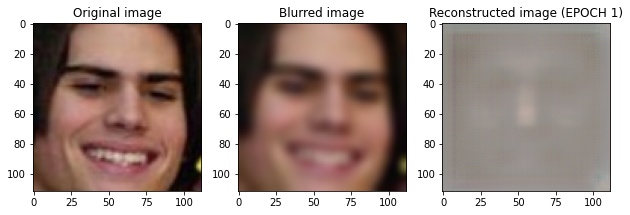

EPOCH 2/30


Train batch loss: 462.181549: 100%|██████████| 1191/1191 [01:16<00:00, 15.65it/s]




	 VALIDATION - EPOCH 2/30 - loss: 0.013300




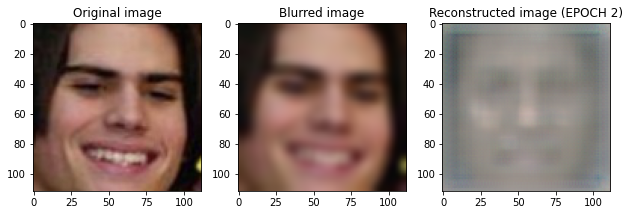

EPOCH 3/30


Train batch loss: 568.822449: 100%|██████████| 1191/1191 [01:16<00:00, 15.50it/s]




	 VALIDATION - EPOCH 3/30 - loss: 0.012962




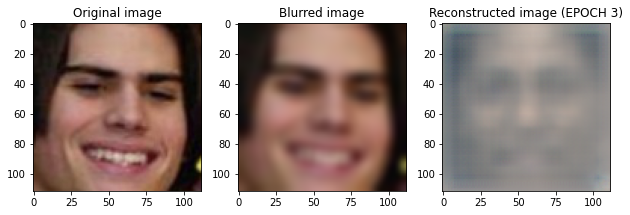

EPOCH 4/30


Train batch loss: 806.868530: 100%|██████████| 1191/1191 [01:17<00:00, 15.42it/s]




	 VALIDATION - EPOCH 4/30 - loss: 0.013052




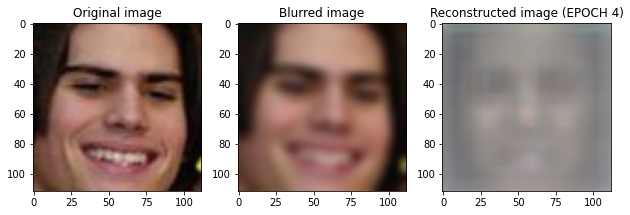

EPOCH 5/30


Train batch loss: 514.721680: 100%|██████████| 1191/1191 [01:17<00:00, 15.41it/s]




	 VALIDATION - EPOCH 5/30 - loss: 0.012104




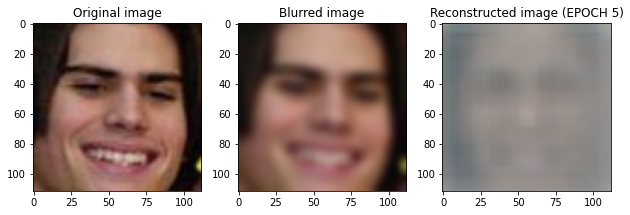

EPOCH 6/30


Train batch loss: 657.785217: 100%|██████████| 1191/1191 [01:17<00:00, 15.33it/s]




	 VALIDATION - EPOCH 6/30 - loss: 0.012045




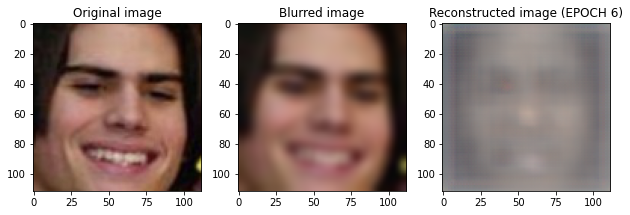

EPOCH 7/30


Train batch loss: 710.135498: 100%|██████████| 1191/1191 [01:18<00:00, 15.17it/s]




	 VALIDATION - EPOCH 7/30 - loss: 0.011742




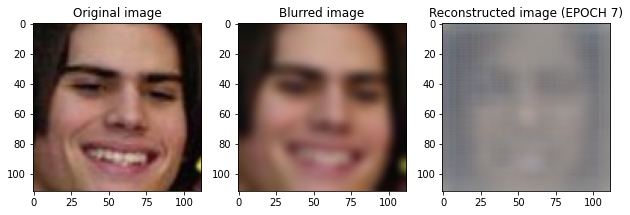

EPOCH 8/30


Train batch loss: 558.540894: 100%|██████████| 1191/1191 [01:17<00:00, 15.38it/s]




	 VALIDATION - EPOCH 8/30 - loss: 0.012468




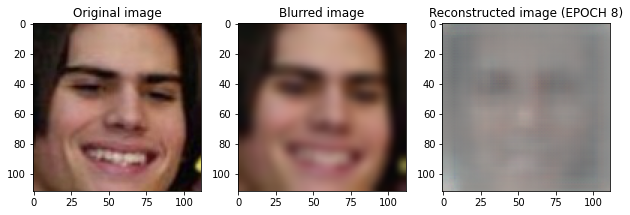

EPOCH 9/30


Train batch loss: 460.292297: 100%|██████████| 1191/1191 [01:16<00:00, 15.48it/s]




	 VALIDATION - EPOCH 9/30 - loss: 0.011684




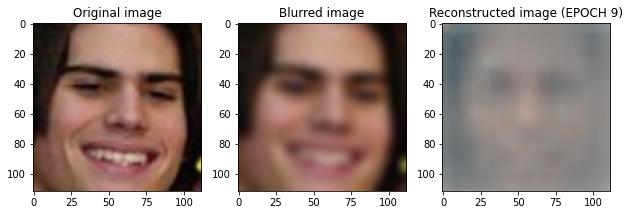

EPOCH 10/30


Train batch loss: 676.868774: 100%|██████████| 1191/1191 [01:17<00:00, 15.45it/s]




	 VALIDATION - EPOCH 10/30 - loss: 0.011620




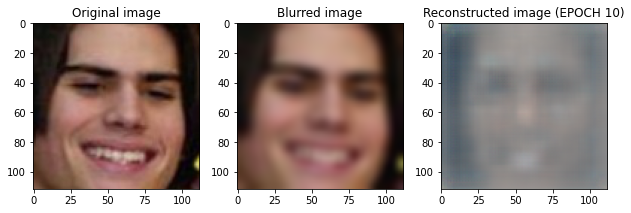

EPOCH 11/30


Train batch loss: 592.742188: 100%|██████████| 1191/1191 [01:17<00:00, 15.32it/s]




	 VALIDATION - EPOCH 11/30 - loss: 0.011271




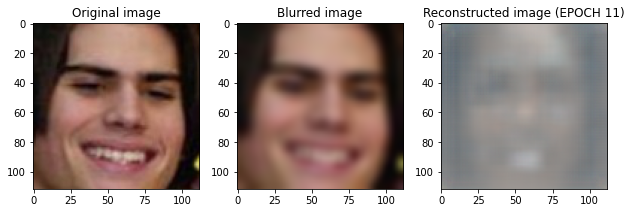

EPOCH 12/30


Train batch loss: 472.839172: 100%|██████████| 1191/1191 [01:17<00:00, 15.34it/s]




	 VALIDATION - EPOCH 12/30 - loss: 0.011236




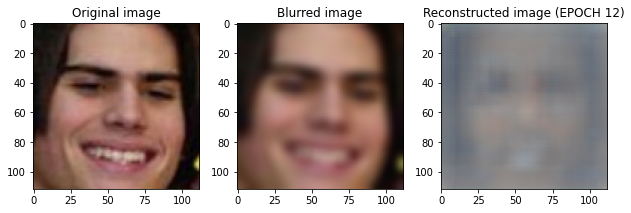

EPOCH 13/30


Train batch loss: 411.449463: 100%|██████████| 1191/1191 [01:17<00:00, 15.30it/s]




	 VALIDATION - EPOCH 13/30 - loss: 0.011058




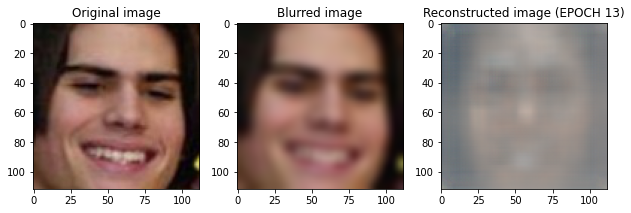

EPOCH 14/30


Train batch loss: 710.770691: 100%|██████████| 1191/1191 [01:18<00:00, 15.26it/s]




	 VALIDATION - EPOCH 14/30 - loss: 0.010835




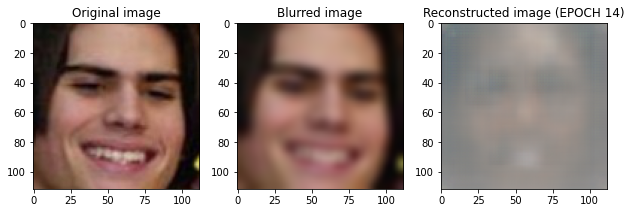

EPOCH 15/30


Train batch loss: 359.580963: 100%|██████████| 1191/1191 [01:19<00:00, 15.08it/s]




	 VALIDATION - EPOCH 15/30 - loss: 0.010695




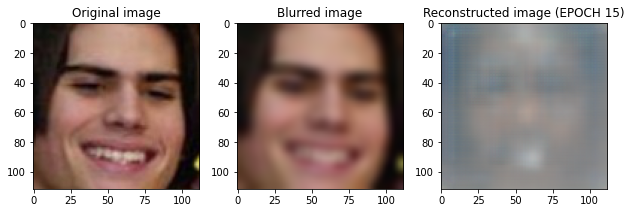

EPOCH 16/30


Train batch loss: 524.754089: 100%|██████████| 1191/1191 [01:19<00:00, 14.90it/s]




	 VALIDATION - EPOCH 16/30 - loss: 0.010384




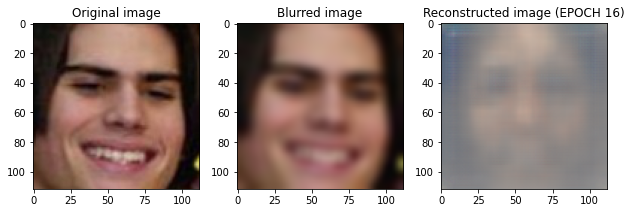

EPOCH 17/30


Train batch loss: 892.384583: 100%|██████████| 1191/1191 [01:19<00:00, 15.03it/s]




	 VALIDATION - EPOCH 17/30 - loss: 0.010626




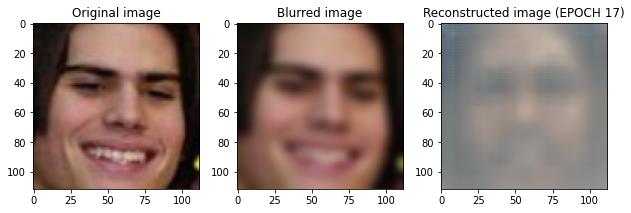

EPOCH 18/30


Train batch loss: 418.896881: 100%|██████████| 1191/1191 [01:20<00:00, 14.79it/s]




	 VALIDATION - EPOCH 18/30 - loss: 0.010558




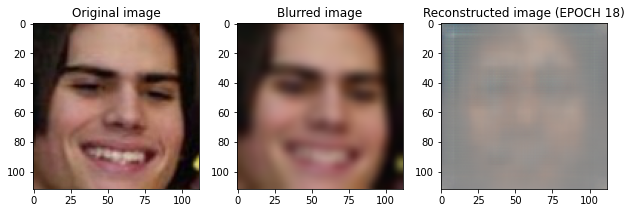

EPOCH 19/30


Train batch loss: 421.851715: 100%|██████████| 1191/1191 [01:20<00:00, 14.71it/s]




	 VALIDATION - EPOCH 19/30 - loss: 0.010527




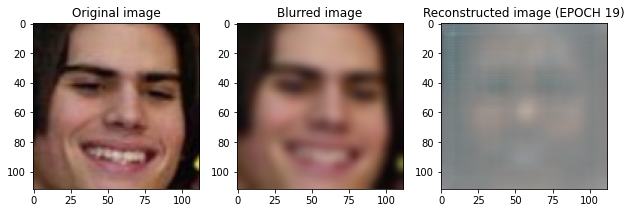

EPOCH 20/30


Train batch loss: 539.887451: 100%|██████████| 1191/1191 [01:21<00:00, 14.63it/s]




	 VALIDATION - EPOCH 20/30 - loss: 0.010205




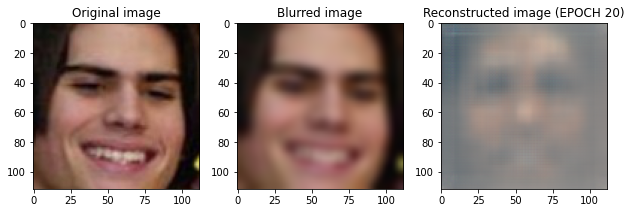

EPOCH 21/30


Train batch loss: 472.763336: 100%|██████████| 1191/1191 [01:21<00:00, 14.59it/s]




	 VALIDATION - EPOCH 21/30 - loss: 0.010325




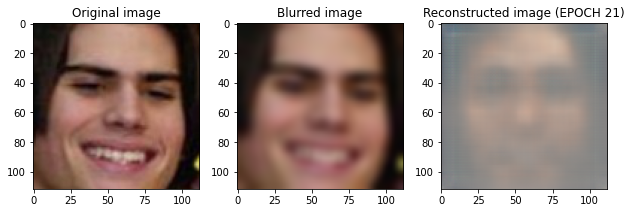

EPOCH 22/30


Train batch loss: 400.352386: 100%|██████████| 1191/1191 [01:21<00:00, 14.63it/s]




	 VALIDATION - EPOCH 22/30 - loss: 0.010435




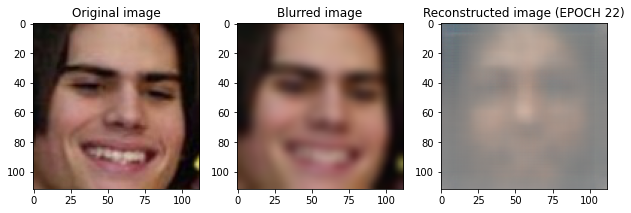

EPOCH 23/30


Train batch loss: 520.922363: 100%|██████████| 1191/1191 [01:21<00:00, 14.67it/s]




	 VALIDATION - EPOCH 23/30 - loss: 0.010293




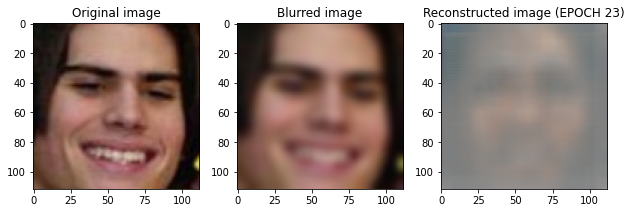

EPOCH 24/30


Train batch loss: 508.830566: 100%|██████████| 1191/1191 [01:21<00:00, 14.64it/s]




	 VALIDATION - EPOCH 24/30 - loss: 0.010111




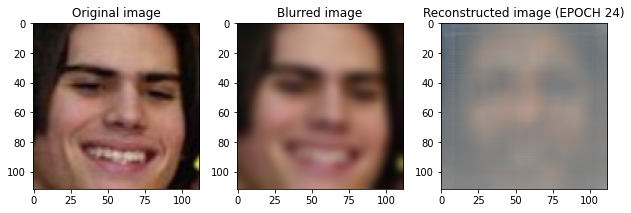

EPOCH 25/30


Train batch loss: 439.243805: 100%|██████████| 1191/1191 [01:22<00:00, 14.46it/s]




	 VALIDATION - EPOCH 25/30 - loss: 0.010126




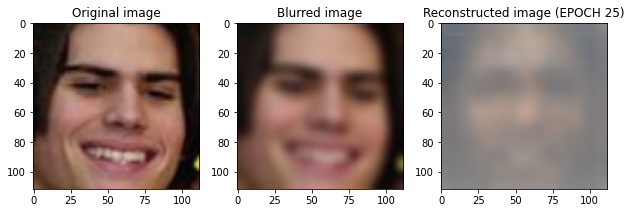

EPOCH 26/30


Train batch loss: 501.235413: 100%|██████████| 1191/1191 [01:22<00:00, 14.50it/s]




	 VALIDATION - EPOCH 26/30 - loss: 0.010459




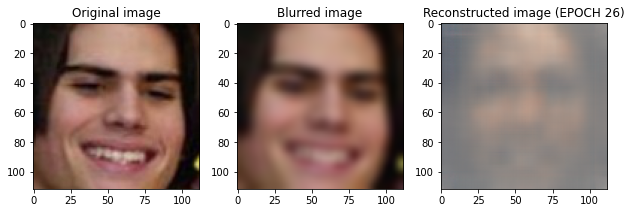

EPOCH 27/30


Train batch loss: 480.931213: 100%|██████████| 1191/1191 [01:22<00:00, 14.51it/s]




	 VALIDATION - EPOCH 27/30 - loss: 0.009931




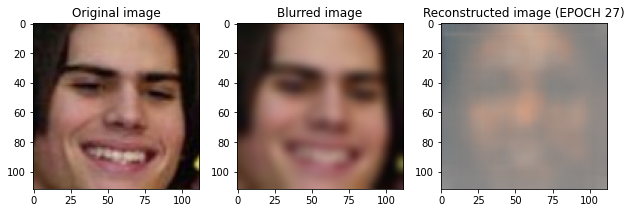

EPOCH 28/30


Train batch loss: 465.768066: 100%|██████████| 1191/1191 [01:21<00:00, 14.56it/s]




	 VALIDATION - EPOCH 28/30 - loss: 0.009989




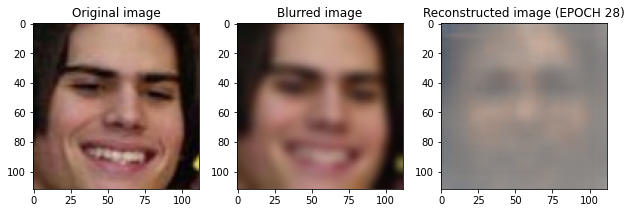

EPOCH 29/30


Train batch loss: 339.950775: 100%|██████████| 1191/1191 [01:22<00:00, 14.51it/s]




	 VALIDATION - EPOCH 29/30 - loss: 0.010068




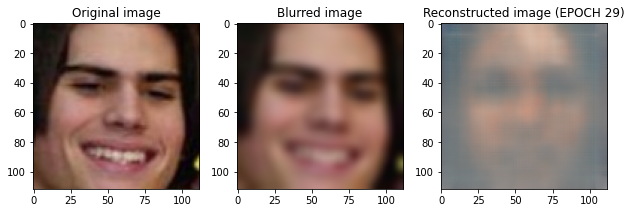

EPOCH 30/30


Train batch loss: 471.132416: 100%|██████████| 1191/1191 [01:21<00:00, 14.55it/s]




	 VALIDATION - EPOCH 30/30 - loss: 0.010431




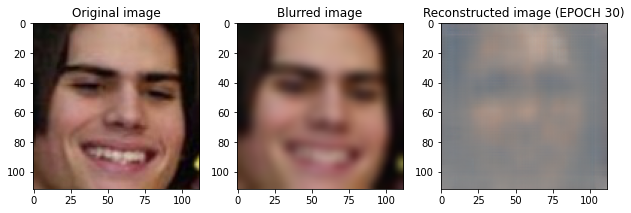

In [ ]:
VAE_loss = run_training(model, 30, train_dataloader, test_dataloader, optim, loss_fn, device)

In [ ]:
!zip -r VAE.zip VAE

  adding: VAE/ (stored 0%)
  adding: VAE/state_dict27.pth (deflated 8%)
  adding: VAE/state_dict24.pth (deflated 8%)
  adding: VAE/state_dict11.pth (deflated 7%)
  adding: VAE/state_dict7.pth (deflated 7%)
  adding: VAE/state_dict18.pth (deflated 6%)
  adding: VAE/state_dict17.pth (deflated 6%)
  adding: VAE/state_dict22.pth (deflated 7%)
  adding: VAE/state_dict3.pth (deflated 7%)
  adding: VAE/state_dict23.pth (deflated 8%)
  adding: VAE/state_dict25.pth (deflated 8%)
  adding: VAE/state_dict6.pth (deflated 7%)
  adding: VAE/state_dict0.pth (deflated 7%)
  adding: VAE/state_dict12.pth (deflated 6%)
  adding: VAE/state_dict16.pth (deflated 6%)
  adding: VAE/state_dict20.pth (deflated 7%)
  adding: VAE/state_dict5.pth (deflated 7%)
  adding: VAE/state_dict15.pth (deflated 6%)
  adding: VAE/state_dict29.pth (deflated 9%)
  adding: VAE/state_dict8.pth (deflated 7%)
  adding: VAE/state_dict28.pth (deflated 8%)
  adding: VAE/state_dict2.pth (deflated 7%)
  adding: VAE/state_dict21.pth (def

## No reg

In [ ]:
### Training cycle function
def train_epoch(model, device, dataloader, loss_fn, optimizer):
    model.train()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    foo = tqdm(dataloader)
    for image_batch, label_batch in foo: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        label_batch = label_batch.to(device)
        # Encode-Decode data
        decoded_data, mu, log_var = model(image_batch)
        ##
        #latent_img = model.encoder(image_batch)
        #latent_lab = model.encoder(label_batch)
        # Evaluate loss
        loss = loss_fn(decoded_data, label_batch) # - 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var)) #+ loss_fn(latent_img, latent_lab)
        loss /= len(image_batch)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        foo.set_description('Train batch loss: %f' % (loss.data))

### Testing cycle function
def test_epoch(model, device, dataloader, loss_fn):
    model.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        val_loss = []
        for image_batch, label_batch in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            label_batch = label_batch.to(device)
            # Encode-Decode data
            decoded_data, mu, log_var = model(image_batch)
            ##
            #latent_img = model.encoder(image_batch)
            #latent_lab = model.encoder(label_batch)
            # Batch loss
            loss_batch = nn.MSELoss()(decoded_data, label_batch)
            ## loss_batch = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
            # Append the loss
            val_loss.append(loss_batch.detach().cpu().numpy())
    return np.mean(val_loss)

### Trainer
def run_training(model, num_epochs, train_dataloader, val_dataloader, optim, loss_fn, device):
    model.to(device)
    val_loss_log = []
    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))
        ### Training
        train_epoch(
            model=model,
            device=device, 
            dataloader=train_dataloader, 
            loss_fn=loss_fn, 
            optimizer=optim)
        ### Validation  (use the testing function)
        val_loss = test_epoch(
            model=model,
            device=device, 
            dataloader=val_dataloader, 
            loss_fn=loss_fn)
        # Print Validationloss
        print('\n\n\t VALIDATION - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs, val_loss))
        val_loss_log.append(val_loss)
        ### Plot progress
        # Get the output of a specific image (the test image at index 0 in this case)
        img = test_dataset[0][0].unsqueeze(0).to(device)
        lab = test_dataset[0][1].unsqueeze(0).to(device)
        model.eval()
        with torch.no_grad():
            rec_img, mu, log_var  = model(img)
        # Plot the reconstructed image
        fig, axs = plt.subplots(1, 3, figsize=(9,3))
        axs[0].imshow(plotrescale(lab.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[0].set_title('Original image')
        axs[1].imshow(plotrescale(img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[1].set_title('Blurred image')
        axs[2].imshow(plotrescale(rec_img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[2].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
        plt.tight_layout()
        plt.pause(0.1)
        plt.show()
        plt.close()

        # Save network parameters
        torch.save(model.state_dict(), 'VAE_noreg/state_dict'+str(epoch)+'.pth')

    with open('VAE_validation_loss', 'wb') as fp:
        pickle.dump(val_loss_log, fp)

    return  val_loss_log

In [ ]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
model_noreg = VAE()

### Define the loss function
loss_fn = torch.nn.MSELoss()

### Define an optimizer 
# params_to_optimize = [
#     {'params': ConvAut.encoder.parameters()},
#     {'params': ConvAut.decoder.parameters()}
# ]
params_to_optimize = model_noreg.parameters()
optim = torch.optim.Adam(params_to_optimize, lr=5e-4, weight_decay=1e-5)

In [ ]:
!mkdir VAE_noreg

EPOCH 1/30


Train batch loss: nan: 100%|██████████| 1191/1191 [01:13<00:00, 16.10it/s]




	 VALIDATION - EPOCH 1/30 - loss: nan




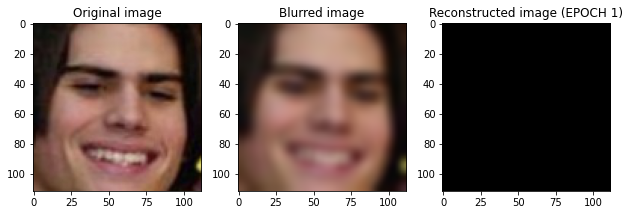

EPOCH 2/30


Train batch loss: nan: 100%|██████████| 1191/1191 [01:14<00:00, 16.02it/s]




	 VALIDATION - EPOCH 2/30 - loss: nan




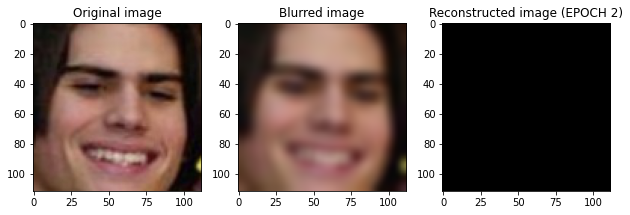

EPOCH 3/30


Train batch loss: nan:   2%|▏         | 24/1191 [00:01<01:14, 15.59it/s]


KeyboardInterrupt: ignored

In [ ]:
VAE_noreg_loss = run_training(model_noreg, 30, train_dataloader, test_dataloader, optim, loss_fn, device)

## Poca reg

In [ ]:
ALPHA = 1e-7 #0.1 1e-6

### Training cycle function
def train_epoch(model, device, dataloader, loss_fn, optimizer):
    model.train()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    foo = tqdm(dataloader)
    for image_batch, label_batch in foo: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        label_batch = label_batch.to(device)
        # Encode-Decode data
        decoded_data, mu, log_var = model(image_batch)
        ##
        #latent_img = model.encoder(image_batch)
        #latent_lab = model.encoder(label_batch)
        # Evaluate loss
        loss = loss_fn(decoded_data, label_batch) - ALPHA * 0.5 * torch.sum(1. + log_var - mu**2 - torch.exp(log_var)) #+ loss_fn(latent_img, latent_lab)
        loss /= len(image_batch)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        foo.set_description('Train batch loss: %f' % (loss.data))

### Testing cycle function
def test_epoch(model, device, dataloader, loss_fn):
    model.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        val_loss = []
        for image_batch, label_batch in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            label_batch = label_batch.to(device)
            # Encode-Decode data
            decoded_data, mu, log_var = model(image_batch)
            ##
            #latent_img = model.encoder(image_batch)
            #latent_lab = model.encoder(label_batch)
            # Batch loss
            loss_batch = nn.MSELoss()(decoded_data, label_batch)
            ## loss_batch = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
            # Append the loss
            val_loss.append(loss_batch.detach().cpu().numpy())
    return np.mean(val_loss)

### Trainer
def run_training(model, num_epochs, train_dataloader, val_dataloader, optim, loss_fn, device):
    model.to(device)
    val_loss_log = []
    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))
        ### Training
        train_epoch(
            model=model,
            device=device, 
            dataloader=train_dataloader, 
            loss_fn=loss_fn, 
            optimizer=optim)
        ### Validation  (use the testing function)
        val_loss = test_epoch(
            model=model,
            device=device, 
            dataloader=val_dataloader, 
            loss_fn=loss_fn)
        # Print Validationloss
        print('\n\n\t VALIDATION - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs, val_loss))
        val_loss_log.append(val_loss)
        ### Plot progress
        # Get the output of a specific image (the test image at index 0 in this case)
        img = test_dataset[0][0].unsqueeze(0).to(device)
        lab = test_dataset[0][1].unsqueeze(0).to(device)
        model.eval()
        with torch.no_grad():
            rec_img, mu, log_var  = model(img)
        # Plot the reconstructed image
        fig, axs = plt.subplots(1, 3, figsize=(9,3))
        axs[0].imshow(plotrescale(lab.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[0].set_title('Original image')
        axs[1].imshow(plotrescale(img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[1].set_title('Blurred image')
        axs[2].imshow(plotrescale(rec_img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[2].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
        plt.tight_layout()
        plt.pause(0.1)
        plt.show()
        plt.close()

        # Save network parameters
        torch.save(model.state_dict(), 'VAE_p/state_dict'+str(epoch)+'.pth')

    with open('VAE_validation_loss', 'wb') as fp:
        pickle.dump(val_loss_log, fp)

    return  val_loss_log

In [ ]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
model_p = VAE()

### Define the loss function
loss_fn = torch.nn.MSELoss(reduction = 'sum')

### Define an optimizer 
# params_to_optimize = [
#     {'params': ConvAut.encoder.parameters()},
#     {'params': ConvAut.decoder.parameters()}
# ]
params_to_optimize = model_p.parameters()
optim = torch.optim.Adam(params_to_optimize, lr=5e-4 , weight_decay=1e-5) #

In [ ]:
!mkdir VAE_p

EPOCH 1/30


Train batch loss: 2728.985107: 100%|██████████| 1191/1191 [01:42<00:00, 11.65it/s]




	 VALIDATION - EPOCH 1/30 - loss: 0.078192




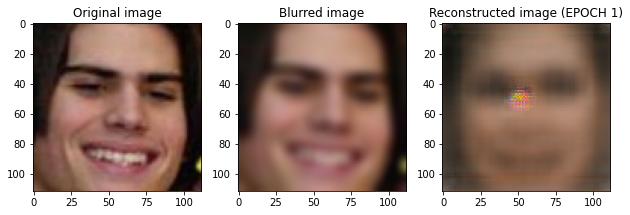

EPOCH 2/30


Train batch loss: 4040.888672: 100%|██████████| 1191/1191 [01:42<00:00, 11.62it/s]




	 VALIDATION - EPOCH 2/30 - loss: 0.060737




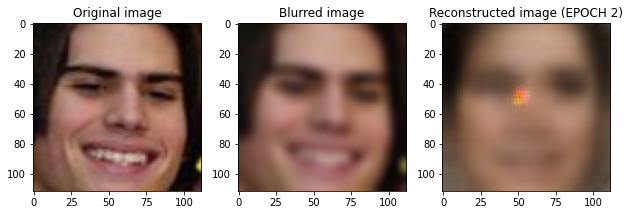

EPOCH 3/30


Train batch loss: 1765.093140: 100%|██████████| 1191/1191 [01:46<00:00, 11.19it/s]




	 VALIDATION - EPOCH 3/30 - loss: 0.055425




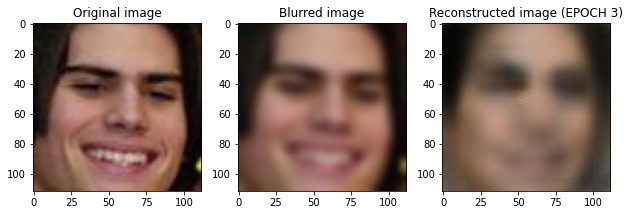

EPOCH 4/30


Train batch loss: 1995.571899: 100%|██████████| 1191/1191 [01:46<00:00, 11.16it/s]




	 VALIDATION - EPOCH 4/30 - loss: 0.050700




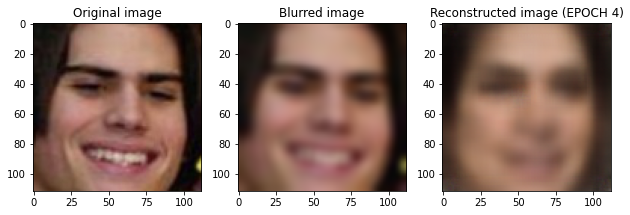

EPOCH 5/30


Train batch loss: 1800.161499: 100%|██████████| 1191/1191 [01:46<00:00, 11.14it/s]




	 VALIDATION - EPOCH 5/30 - loss: 0.048190




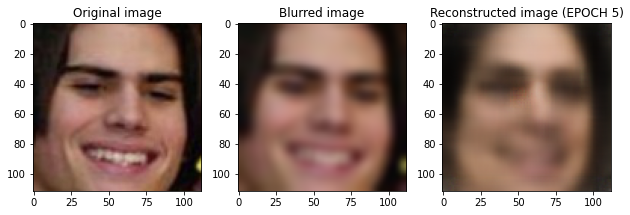

EPOCH 6/30


Train batch loss: 2201.829834: 100%|██████████| 1191/1191 [01:48<00:00, 10.99it/s]




	 VALIDATION - EPOCH 6/30 - loss: 0.046580




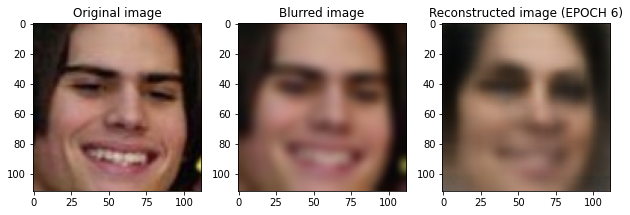

EPOCH 7/30


Train batch loss: 2689.098633: 100%|██████████| 1191/1191 [01:50<00:00, 10.76it/s]




	 VALIDATION - EPOCH 7/30 - loss: 0.043185




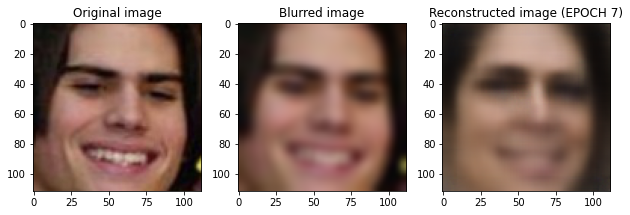

EPOCH 8/30


Train batch loss: 1639.810913: 100%|██████████| 1191/1191 [01:50<00:00, 10.75it/s]




	 VALIDATION - EPOCH 8/30 - loss: 0.041103




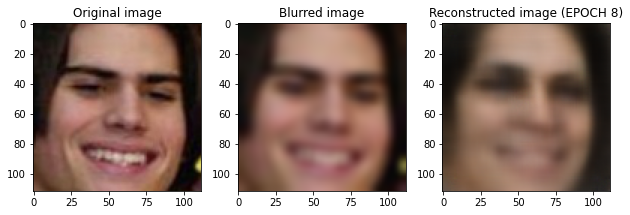

EPOCH 9/30


Train batch loss: 1436.032593: 100%|██████████| 1191/1191 [01:50<00:00, 10.75it/s]




	 VALIDATION - EPOCH 9/30 - loss: 0.040679




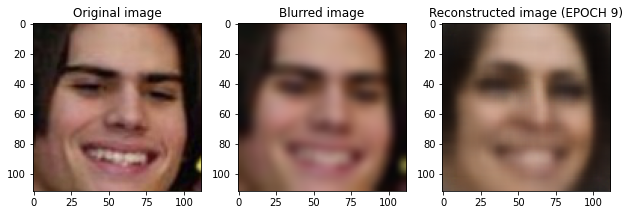

EPOCH 10/30


Train batch loss: 1856.039307: 100%|██████████| 1191/1191 [01:51<00:00, 10.72it/s]




	 VALIDATION - EPOCH 10/30 - loss: 0.042771




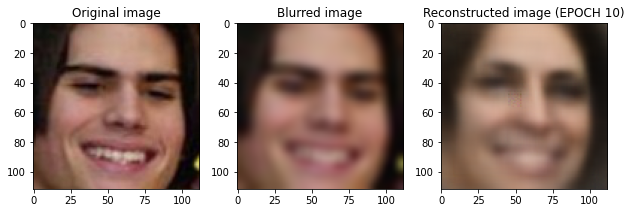

EPOCH 11/30


Train batch loss: 1817.141968: 100%|██████████| 1191/1191 [01:52<00:00, 10.62it/s]




	 VALIDATION - EPOCH 11/30 - loss: 0.040458




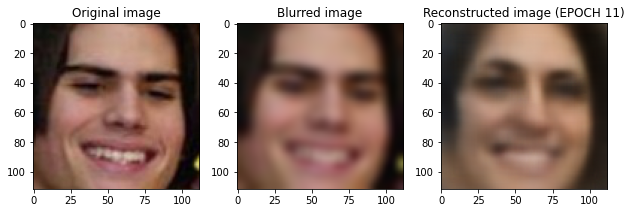

EPOCH 12/30


Train batch loss: 1539.611938: 100%|██████████| 1191/1191 [01:52<00:00, 10.60it/s]




	 VALIDATION - EPOCH 12/30 - loss: 0.037500




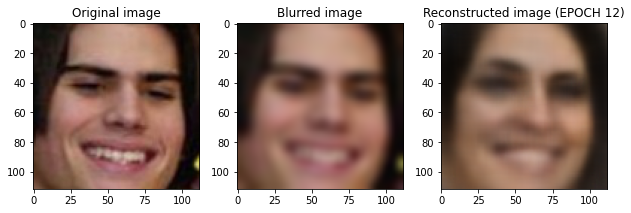

EPOCH 13/30


Train batch loss: 1494.275757: 100%|██████████| 1191/1191 [01:52<00:00, 10.56it/s]




	 VALIDATION - EPOCH 13/30 - loss: 0.038279




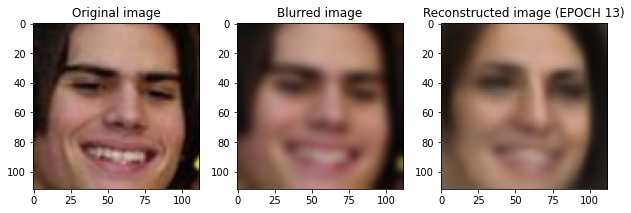

EPOCH 14/30


Train batch loss: 1204.547729: 100%|██████████| 1191/1191 [01:53<00:00, 10.54it/s]




	 VALIDATION - EPOCH 14/30 - loss: 0.036674




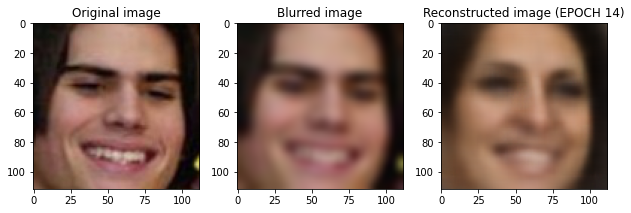

EPOCH 15/30


Train batch loss: 1514.069702: 100%|██████████| 1191/1191 [01:53<00:00, 10.47it/s]




	 VALIDATION - EPOCH 15/30 - loss: 0.037242




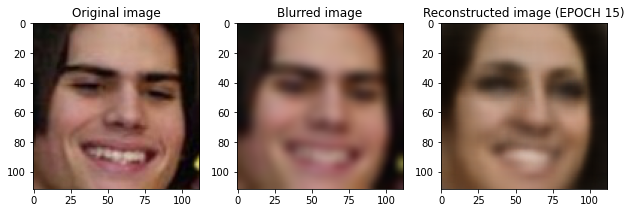

EPOCH 16/30


Train batch loss: 1404.005737: 100%|██████████| 1191/1191 [01:54<00:00, 10.44it/s]




	 VALIDATION - EPOCH 16/30 - loss: 0.036478




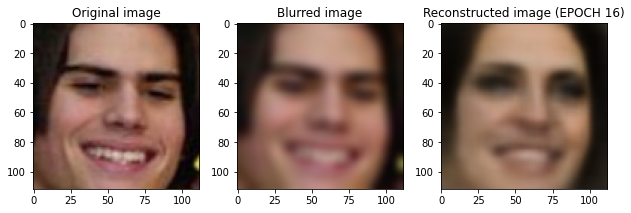

EPOCH 17/30


Train batch loss: 1370.046631: 100%|██████████| 1191/1191 [02:00<00:00,  9.92it/s]




	 VALIDATION - EPOCH 17/30 - loss: 0.036633




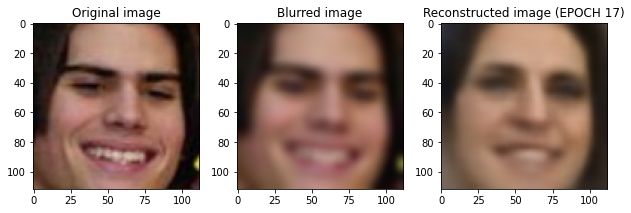

EPOCH 18/30


Train batch loss: 1376.915405: 100%|██████████| 1191/1191 [02:00<00:00,  9.89it/s]




	 VALIDATION - EPOCH 18/30 - loss: 0.035209




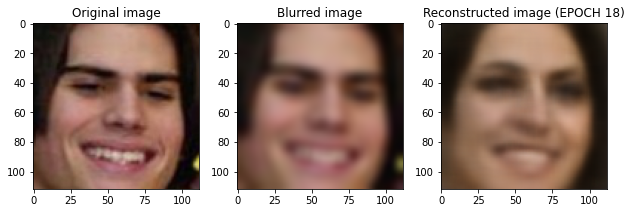

EPOCH 19/30


Train batch loss: 1367.488892: 100%|██████████| 1191/1191 [02:03<00:00,  9.67it/s]




	 VALIDATION - EPOCH 19/30 - loss: 0.035235




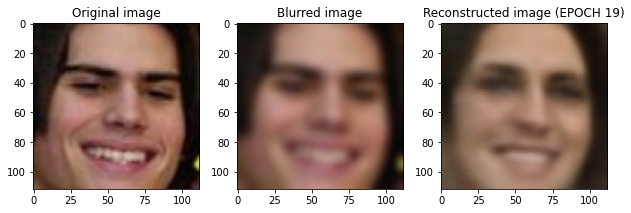

EPOCH 20/30


Train batch loss: 1216.678589: 100%|██████████| 1191/1191 [02:02<00:00,  9.76it/s]




	 VALIDATION - EPOCH 20/30 - loss: 0.035957




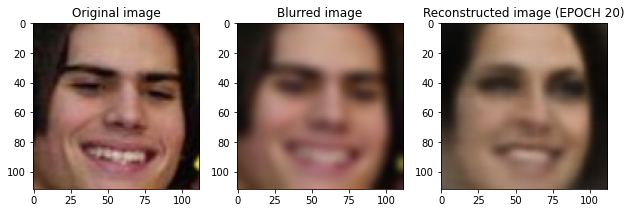

EPOCH 21/30


Train batch loss: 1361.435303: 100%|██████████| 1191/1191 [02:03<00:00,  9.66it/s]




	 VALIDATION - EPOCH 21/30 - loss: 0.034187




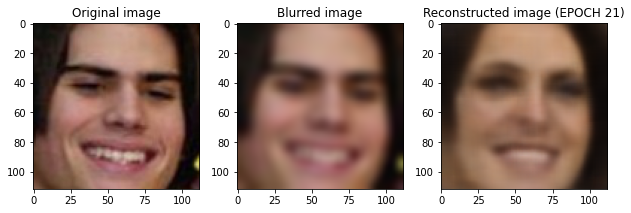

EPOCH 22/30


Train batch loss: 1254.146118: 100%|██████████| 1191/1191 [02:05<00:00,  9.47it/s]




	 VALIDATION - EPOCH 22/30 - loss: 0.034333




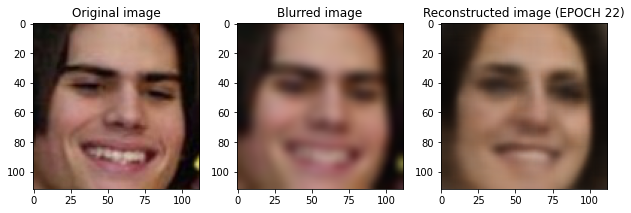

EPOCH 23/30


Train batch loss: 1630.657715: 100%|██████████| 1191/1191 [02:05<00:00,  9.49it/s]




	 VALIDATION - EPOCH 23/30 - loss: 0.032912




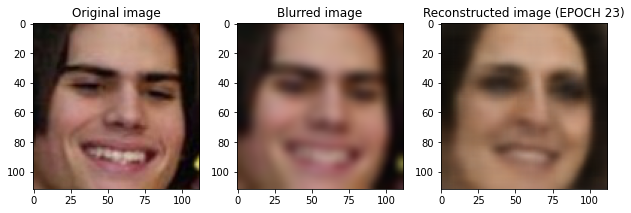

EPOCH 24/30


Train batch loss: 1188.498901: 100%|██████████| 1191/1191 [02:10<00:00,  9.15it/s]




	 VALIDATION - EPOCH 24/30 - loss: 0.033257




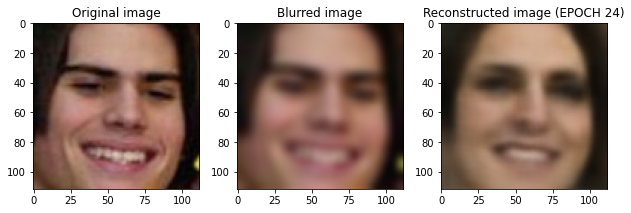

EPOCH 25/30


Train batch loss: 1314.093506: 100%|██████████| 1191/1191 [02:09<00:00,  9.18it/s]




	 VALIDATION - EPOCH 25/30 - loss: 0.035291




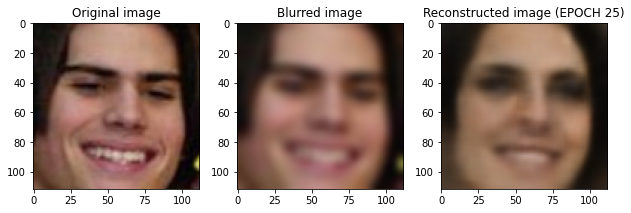

EPOCH 26/30


Train batch loss: 1619.026001: 100%|██████████| 1191/1191 [02:10<00:00,  9.15it/s]




	 VALIDATION - EPOCH 26/30 - loss: 0.033097




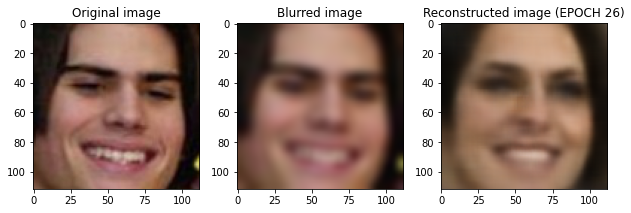

EPOCH 27/30


Train batch loss: 1446.830933: 100%|██████████| 1191/1191 [02:08<00:00,  9.27it/s]




	 VALIDATION - EPOCH 27/30 - loss: 0.032801




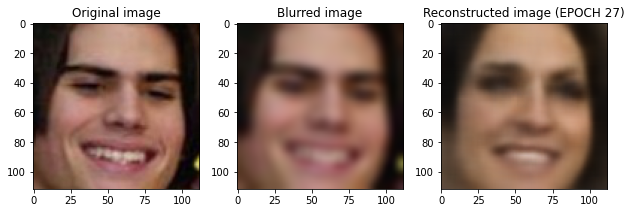

EPOCH 28/30


Train batch loss: 1206.988892: 100%|██████████| 1191/1191 [02:07<00:00,  9.36it/s]




	 VALIDATION - EPOCH 28/30 - loss: 0.032728




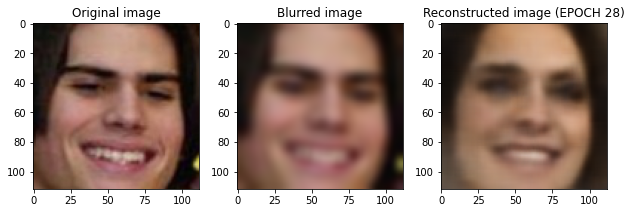

EPOCH 29/30


Train batch loss: 1212.479370: 100%|██████████| 1191/1191 [02:06<00:00,  9.38it/s]




	 VALIDATION - EPOCH 29/30 - loss: 0.033087




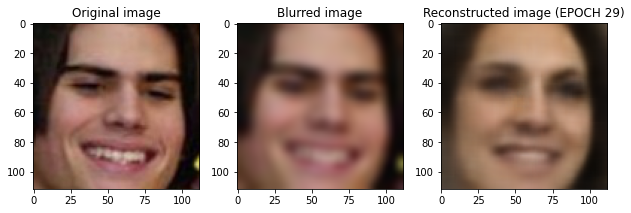

EPOCH 30/30


Train batch loss: 1117.293091: 100%|██████████| 1191/1191 [02:07<00:00,  9.37it/s]




	 VALIDATION - EPOCH 30/30 - loss: 0.032293




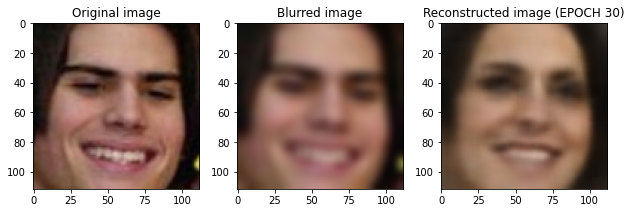

In [ ]:
VAE_p_loss = run_training(model_p, 30, train_dataloader, test_dataloader, optim, loss_fn, device)

In [ ]:
!zip -r VAE_p.zip VAE_p

  adding: VAE_p/ (stored 0%)
  adding: VAE_p/state_dict27.pth (deflated 7%)
  adding: VAE_p/state_dict24.pth (deflated 7%)
  adding: VAE_p/state_dict11.pth (deflated 7%)
  adding: VAE_p/state_dict7.pth (deflated 7%)
  adding: VAE_p/state_dict18.pth (deflated 7%)
  adding: VAE_p/state_dict17.pth (deflated 7%)
  adding: VAE_p/state_dict22.pth (deflated 7%)
  adding: VAE_p/state_dict3.pth (deflated 7%)
  adding: VAE_p/state_dict23.pth (deflated 7%)
  adding: VAE_p/state_dict25.pth (deflated 7%)
  adding: VAE_p/state_dict6.pth (deflated 7%)
  adding: VAE_p/state_dict0.pth (deflated 8%)
  adding: VAE_p/state_dict12.pth (deflated 7%)
  adding: VAE_p/state_dict16.pth (deflated 7%)
  adding: VAE_p/state_dict20.pth (deflated 7%)
  adding: VAE_p/state_dict5.pth (deflated 7%)
  adding: VAE_p/state_dict15.pth (deflated 7%)
  adding: VAE_p/state_dict29.pth (deflated 7%)
  adding: VAE_p/state_dict8.pth (deflated 7%)
  adding: VAE_p/state_dict28.pth (deflated 7%)
  adding: VAE_p/state_dict2.pth (defl

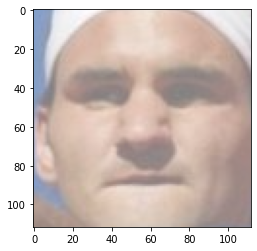

In [ ]:
a, b = train_dataset_red[0]
plt.imshow((a * 0.5 + 0.5).cpu().numpy().transpose([1, 2, 0]))

In [ ]:
l = len(train_dataset_red)
v = np.zeros(l)

model_p.eval()
f = torch.nn.MSELoss()

for i in range(l):
    orig_img, noisy_img = train_dataset_red[i]
    orig_img, noisy_img = orig_img.unsqueeze(0), noisy_img.unsqueeze(0)
    
    v[i] = f(orig_img, model_p(noisy_img)[0]) # model restituisce anche mu e log var

In [ ]:
print(v.min(), v.argmin())

0.002828720025718212 4757


In [ ]:
vs = np.sort(v)
qs = np.argsort(v)
print(vs[:10])
print(qs[:10])

[0.00282872 0.00314232 0.00335249 0.00340838 0.00343317 0.00346653
 0.0034968  0.00350127 0.00354126 0.00362339]
[4757  201 6656 4322 2161 5184  600 4241 1087 5439]


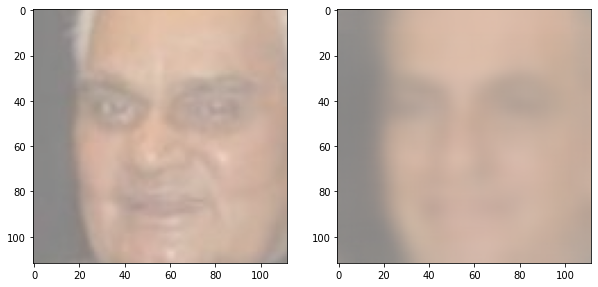

In [ ]:
a, b = train_dataset_red[qs[8]]
model_p.eval()
c = (model_p(b.unsqueeze(0))[0]).squeeze(0).detach()

fig, ax = plt.subplots(nrows = 1, ncols = 2, figsize = (10, 5))
ax[0].imshow((a * 0.5 + 0.5).cpu().numpy().transpose([1, 2, 0]))
ax[1].imshow((c * 0.5 + 0.5).cpu().numpy().transpose([1, 2, 0]))

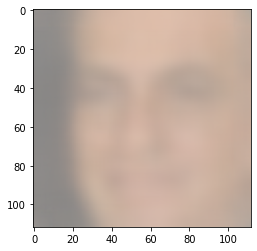

In [ ]:
plt.imshow(plotrescale(c.cpu()))

## Luca pixelated no vae

In [ ]:
# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

Selected device: cuda


In [ ]:
class AutoEncodeDataset(Dataset):
    """"""

    def __init__(self, dataset_gt, dataset_blur):
        self.dataset_gt = dataset_gt
        self.dataset_blur = dataset_blur

    def __len__(self):
        return len(self.dataset_gt)

    def __getitem__(self, idx):
        x, _ = self.dataset_blur.__getitem__(idx)
        y, _ = self.dataset_gt.__getitem__(idx)
        return x, y

In [ ]:
def pixelate(img, n_squares = 14, sides_squares = 8):
    x = np.asarray(img) # img è PIL..., non un array
    y = np.empty((n_squares, n_squares, 3))

    for j in range(n_squares): # y img
        for i in range(n_squares): # x img
            for k in range(3): # rgb channel
                y[i, j, k] = x[sides_squares*i:sides_squares*(i+1), sides_squares*j:sides_squares*(j+1), k].mean()
                
    return Image.fromarray(np.uint8(y)).resize(img.size, Image.NEAREST)

In [ ]:
initial_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.CenterCrop(112),
    transforms.Normalize(0.5,0.5)])

pixel_transform = transforms.Compose([
    transforms.CenterCrop(112),
    pixelate,
    transforms.ToTensor(),
    transforms.Normalize(0.5,0.5)])

In [ ]:
data_dir = './lfw_torch/'

train_dataset = AutoEncodeDataset(
    torchvision.datasets.LFWPeople(data_dir, split='train', download=True, transform=initial_transform),
    torchvision.datasets.LFWPeople(data_dir, split='train', download=True, transform=pixel_transform)
)

test_dataset = AutoEncodeDataset(
    torchvision.datasets.LFWPeople(data_dir, split='test', download=True, transform=initial_transform),
    torchvision.datasets.LFWPeople(data_dir, split='test', download=True, transform=pixel_transform)
)

  0%|          | 0/243346528 [00:00<?, ?it/s]

Extracting ./lfw_torch/lfw-py/lfw-funneled.tgz to ./lfw_torch/lfw-py


  0%|          | 0/66403 [00:00<?, ?it/s]

  0%|          | 0/94727 [00:00<?, ?it/s]

Files already downloaded and verified
Using downloaded and verified file: ./lfw_torch/lfw-py/lfw-funneled.tgz
Extracting ./lfw_torch/lfw-py/lfw-funneled.tgz to ./lfw_torch/lfw-py


  0%|          | 0/28334 [00:00<?, ?it/s]

Using downloaded and verified file: ./lfw_torch/lfw-py/lfw-names.txt
Files already downloaded and verified


In [ ]:
def plotrescale(data):
    return np.dstack(data)*0.5 + 0.5

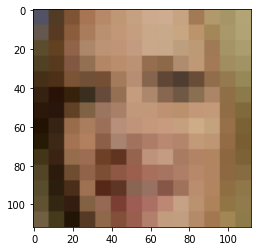

In [ ]:
plt.imshow(plotrescale(train_dataset[0][0]))

In [ ]:
batch_size = 8

N_val = int(len(train_dataset)*0.2)
train_dataset_red, val_dataset = random_split(train_dataset, 
                                 lengths=[len(train_dataset)-N_val, N_val], 
                                 generator=torch.Generator().manual_seed(42))
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0,)
train_dataloader_red = DataLoader(train_dataset_red, batch_size=batch_size, shuffle=True, num_workers=0)
val_dataloader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
test_dataloader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=0)

In [ ]:
class ConvAutoencoder(nn.Module):
    
    def __init__(self):
        super().__init__()
        
        ## Encoder
        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride=2, padding=1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride=2, padding=1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride=2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )
        
        ## Decoder
        # N, 64, 1, 1
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, 4, stride=2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )
        
    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x
    
### Training cycle function
def train_epoch(model, device, dataloader, loss_fn, optimizer):
    model.train()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    foo = tqdm(dataloader)
    for image_batch, label_batch in foo: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        label_batch = label_batch.to(device)
        # Encode-Decode data
        decoded_data = model(image_batch)
        ##
        #latent_img = model.encoder(image_batch)
        #latent_lab = model.encoder(label_batch)
        # Evaluate loss
        loss = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        foo.set_description('Train batch loss: %f' % (loss.data))

### Testing cycle function
def test_epoch(model, device, dataloader, loss_fn):
    model.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        val_loss = []
        for image_batch, label_batch in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            label_batch = label_batch.to(device)
            # Encode-Decode data
            decoded_data = model(image_batch)
            ##
            #latent_img = model.encoder(image_batch)
            #latent_lab = model.encoder(label_batch)
            # Batch loss
            loss_batch = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
            # Append the loss
            val_loss.append(loss_batch.detach().cpu().numpy())
    return np.mean(val_loss)

### Trainer
def run_training(model, num_epochs, train_dataloader, val_dataloader, optim, loss_fn, device, save_folder):
    model.to(device)
    val_loss_log = []
    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))
        ### Training
        train_epoch(
            model=model,
            device=device, 
            dataloader=train_dataloader, 
            loss_fn=loss_fn, 
            optimizer=optim)
        ### Validation  (use the testing function)
        val_loss = test_epoch(
            model=model,
            device=device, 
            dataloader=val_dataloader, 
            loss_fn=loss_fn)
        # Print Validationloss
        print('\n\n\t VALIDATION - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs, val_loss))
        val_loss_log.append(val_loss)
        ### Plot progress
        # Get the output of a specific image (the test image at index 0 in this case)
        img = test_dataset[0][0].unsqueeze(0).to(device)
        lab = test_dataset[0][1].unsqueeze(0).to(device)
        model.eval()
        with torch.no_grad():
            rec_img  = model(img)
        # Plot the reconstructed image
        fig, axs = plt.subplots(1, 3, figsize=(9,3))
        axs[0].imshow(plotrescale(lab.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[0].set_title('Original image')
        axs[1].imshow(plotrescale(img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[1].set_title('Pixelated image')
        axs[2].imshow(plotrescale(rec_img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[2].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
        plt.tight_layout()
        plt.pause(0.1)
        plt.show()
        plt.close()

        # Save network parameters
        torch.save(model.state_dict(), f'{save_folder}/state_dict'+str(epoch)+'.pth')

    with open(f'{save_folder}_validation_loss', 'wb') as fp:
        pickle.dump(val_loss_log, fp)

    return  val_loss_log

In [ ]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
ConvAut = ConvAutoencoder()

### Define the loss function
loss_fn = torch.nn.MSELoss()

### Define an optimizer 
params_to_optimize = [
    {'params': ConvAut.encoder.parameters()},
    {'params': ConvAut.decoder.parameters()}
]
optim = torch.optim.Adam(params_to_optimize, lr=5e-4, weight_decay=1e-5)

In [ ]:
!mkdir CAE_pixelated

EPOCH 1/30


Train batch loss: 0.024216: 100%|██████████| 1191/1191 [02:22<00:00,  8.38it/s]




	 VALIDATION - EPOCH 1/30 - loss: 0.062037




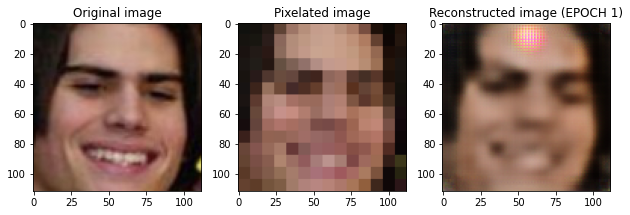

EPOCH 2/30


Train batch loss: 0.025503: 100%|██████████| 1191/1191 [02:11<00:00,  9.08it/s]




	 VALIDATION - EPOCH 2/30 - loss: 0.019063




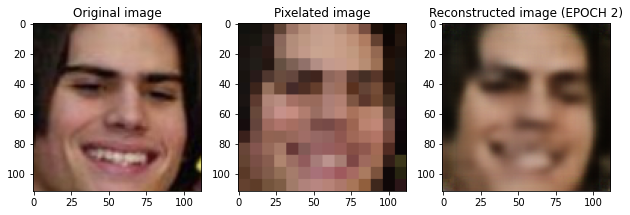

EPOCH 3/30


Train batch loss: 0.021524: 100%|██████████| 1191/1191 [02:12<00:00,  8.99it/s]




	 VALIDATION - EPOCH 3/30 - loss: 0.016083




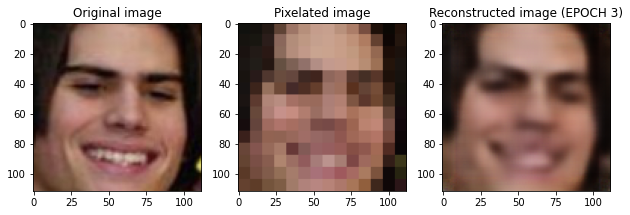

EPOCH 4/30


Train batch loss: 0.019706: 100%|██████████| 1191/1191 [02:13<00:00,  8.90it/s]




	 VALIDATION - EPOCH 4/30 - loss: 0.014165




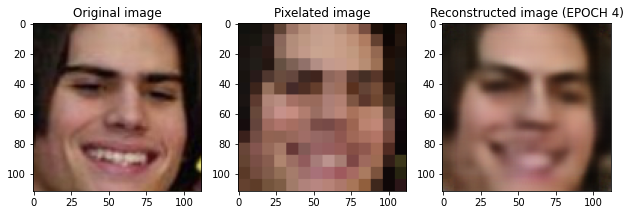

EPOCH 5/30


Train batch loss: 0.013793: 100%|██████████| 1191/1191 [02:15<00:00,  8.81it/s]




	 VALIDATION - EPOCH 5/30 - loss: 0.013499




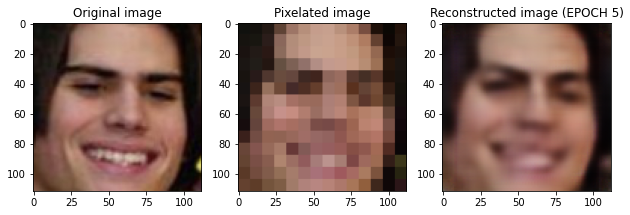

EPOCH 6/30


Train batch loss: 0.018594: 100%|██████████| 1191/1191 [02:17<00:00,  8.67it/s]




	 VALIDATION - EPOCH 6/30 - loss: 0.014076




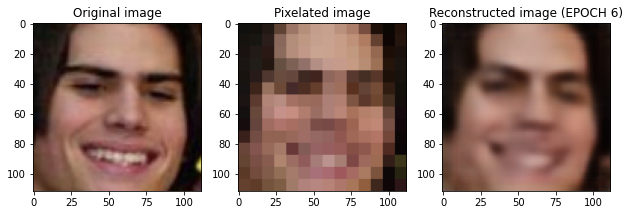

EPOCH 7/30


Train batch loss: 0.034816: 100%|██████████| 1191/1191 [02:17<00:00,  8.65it/s]




	 VALIDATION - EPOCH 7/30 - loss: 0.013079




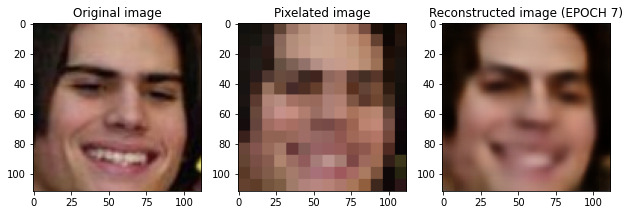

EPOCH 8/30


Train batch loss: 0.027406: 100%|██████████| 1191/1191 [02:18<00:00,  8.58it/s]




	 VALIDATION - EPOCH 8/30 - loss: 0.013166




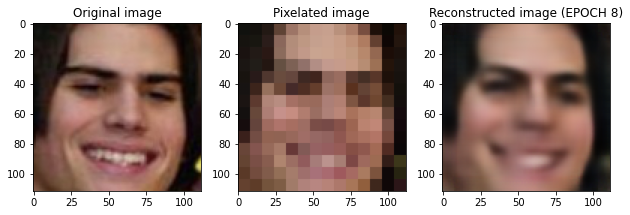

EPOCH 9/30


Train batch loss: 0.019944: 100%|██████████| 1191/1191 [02:20<00:00,  8.49it/s]




	 VALIDATION - EPOCH 9/30 - loss: 0.013445




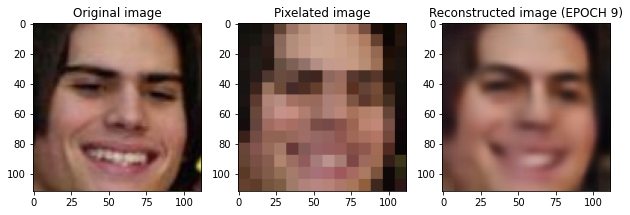

EPOCH 10/30


Train batch loss: 0.011757: 100%|██████████| 1191/1191 [02:21<00:00,  8.41it/s]




	 VALIDATION - EPOCH 10/30 - loss: 0.012973




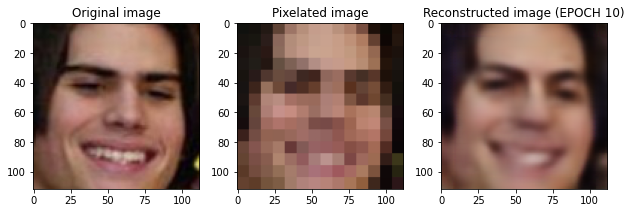

EPOCH 11/30


Train batch loss: 0.014087: 100%|██████████| 1191/1191 [02:22<00:00,  8.35it/s]




	 VALIDATION - EPOCH 11/30 - loss: 0.012433




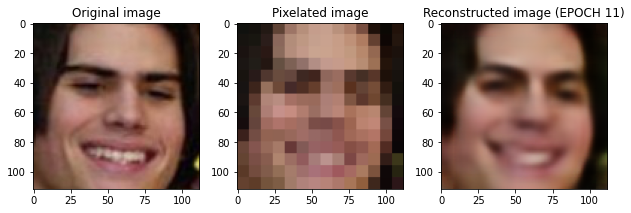

EPOCH 12/30


Train batch loss: 0.017962: 100%|██████████| 1191/1191 [02:24<00:00,  8.27it/s]




	 VALIDATION - EPOCH 12/30 - loss: 0.012365




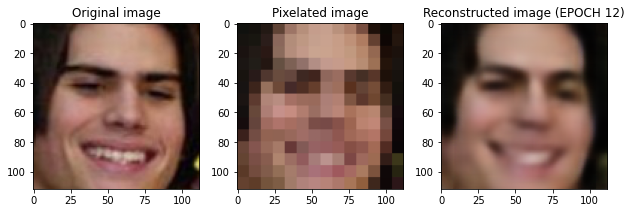

EPOCH 13/30


Train batch loss: 0.013855: 100%|██████████| 1191/1191 [02:25<00:00,  8.18it/s]




	 VALIDATION - EPOCH 13/30 - loss: 0.012697




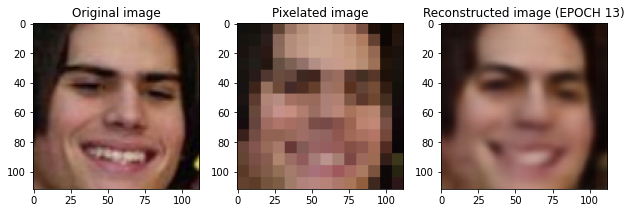

EPOCH 14/30


Train batch loss: 0.013748: 100%|██████████| 1191/1191 [02:28<00:00,  8.03it/s]




	 VALIDATION - EPOCH 14/30 - loss: 0.011896




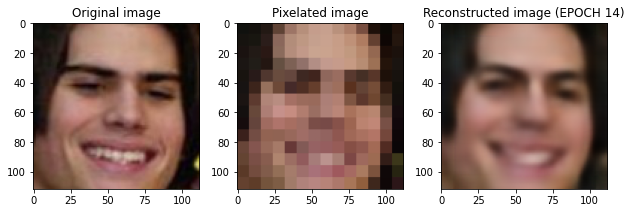

EPOCH 15/30


Train batch loss: 0.014763: 100%|██████████| 1191/1191 [02:29<00:00,  7.98it/s]




	 VALIDATION - EPOCH 15/30 - loss: 0.012391




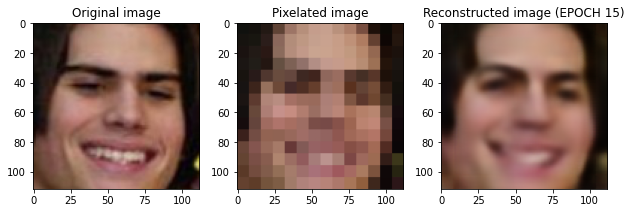

EPOCH 16/30


Train batch loss: 0.015213: 100%|██████████| 1191/1191 [02:29<00:00,  7.98it/s]




	 VALIDATION - EPOCH 16/30 - loss: 0.011818




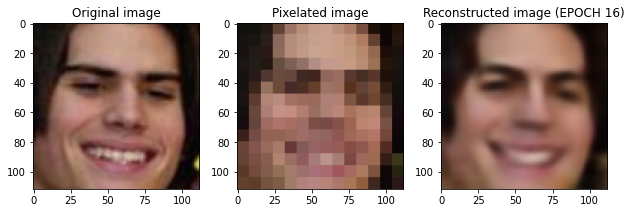

EPOCH 17/30


Train batch loss: 0.018155: 100%|██████████| 1191/1191 [02:31<00:00,  7.85it/s]




	 VALIDATION - EPOCH 17/30 - loss: 0.011127




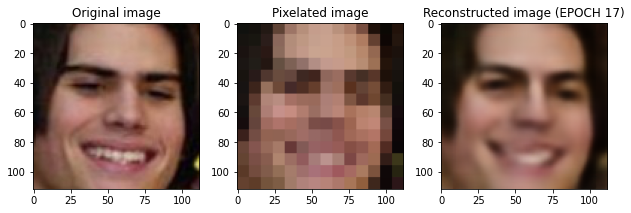

EPOCH 18/30


Train batch loss: 0.019253: 100%|██████████| 1191/1191 [02:33<00:00,  7.77it/s]




	 VALIDATION - EPOCH 18/30 - loss: 0.011428




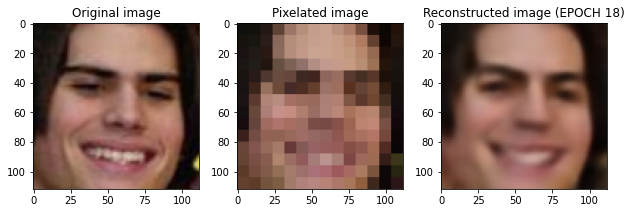

EPOCH 19/30


Train batch loss: 0.012448: 100%|██████████| 1191/1191 [02:34<00:00,  7.73it/s]




	 VALIDATION - EPOCH 19/30 - loss: 0.011291




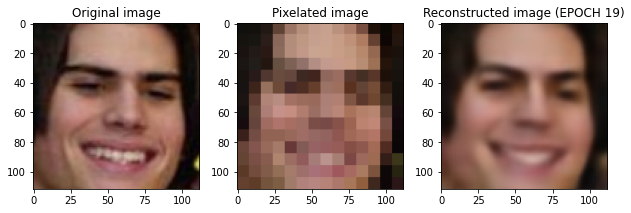

EPOCH 20/30


Train batch loss: 0.011434: 100%|██████████| 1191/1191 [02:35<00:00,  7.64it/s]




	 VALIDATION - EPOCH 20/30 - loss: 0.011069




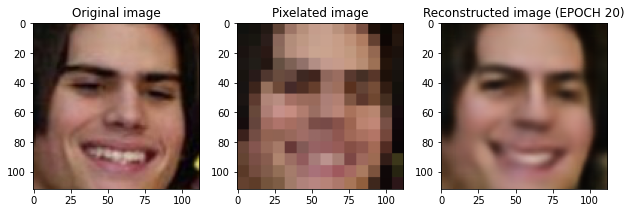

EPOCH 21/30


Train batch loss: 0.011432: 100%|██████████| 1191/1191 [02:35<00:00,  7.65it/s]




	 VALIDATION - EPOCH 21/30 - loss: 0.011534




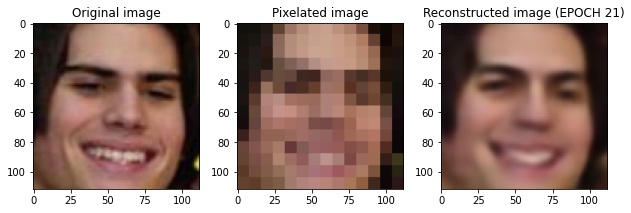

EPOCH 22/30


Train batch loss: 0.012134: 100%|██████████| 1191/1191 [02:37<00:00,  7.56it/s]




	 VALIDATION - EPOCH 22/30 - loss: 0.010939




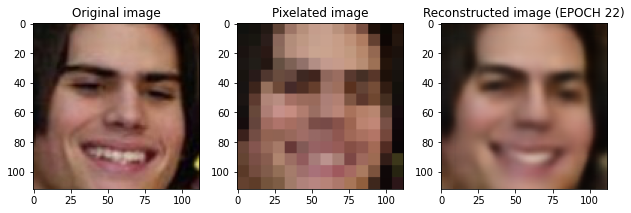

EPOCH 23/30


Train batch loss: 0.010859: 100%|██████████| 1191/1191 [02:38<00:00,  7.52it/s]




	 VALIDATION - EPOCH 23/30 - loss: 0.011518




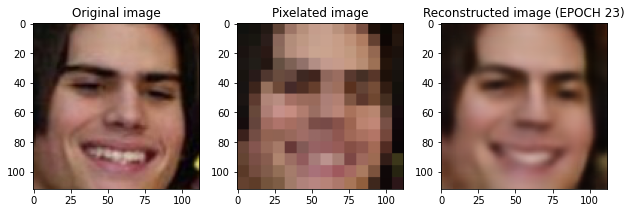

EPOCH 24/30


Train batch loss: 0.011569: 100%|██████████| 1191/1191 [02:39<00:00,  7.46it/s]




	 VALIDATION - EPOCH 24/30 - loss: 0.011345




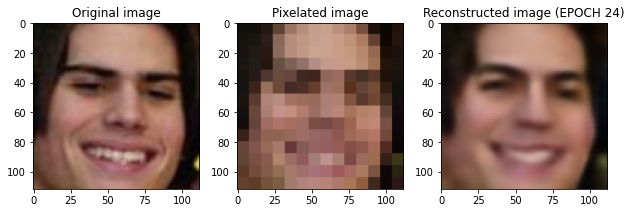

EPOCH 25/30


Train batch loss: 0.013662: 100%|██████████| 1191/1191 [02:40<00:00,  7.44it/s]




	 VALIDATION - EPOCH 25/30 - loss: 0.010917




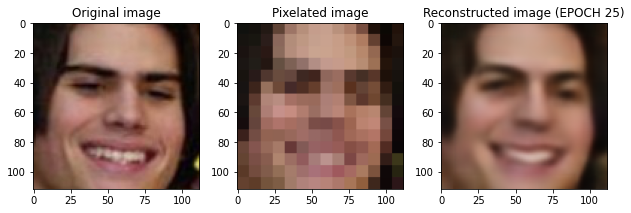

EPOCH 26/30


Train batch loss: 0.014650: 100%|██████████| 1191/1191 [02:40<00:00,  7.40it/s]




	 VALIDATION - EPOCH 26/30 - loss: 0.011036




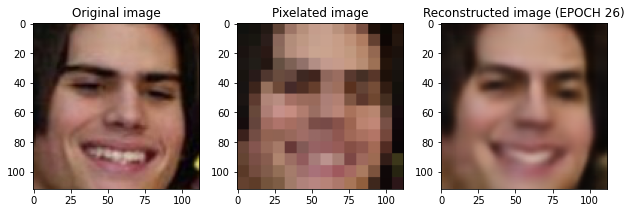

EPOCH 27/30


Train batch loss: 0.016138: 100%|██████████| 1191/1191 [02:41<00:00,  7.37it/s]




	 VALIDATION - EPOCH 27/30 - loss: 0.011049




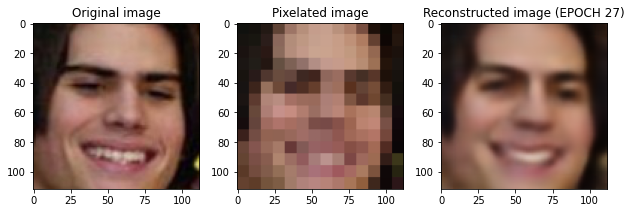

EPOCH 28/30


Train batch loss: 0.015481: 100%|██████████| 1191/1191 [02:42<00:00,  7.32it/s]




	 VALIDATION - EPOCH 28/30 - loss: 0.010668




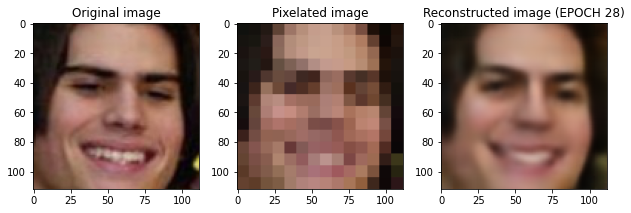

EPOCH 29/30


Train batch loss: 0.027076: 100%|██████████| 1191/1191 [02:46<00:00,  7.17it/s]




	 VALIDATION - EPOCH 29/30 - loss: 0.011759




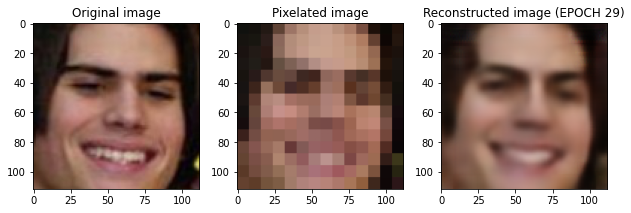

EPOCH 30/30


Train batch loss: 0.012058: 100%|██████████| 1191/1191 [02:45<00:00,  7.18it/s]




	 VALIDATION - EPOCH 30/30 - loss: 0.011276




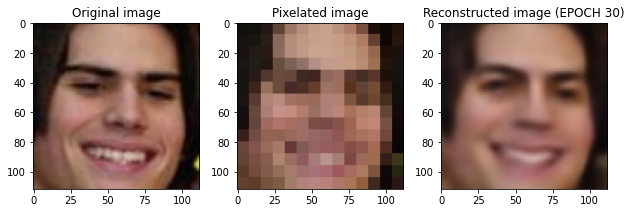

In [ ]:
CAE_loss = run_training(ConvAut, 30, train_dataloader, test_dataloader, optim, loss_fn, device, 'CAE_pixelated')

In [ ]:
!zip -r CAE_pixelated.zip CAE_pixelated

  adding: CAE_pixelated/ (stored 0%)
  adding: CAE_pixelated/state_dict29.pth (deflated 11%)
  adding: CAE_pixelated/state_dict13.pth (deflated 7%)
  adding: CAE_pixelated/state_dict15.pth (deflated 7%)
  adding: CAE_pixelated/state_dict2.pth (deflated 7%)
  adding: CAE_pixelated/state_dict1.pth (deflated 7%)
  adding: CAE_pixelated/state_dict12.pth (deflated 6%)
  adding: CAE_pixelated/state_dict4.pth (deflated 7%)
  adding: CAE_pixelated/state_dict3.pth (deflated 7%)
  adding: CAE_pixelated/state_dict28.pth (deflated 11%)
  adding: CAE_pixelated/state_dict7.pth (deflated 6%)
  adding: CAE_pixelated/state_dict16.pth (deflated 8%)
  adding: CAE_pixelated/state_dict27.pth (deflated 11%)
  adding: CAE_pixelated/state_dict25.pth (deflated 10%)
  adding: CAE_pixelated/state_dict6.pth (deflated 6%)
  adding: CAE_pixelated/state_dict9.pth (deflated 5%)
  adding: CAE_pixelated/state_dict24.pth (deflated 10%)
  adding: CAE_pixelated/state_dict5.pth (deflated 7%)
  adding: CAE_pixelated/state_d

## pixelated + perc loss

In [ ]:
!mkdir CAE_pl_pixelated

In [ ]:
vgg = torchvision.models.vgg16(pretrained = True) # c'è anche vgg16_bn con la batch normaliz 
vgg.eval()

up = nn.Upsample(scale_factor = 2)
f = vgg.features[:16].to(device)

def perc_loss(x1, x2): # le 2 immagini o i 2 batch (non cambia, fa la mse di due tensori, indipendentemente da 1 o batch_size come prima dim.)
    # inoltre anche Upsample si aspetta che le prime due dim. siano numero e canale, tocca solo le ultime 2 (cfr docs)
    return F.mse_loss(f(up(x1)), f(up(x2))) # versioni hd -> vgg16 -> mse

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

In [ ]:
class MixPercLoss(nn.MSELoss):
    __constants__ = ['reduction']

    def __init__(self, rho, scale_factor, device, size_average = None, reduce = None, reduction: str = 'mean') -> None:
        super(MixPercLoss, self).__init__(size_average, reduce, reduction)
        
        self.up = nn.Upsample(scale_factor = scale_factor)
        self.device = device
        self.rho = rho

        self.vgg = torchvision.models.vgg16(pretrained = True)
        self.vgg.eval()
        self.f = self.vgg.features[:16].to(self.device)

    def forward(self, input: torch.Tensor, target: torch.Tensor) -> torch.Tensor:
        perceptual_loss = F.mse_loss(self.f(self.up(input)), self.f(self.up(target)), reduction = self.reduction)
        pixel_loss = F.mse_loss(input, target, reduction = self.reduction)
        return self.rho * pixel_loss + perceptual_loss

In [ ]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
ConvAut_pl_pixelated = ConvAutoencoder()

### Define the loss function
loss_fn = MixPercLoss(rho = 1, scale_factor = 2, device = device) # perc_loss # torch.nn.MSELoss()

### Define an optimizer 
params_to_optimize = [
    {'params': ConvAut_pl_pixelated.encoder.parameters()},
    {'params': ConvAut_pl_pixelated.decoder.parameters()}
]
optim = torch.optim.Adam(params_to_optimize, lr=5e-4, weight_decay=1e-5)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


  0%|          | 0.00/528M [00:00<?, ?B/s]

EPOCH 1/5


Train batch loss: 2.027926: 100%|██████████| 1191/1191 [05:27<00:00,  3.63it/s]




	 VALIDATION - EPOCH 1/5 - loss: 2.102830




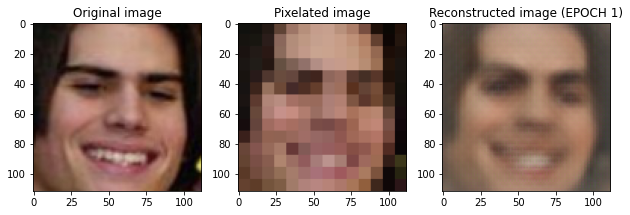

EPOCH 2/5


Train batch loss: 1.651419: 100%|██████████| 1191/1191 [05:28<00:00,  3.63it/s]




	 VALIDATION - EPOCH 2/5 - loss: 1.907311




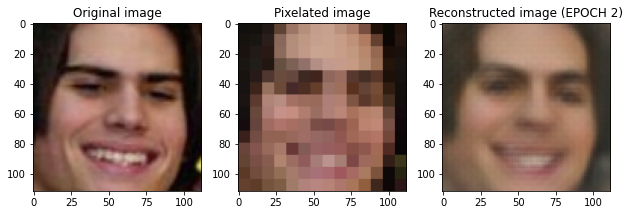

EPOCH 3/5


Train batch loss: 1.993506: 100%|██████████| 1191/1191 [05:30<00:00,  3.61it/s]




	 VALIDATION - EPOCH 3/5 - loss: 1.920507




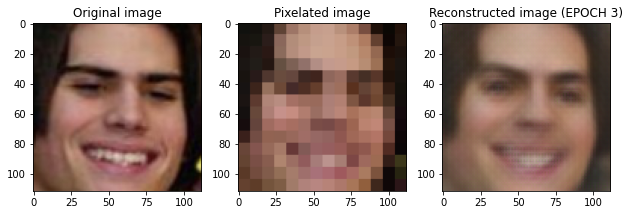

EPOCH 4/5


Train batch loss: 1.591242: 100%|██████████| 1191/1191 [05:30<00:00,  3.60it/s]




	 VALIDATION - EPOCH 4/5 - loss: 1.839841




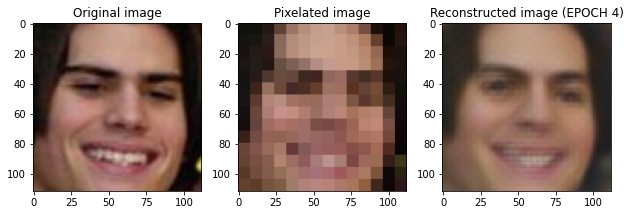

EPOCH 5/5


Train batch loss: 1.714593: 100%|██████████| 1191/1191 [05:32<00:00,  3.58it/s]




	 VALIDATION - EPOCH 5/5 - loss: 1.783698




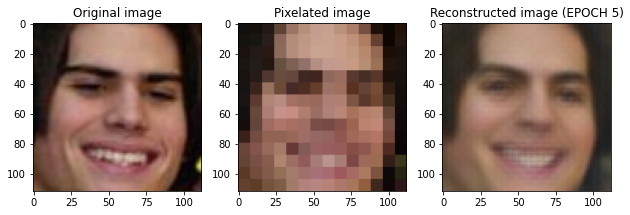

In [ ]:
CAE_pl_pixelated_loss = run_training(ConvAut_pl_pixelated, 5, train_dataloader, test_dataloader, optim, loss_fn, device, 'CAE_pl_pixelated')

## vconv 1*1

In [ ]:
!pip install torchmetrics

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 419 kB 28.4 MB/s 


In [ ]:
import torch
import torchvision
from torch import nn
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from tqdm import trange, tqdm
from torch.utils.data import Dataset, DataLoader, random_split
import os
from PIL import Image
from torchvision import transforms
import pickle
# from torchmetrics import PSNR, SSIM
from torchmetrics import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure
import torch.nn.functional as F
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import seaborn as sns

In [ ]:
# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

Selected device: cuda


In [ ]:
class AutoEncodeDataset(Dataset):
    """"""

    def __init__(self, dataset_gt, dataset_blur):
        self.dataset_gt = dataset_gt
        self.dataset_blur = dataset_blur

    def __len__(self):
        return len(self.dataset_gt)

    def __getitem__(self, idx):
        x, _ = self.dataset_blur.__getitem__(idx)
        y, _ = self.dataset_gt.__getitem__(idx)
        return x, y

In [ ]:
initial_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.CenterCrop(112),
    transforms.Normalize(0.5,0.5)])

blur_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.CenterCrop(112),
    transforms.GaussianBlur(9,4),
    transforms.Normalize(0.5,0.5)])

In [ ]:
data_dir = 'data_lfw/'

train_dataset = AutoEncodeDataset(
    torchvision.datasets.LFWPeople(data_dir, split='train', download=True, transform=initial_transform),
    torchvision.datasets.LFWPeople(data_dir, split='train', download=True, transform=blur_transform)
)

test_dataset = AutoEncodeDataset(
    torchvision.datasets.LFWPeople(data_dir, split='test', download=True, transform=initial_transform),
    torchvision.datasets.LFWPeople(data_dir, split='test', download=True, transform=blur_transform)
)

  0%|          | 0/243346528 [00:00<?, ?it/s]

Extracting data_lfw/lfw-py/lfw-funneled.tgz to data_lfw/lfw-py


  0%|          | 0/66403 [00:00<?, ?it/s]

  0%|          | 0/94727 [00:00<?, ?it/s]

Files already downloaded and verified
Using downloaded and verified file: data_lfw/lfw-py/lfw-funneled.tgz
Extracting data_lfw/lfw-py/lfw-funneled.tgz to data_lfw/lfw-py


  0%|          | 0/28334 [00:00<?, ?it/s]

Using downloaded and verified file: data_lfw/lfw-py/lfw-names.txt
Files already downloaded and verified


In [ ]:
batch_size = 8

N_val = int(len(train_dataset)*0.2)
train_dataset_red, val_dataset = random_split(train_dataset, 
                                 lengths=[len(train_dataset)-N_val, N_val], 
                                 generator=torch.Generator().manual_seed(42))
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0,)
train_dataloader_red = DataLoader(train_dataset_red, batch_size=batch_size, shuffle=True, num_workers=0)
val_dataloader   = DataLoader(val_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
test_dataloader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=True, num_workers=0)

In [ ]:
def plotrescale(data):
    return np.dstack(data)*0.5 + 0.5

In [ ]:
class VConvAutoencoder(nn.Module):
    
    def __init__(self):
        super().__init__()
        
        ## Encoder
        # N, 3, 112, 112
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, 9), # N, 16, 104, 104
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 64, 4, stride=2, padding=1), # N, 32, 51, 52
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Conv2d(64, 128, 4, stride=2, padding=1), # N, 32, 26
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.Conv2d(128, 256, 4, stride=2), # N, 32, 12
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )
        
        ## Decoder
        # N, 64, 1, 1
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(256, 256, 12), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.ConvTranspose2d(256, 256, 4, stride=2), # N, 32, 10, 10
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1), # N, 16, 28, 28
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1), # N, 16, 56, 56
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, 9),
            nn.Tanh()  
        )

        self.avg = nn.Sequential(
            nn.Conv2d(256, 256, 12), # originale: nn.ConvTranspose2d(256, 256, 1)
            nn.BatchNorm2d(256), #nn.BatchNorm1d(256) # originale: nn.BatchNorm2d(256),
            #nn.ReLU(),
        )

        self.log_var = nn.Sequential(
            nn.Conv2d(256, 256, 12), # originale: nn.ConvTranspose2d(256, 256, 1)
            nn.BatchNorm2d(256), #nn.BatchNorm1d(256) # originale: nn.BatchNorm2d(256),
            #nn.ReLU(),
        )
        
    def sample_in_latent_space(self, mu, log_var): # sampling from MVN in latent space with provided mean and variances
        sigma = torch.exp(0.5 * log_var) #log_var is log(variance) = log(sigma**2) = 2 * log(sigma)
        return mu + torch.randn_like(mu) * sigma
        #Var(aX) = a**2 Var(X), so we need to multiply pred_sqrt_var = sigma (square root of the variance) by the standard normal distribution

    def forward(self, x):
        x = self.encoder(x)
        avg = self.avg(x)
        log_var = self.log_var(x)
        x = self.sample_in_latent_space(avg, log_var)
        x = self.decoder(x)
        return x#, avg, log_var

In [ ]:
### Training cycle function
def train_epoch(model, device, dataloader, loss_fn, optimizer):
    model.train()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    foo = tqdm(dataloader)
    for image_batch, label_batch in foo: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        label_batch = label_batch.to(device)
        # Encode-Decode data
        decoded_data = model(image_batch)
        ##
        #latent_img = model.encoder(image_batch)
        #latent_lab = model.encoder(label_batch)
        # Evaluate loss
        loss = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        foo.set_description('Train batch loss: %f' % (loss.data))

### Testing cycle function
def test_epoch(model, device, dataloader, loss_fn):
    model.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        val_loss = []
        for image_batch, label_batch in dataloader:
            # Move tensor to the proper device
            image_batch = image_batch.to(device)
            label_batch = label_batch.to(device)
            # Encode-Decode data
            decoded_data = model(image_batch)
            ##
            #latent_img = model.encoder(image_batch)
            #latent_lab = model.encoder(label_batch)
            # Batch loss
            loss_batch = loss_fn(decoded_data, label_batch) #+ loss_fn(latent_img, latent_lab)
            # Append the loss
            val_loss.append(loss_batch.detach().cpu().numpy())
    return np.mean(val_loss)

### Trainer
def run_training(model, num_epochs, train_dataloader, val_dataloader, optim, loss_fn, device, save_folder):
    model.to(device)
    val_loss_log = []
    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))
        ### Training
        train_epoch(
            model=model,
            device=device, 
            dataloader=train_dataloader, 
            loss_fn=loss_fn, 
            optimizer=optim)
        ### Validation  (use the testing function)
        val_loss = test_epoch(
            model=model,
            device=device, 
            dataloader=val_dataloader, 
            loss_fn=loss_fn)
        # Print Validationloss
        print('\n\n\t VALIDATION - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs, val_loss))
        val_loss_log.append(val_loss)
        ### Plot progress
        # Get the output of a specific image (the test image at index 0 in this case)
        img = test_dataset[0][0].unsqueeze(0).to(device)
        lab = test_dataset[0][1].unsqueeze(0).to(device)
        model.eval()
        with torch.no_grad():
            rec_img  = model(img)
        # Plot the reconstructed image
        fig, axs = plt.subplots(1, 3, figsize=(9,3))
        axs[0].imshow(plotrescale(lab.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[0].set_title('Original image')
        axs[1].imshow(plotrescale(img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[1].set_title('Pixelated image')
        axs[2].imshow(plotrescale(rec_img.cpu().squeeze().numpy()), cmap='gist_gray')
        axs[2].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
        plt.tight_layout()
        plt.pause(0.1)
        plt.show()
        plt.close()

        # Save network parameters
        torch.save(model.state_dict(), f'{save_folder}/state_dict'+str(epoch)+'.pth')

    with open(f'{save_folder}_validation_loss', 'wb') as fp:
        pickle.dump(val_loss_log, fp)

    return  val_loss_log

In [ ]:
### Set the random seed for reproducible results
torch.manual_seed(0)

### Initialize the two networks
VConvAut_11 = VConvAutoencoder()

### Define the loss function
loss_fn = torch.nn.MSELoss()

### Define an optimizer 
params_to_optimize = [
    {'params': VConvAut_11.encoder.parameters()},
    {'params': VConvAut_11.decoder.parameters()},
    {'params': VConvAut_11.avg.parameters()},
    {'params': VConvAut_11.log_var.parameters()}
]
optim = torch.optim.Adam(params_to_optimize, lr=5e-4, weight_decay=1e-5)

In [ ]:
!mkdir VCAE_11

In [ ]:
# t = test_dataset[0][0].unsqueeze(0)#.to(device)
# #VConvAut_11.to(device)
# VConvAut_11.decoder((VConvAut_11.avg(VConvAut_11.encoder(t)))).shape

EPOCH 1/15


Train batch loss: 0.130429: 100%|██████████| 1191/1191 [02:22<00:00,  8.34it/s]




	 VALIDATION - EPOCH 1/15 - loss: 0.054457




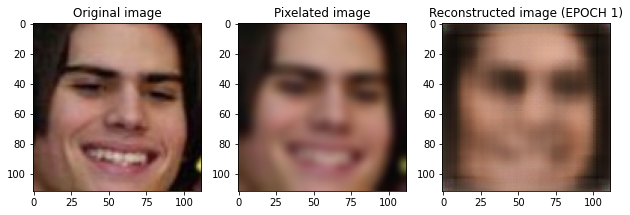

EPOCH 2/15


Train batch loss: 0.070195: 100%|██████████| 1191/1191 [02:15<00:00,  8.76it/s]




	 VALIDATION - EPOCH 2/15 - loss: 0.057518




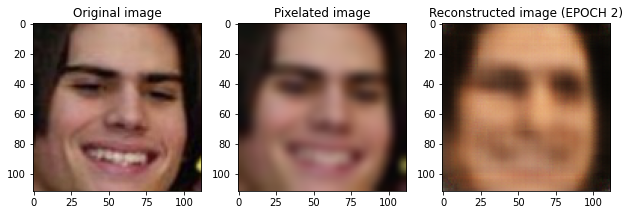

EPOCH 3/15


Train batch loss: 0.050969: 100%|██████████| 1191/1191 [02:21<00:00,  8.41it/s]




	 VALIDATION - EPOCH 3/15 - loss: 0.038692




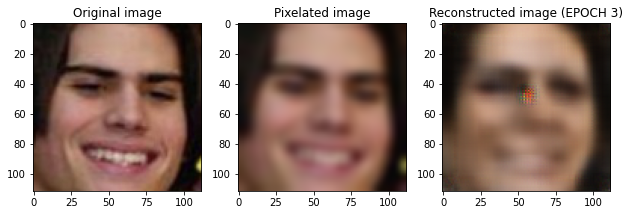

EPOCH 4/15


Train batch loss: 0.045829: 100%|██████████| 1191/1191 [02:20<00:00,  8.49it/s]




	 VALIDATION - EPOCH 4/15 - loss: 0.034224




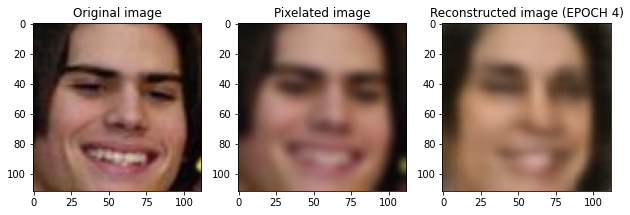

EPOCH 5/15


Train batch loss: 0.041789: 100%|██████████| 1191/1191 [02:16<00:00,  8.71it/s]




	 VALIDATION - EPOCH 5/15 - loss: 0.031940




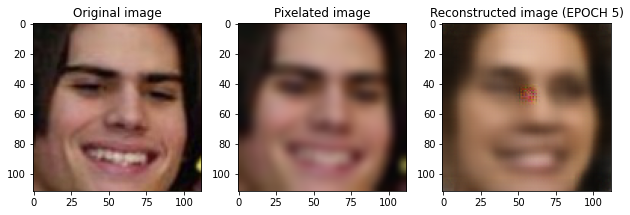

EPOCH 6/15


Train batch loss: 0.045916: 100%|██████████| 1191/1191 [02:22<00:00,  8.34it/s]




	 VALIDATION - EPOCH 6/15 - loss: 0.030931




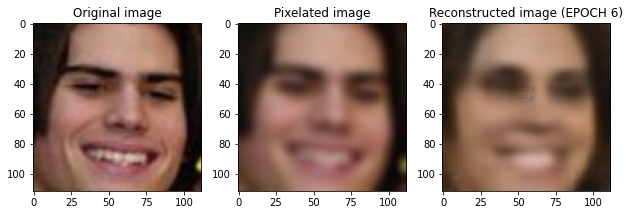

EPOCH 7/15


Train batch loss: 0.037954: 100%|██████████| 1191/1191 [02:24<00:00,  8.27it/s]




	 VALIDATION - EPOCH 7/15 - loss: 0.030002




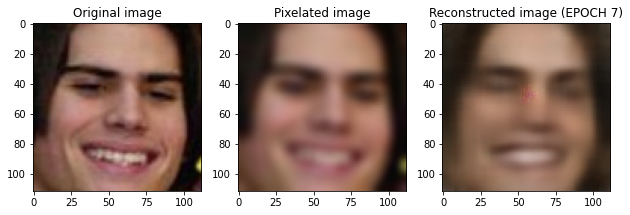

EPOCH 8/15


Train batch loss: 0.047547: 100%|██████████| 1191/1191 [02:26<00:00,  8.15it/s]




	 VALIDATION - EPOCH 8/15 - loss: 0.028584




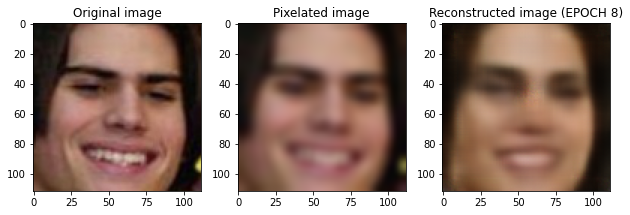

EPOCH 9/15


Train batch loss: 0.043790: 100%|██████████| 1191/1191 [02:26<00:00,  8.15it/s]




	 VALIDATION - EPOCH 9/15 - loss: 0.026425




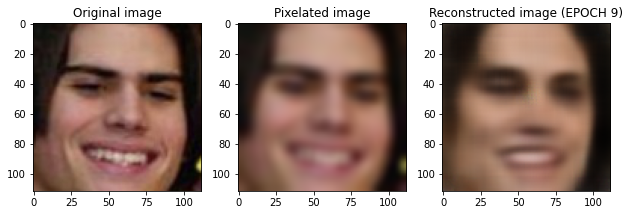

EPOCH 10/15


Train batch loss: 0.033961: 100%|██████████| 1191/1191 [02:26<00:00,  8.12it/s]




	 VALIDATION - EPOCH 10/15 - loss: 0.026906




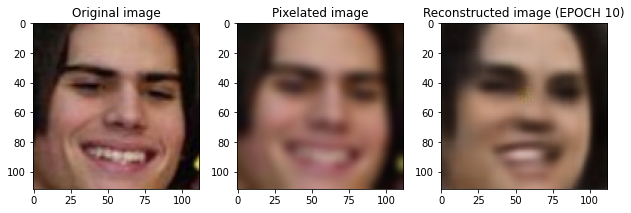

EPOCH 11/15


Train batch loss: 0.049291: 100%|██████████| 1191/1191 [02:27<00:00,  8.07it/s]




	 VALIDATION - EPOCH 11/15 - loss: 0.025385




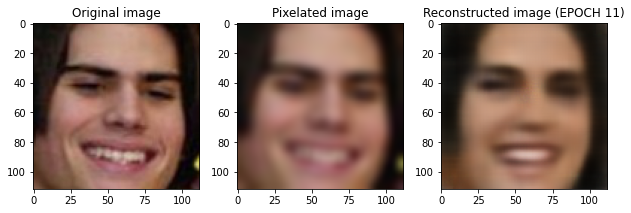

EPOCH 12/15


Train batch loss: 0.040913: 100%|██████████| 1191/1191 [02:28<00:00,  8.02it/s]




	 VALIDATION - EPOCH 12/15 - loss: 0.026109




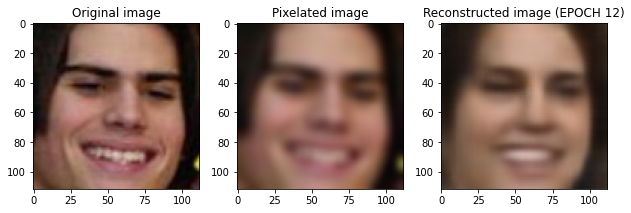

EPOCH 13/15


Train batch loss: 0.034832: 100%|██████████| 1191/1191 [02:29<00:00,  7.96it/s]




	 VALIDATION - EPOCH 13/15 - loss: 0.025753




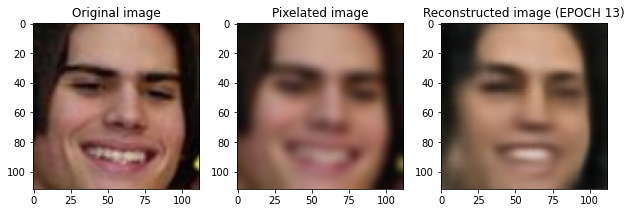

EPOCH 14/15


Train batch loss: 0.035207: 100%|██████████| 1191/1191 [02:31<00:00,  7.85it/s]




	 VALIDATION - EPOCH 14/15 - loss: 0.024179




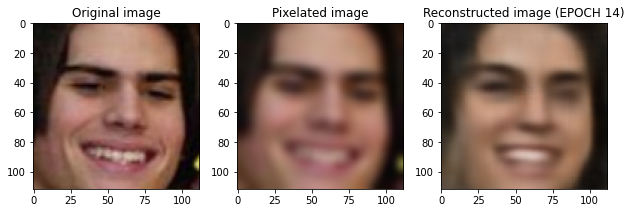

EPOCH 15/15


Train batch loss: 0.040515: 100%|██████████| 1191/1191 [02:32<00:00,  7.82it/s]




	 VALIDATION - EPOCH 15/15 - loss: 0.024293




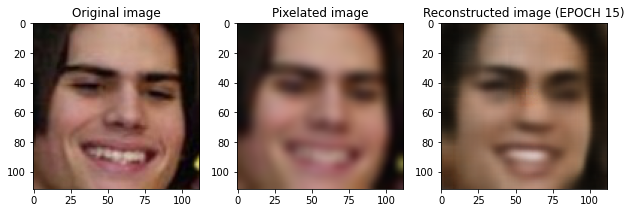

In [ ]:
VCAE_11_loss = run_training(VConvAut_11, 15, train_dataloader, test_dataloader, optim, loss_fn, device, 'VCAE_11')

In [ ]:
!zip -r VCAE_11.zip VCAE_11

  adding: VCAE_11/ (stored 0%)
  adding: VCAE_11/state_dict8.pth (deflated 4%)
  adding: VCAE_11/state_dict0.pth (deflated 7%)
  adding: VCAE_11/state_dict6.pth (deflated 4%)
  adding: VCAE_11/state_dict12.pth (deflated 8%)
  adding: VCAE_11/state_dict9.pth (deflated 6%)
  adding: VCAE_11/state_dict14.pth (deflated 9%)
  adding: VCAE_11/state_dict1.pth (deflated 7%)
  adding: VCAE_11/state_dict11.pth (deflated 8%)
  adding: VCAE_11/state_dict7.pth (deflated 4%)
  adding: VCAE_11/state_dict2.pth (deflated 7%)
  adding: VCAE_11/state_dict13.pth (deflated 9%)
  adding: VCAE_11/state_dict5.pth (deflated 5%)
  adding: VCAE_11/state_dict10.pth (deflated 7%)
  adding: VCAE_11/state_dict4.pth (deflated 6%)
  adding: VCAE_11/state_dict3.pth (deflated 7%)
